# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: das Verzeichnis »data“ kann nicht angelegt werden: Die Datei existiert bereits


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

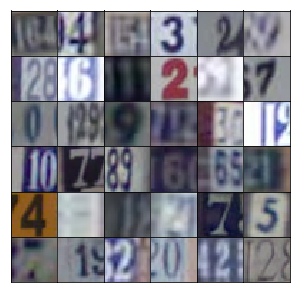

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        # Reshape to start conv nets
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        # 4 * 4 * 512
        
        
        # create the convolution steps
        x2 = tf.layers.conv2d_transpose(x, 256,  5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8 * 8 * 256 now

        # create the convolution steps
        x3 = tf.layers.conv2d_transpose(x2, 256,  5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16 * 16 * 128 now
                
        # Output layer, 32x32x3
        logits =  tf.layers.conv2d_transpose(x3, output_dim, 5 , strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002 # 0.0002
batch_size = 128       # 128
epochs = 25            # 25
alpha = 0.2          # 0.2
beta1 = 0.5           # 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0824... Generator Loss: 0.8035
Epoch 1/25... Discriminator Loss: 0.2385... Generator Loss: 3.1377
Epoch 1/25... Discriminator Loss: 0.1200... Generator Loss: 2.8440
Epoch 1/25... Discriminator Loss: 0.1387... Generator Loss: 2.6735
Epoch 1/25... Discriminator Loss: 0.2132... Generator Loss: 2.2842
Epoch 1/25... Discriminator Loss: 0.1167... Generator Loss: 2.8365
Epoch 1/25... Discriminator Loss: 0.1020... Generator Loss: 3.1137
Epoch 1/25... Discriminator Loss: 0.4196... Generator Loss: 5.0193
Epoch 1/25... Discriminator Loss: 0.1061... Generator Loss: 3.4121
Epoch 1/25... Discriminator Loss: 0.3193... Generator Loss: 3.5326


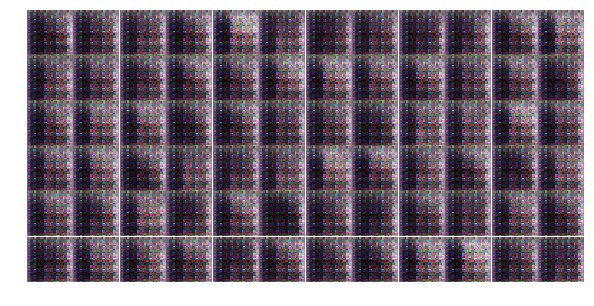

Epoch 1/25... Discriminator Loss: 0.1986... Generator Loss: 3.4965
Epoch 1/25... Discriminator Loss: 1.2494... Generator Loss: 1.6730
Epoch 1/25... Discriminator Loss: 0.7819... Generator Loss: 1.1825
Epoch 1/25... Discriminator Loss: 0.4907... Generator Loss: 1.6793
Epoch 1/25... Discriminator Loss: 0.6026... Generator Loss: 1.2965
Epoch 1/25... Discriminator Loss: 0.2606... Generator Loss: 2.5613
Epoch 1/25... Discriminator Loss: 0.2253... Generator Loss: 2.1096
Epoch 1/25... Discriminator Loss: 0.1373... Generator Loss: 3.3738
Epoch 1/25... Discriminator Loss: 0.2711... Generator Loss: 2.3452
Epoch 1/25... Discriminator Loss: 0.1676... Generator Loss: 5.1723


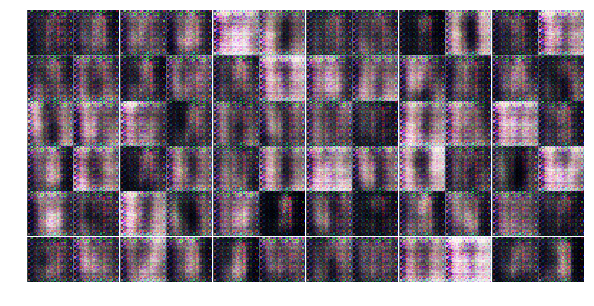

Epoch 1/25... Discriminator Loss: 0.0757... Generator Loss: 3.9668
Epoch 1/25... Discriminator Loss: 0.7191... Generator Loss: 1.1042
Epoch 1/25... Discriminator Loss: 0.1495... Generator Loss: 2.8177
Epoch 1/25... Discriminator Loss: 0.7501... Generator Loss: 8.0798
Epoch 1/25... Discriminator Loss: 0.3242... Generator Loss: 1.9779
Epoch 1/25... Discriminator Loss: 1.5332... Generator Loss: 0.8335
Epoch 1/25... Discriminator Loss: 0.2811... Generator Loss: 2.5135
Epoch 1/25... Discriminator Loss: 0.5707... Generator Loss: 2.8719
Epoch 1/25... Discriminator Loss: 1.0554... Generator Loss: 0.7434
Epoch 1/25... Discriminator Loss: 1.3176... Generator Loss: 0.6709


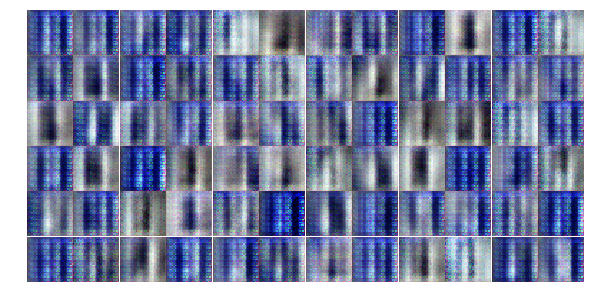

Epoch 1/25... Discriminator Loss: 0.5342... Generator Loss: 1.7034
Epoch 1/25... Discriminator Loss: 0.3535... Generator Loss: 2.1929
Epoch 1/25... Discriminator Loss: 0.2631... Generator Loss: 2.7417
Epoch 1/25... Discriminator Loss: 0.5200... Generator Loss: 1.6141
Epoch 1/25... Discriminator Loss: 0.6719... Generator Loss: 5.8798
Epoch 1/25... Discriminator Loss: 0.9661... Generator Loss: 3.9748
Epoch 1/25... Discriminator Loss: 0.5290... Generator Loss: 2.6406
Epoch 1/25... Discriminator Loss: 0.9829... Generator Loss: 1.2734
Epoch 1/25... Discriminator Loss: 0.2152... Generator Loss: 3.8471
Epoch 1/25... Discriminator Loss: 0.6831... Generator Loss: 3.7949


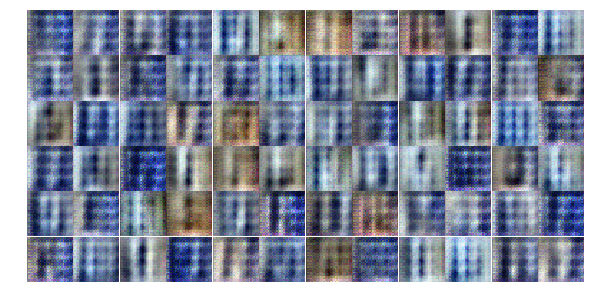

Epoch 1/25... Discriminator Loss: 1.0134... Generator Loss: 1.0455
Epoch 1/25... Discriminator Loss: 0.7038... Generator Loss: 1.5750
Epoch 1/25... Discriminator Loss: 0.6173... Generator Loss: 3.2807
Epoch 1/25... Discriminator Loss: 1.1172... Generator Loss: 0.5638
Epoch 1/25... Discriminator Loss: 0.9479... Generator Loss: 1.7066
Epoch 1/25... Discriminator Loss: 0.7015... Generator Loss: 2.1560
Epoch 1/25... Discriminator Loss: 0.4841... Generator Loss: 2.0680
Epoch 1/25... Discriminator Loss: 0.6920... Generator Loss: 1.4720
Epoch 1/25... Discriminator Loss: 0.6670... Generator Loss: 1.3359
Epoch 1/25... Discriminator Loss: 0.7233... Generator Loss: 1.3731


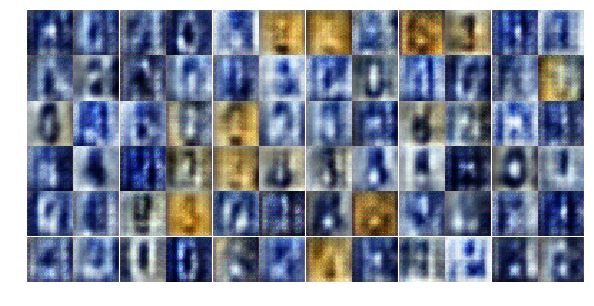

Epoch 1/25... Discriminator Loss: 3.2882... Generator Loss: 4.0828
Epoch 1/25... Discriminator Loss: 1.7617... Generator Loss: 0.3333
Epoch 1/25... Discriminator Loss: 0.8997... Generator Loss: 1.1685
Epoch 1/25... Discriminator Loss: 1.3853... Generator Loss: 0.6103
Epoch 1/25... Discriminator Loss: 0.6296... Generator Loss: 1.8623
Epoch 1/25... Discriminator Loss: 0.5692... Generator Loss: 1.7139
Epoch 1/25... Discriminator Loss: 0.6939... Generator Loss: 1.2368
Epoch 2/25... Discriminator Loss: 0.7060... Generator Loss: 1.6859
Epoch 2/25... Discriminator Loss: 0.6682... Generator Loss: 2.2310
Epoch 2/25... Discriminator Loss: 0.8971... Generator Loss: 1.1846


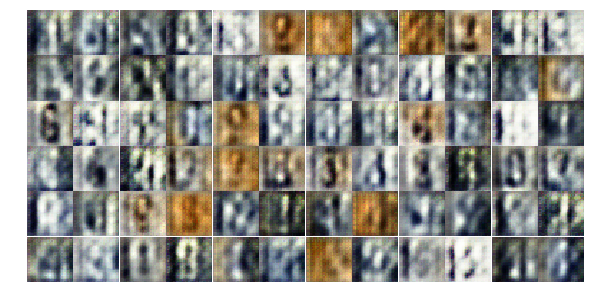

Epoch 2/25... Discriminator Loss: 0.7108... Generator Loss: 1.1656
Epoch 2/25... Discriminator Loss: 0.8958... Generator Loss: 0.9502
Epoch 2/25... Discriminator Loss: 0.7028... Generator Loss: 1.2458
Epoch 2/25... Discriminator Loss: 0.5169... Generator Loss: 2.6067
Epoch 2/25... Discriminator Loss: 0.4292... Generator Loss: 1.8605
Epoch 2/25... Discriminator Loss: 0.6470... Generator Loss: 2.1662
Epoch 2/25... Discriminator Loss: 0.7927... Generator Loss: 1.0316
Epoch 2/25... Discriminator Loss: 0.6418... Generator Loss: 1.2084
Epoch 2/25... Discriminator Loss: 1.3284... Generator Loss: 0.5312
Epoch 2/25... Discriminator Loss: 0.9888... Generator Loss: 1.2667


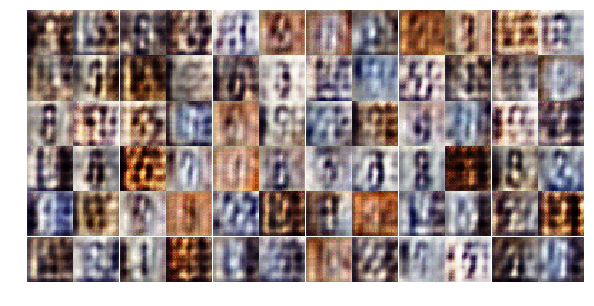

Epoch 2/25... Discriminator Loss: 0.8063... Generator Loss: 2.5167
Epoch 2/25... Discriminator Loss: 0.9478... Generator Loss: 1.4379
Epoch 2/25... Discriminator Loss: 0.4738... Generator Loss: 3.0528
Epoch 2/25... Discriminator Loss: 0.5086... Generator Loss: 1.7598
Epoch 2/25... Discriminator Loss: 0.6945... Generator Loss: 1.1916
Epoch 2/25... Discriminator Loss: 1.3988... Generator Loss: 0.4797
Epoch 2/25... Discriminator Loss: 1.1232... Generator Loss: 0.7414
Epoch 2/25... Discriminator Loss: 1.3562... Generator Loss: 0.5559
Epoch 2/25... Discriminator Loss: 0.8356... Generator Loss: 1.0757
Epoch 2/25... Discriminator Loss: 1.3359... Generator Loss: 0.6607


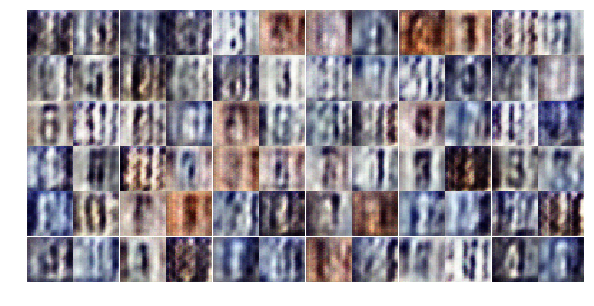

Epoch 2/25... Discriminator Loss: 1.0684... Generator Loss: 0.7682
Epoch 2/25... Discriminator Loss: 0.3651... Generator Loss: 2.6854
Epoch 2/25... Discriminator Loss: 0.5094... Generator Loss: 1.6787
Epoch 2/25... Discriminator Loss: 1.3326... Generator Loss: 0.4220
Epoch 2/25... Discriminator Loss: 0.4360... Generator Loss: 2.0354
Epoch 2/25... Discriminator Loss: 0.4758... Generator Loss: 2.6314
Epoch 2/25... Discriminator Loss: 1.3236... Generator Loss: 1.0697
Epoch 2/25... Discriminator Loss: 1.2466... Generator Loss: 0.8773
Epoch 2/25... Discriminator Loss: 1.0289... Generator Loss: 1.3162
Epoch 2/25... Discriminator Loss: 0.3878... Generator Loss: 2.0202


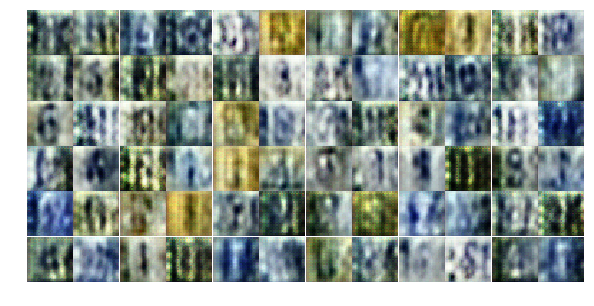

Epoch 2/25... Discriminator Loss: 1.5948... Generator Loss: 3.1189
Epoch 2/25... Discriminator Loss: 2.2879... Generator Loss: 0.1627
Epoch 2/25... Discriminator Loss: 0.6707... Generator Loss: 1.6576
Epoch 2/25... Discriminator Loss: 0.5096... Generator Loss: 1.5947
Epoch 2/25... Discriminator Loss: 0.5305... Generator Loss: 2.2991
Epoch 2/25... Discriminator Loss: 1.8341... Generator Loss: 0.2502
Epoch 2/25... Discriminator Loss: 0.5739... Generator Loss: 1.4559
Epoch 2/25... Discriminator Loss: 0.3201... Generator Loss: 3.0830
Epoch 2/25... Discriminator Loss: 1.2206... Generator Loss: 0.6698
Epoch 2/25... Discriminator Loss: 0.4557... Generator Loss: 3.5295


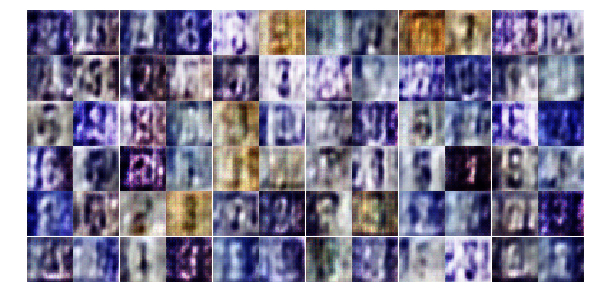

Epoch 2/25... Discriminator Loss: 0.5892... Generator Loss: 4.0928
Epoch 2/25... Discriminator Loss: 1.6263... Generator Loss: 0.5705
Epoch 2/25... Discriminator Loss: 1.3932... Generator Loss: 0.8227
Epoch 2/25... Discriminator Loss: 1.3696... Generator Loss: 0.8379
Epoch 2/25... Discriminator Loss: 1.4520... Generator Loss: 0.5544
Epoch 2/25... Discriminator Loss: 1.2260... Generator Loss: 0.8254
Epoch 2/25... Discriminator Loss: 0.9367... Generator Loss: 1.0169
Epoch 2/25... Discriminator Loss: 1.4247... Generator Loss: 0.5918
Epoch 2/25... Discriminator Loss: 1.1196... Generator Loss: 1.0228
Epoch 2/25... Discriminator Loss: 0.9601... Generator Loss: 1.3099


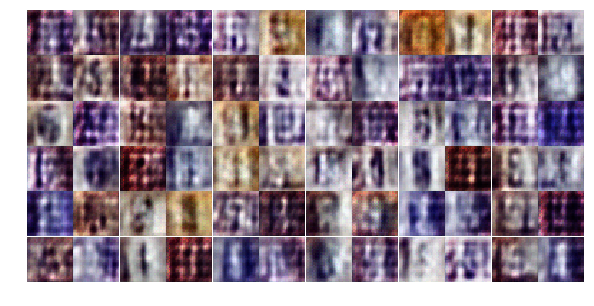

Epoch 2/25... Discriminator Loss: 1.0617... Generator Loss: 0.8105
Epoch 2/25... Discriminator Loss: 0.7808... Generator Loss: 1.0147
Epoch 2/25... Discriminator Loss: 0.9688... Generator Loss: 0.8452
Epoch 2/25... Discriminator Loss: 1.2219... Generator Loss: 0.5372
Epoch 3/25... Discriminator Loss: 0.9607... Generator Loss: 1.1750
Epoch 3/25... Discriminator Loss: 1.0470... Generator Loss: 0.7368
Epoch 3/25... Discriminator Loss: 0.9890... Generator Loss: 1.3863
Epoch 3/25... Discriminator Loss: 0.7718... Generator Loss: 0.9807
Epoch 3/25... Discriminator Loss: 0.9500... Generator Loss: 0.9076
Epoch 3/25... Discriminator Loss: 1.6381... Generator Loss: 0.5380


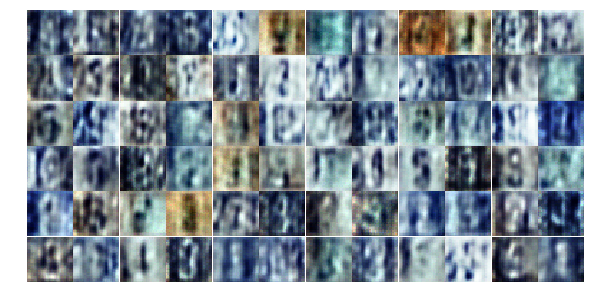

Epoch 3/25... Discriminator Loss: 0.4306... Generator Loss: 1.5454
Epoch 3/25... Discriminator Loss: 0.9123... Generator Loss: 0.6947
Epoch 3/25... Discriminator Loss: 1.0171... Generator Loss: 1.3228
Epoch 3/25... Discriminator Loss: 0.1993... Generator Loss: 2.1040
Epoch 3/25... Discriminator Loss: 1.3211... Generator Loss: 0.9760
Epoch 3/25... Discriminator Loss: 1.4300... Generator Loss: 0.8370
Epoch 3/25... Discriminator Loss: 0.5396... Generator Loss: 1.8118
Epoch 3/25... Discriminator Loss: 0.5854... Generator Loss: 4.2977
Epoch 3/25... Discriminator Loss: 0.6301... Generator Loss: 1.9288
Epoch 3/25... Discriminator Loss: 1.0668... Generator Loss: 0.7616


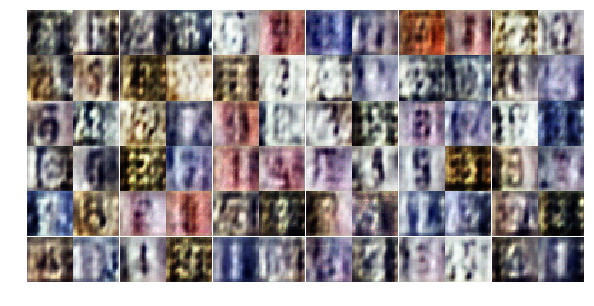

Epoch 3/25... Discriminator Loss: 1.3643... Generator Loss: 0.5090
Epoch 3/25... Discriminator Loss: 0.4211... Generator Loss: 1.3687
Epoch 3/25... Discriminator Loss: 0.9489... Generator Loss: 0.6737
Epoch 3/25... Discriminator Loss: 0.6589... Generator Loss: 1.8888
Epoch 3/25... Discriminator Loss: 0.9080... Generator Loss: 1.2111
Epoch 3/25... Discriminator Loss: 0.5283... Generator Loss: 1.7752
Epoch 3/25... Discriminator Loss: 0.3283... Generator Loss: 2.6761
Epoch 3/25... Discriminator Loss: 1.0061... Generator Loss: 0.9923
Epoch 3/25... Discriminator Loss: 0.4533... Generator Loss: 1.5469
Epoch 3/25... Discriminator Loss: 0.1862... Generator Loss: 3.3796


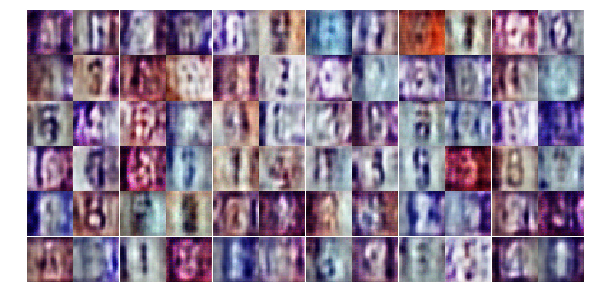

Epoch 3/25... Discriminator Loss: 0.9811... Generator Loss: 0.6951
Epoch 3/25... Discriminator Loss: 0.8305... Generator Loss: 1.3064
Epoch 3/25... Discriminator Loss: 0.5350... Generator Loss: 1.3454
Epoch 3/25... Discriminator Loss: 0.3455... Generator Loss: 1.6582
Epoch 3/25... Discriminator Loss: 1.2765... Generator Loss: 2.2406
Epoch 3/25... Discriminator Loss: 0.5406... Generator Loss: 1.4241
Epoch 3/25... Discriminator Loss: 0.7245... Generator Loss: 1.2261
Epoch 3/25... Discriminator Loss: 1.7978... Generator Loss: 0.2451
Epoch 3/25... Discriminator Loss: 0.8446... Generator Loss: 1.1776
Epoch 3/25... Discriminator Loss: 1.7306... Generator Loss: 0.2862


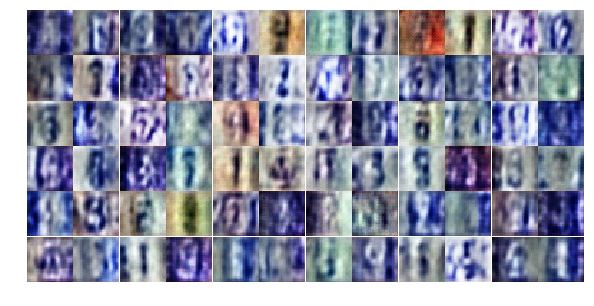

Epoch 3/25... Discriminator Loss: 0.4592... Generator Loss: 2.7499
Epoch 3/25... Discriminator Loss: 0.2594... Generator Loss: 1.7976
Epoch 3/25... Discriminator Loss: 1.3215... Generator Loss: 0.4805
Epoch 3/25... Discriminator Loss: 0.1576... Generator Loss: 3.7276
Epoch 3/25... Discriminator Loss: 1.5564... Generator Loss: 2.4926
Epoch 3/25... Discriminator Loss: 0.2463... Generator Loss: 2.2931
Epoch 3/25... Discriminator Loss: 0.2125... Generator Loss: 2.9006
Epoch 3/25... Discriminator Loss: 0.4161... Generator Loss: 1.9349
Epoch 3/25... Discriminator Loss: 0.8687... Generator Loss: 1.1335
Epoch 3/25... Discriminator Loss: 0.5314... Generator Loss: 3.8166


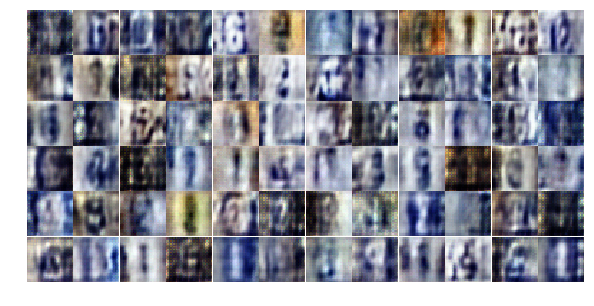

Epoch 3/25... Discriminator Loss: 0.9147... Generator Loss: 3.4375
Epoch 3/25... Discriminator Loss: 0.7579... Generator Loss: 0.9696
Epoch 3/25... Discriminator Loss: 0.8205... Generator Loss: 0.8749
Epoch 3/25... Discriminator Loss: 0.3772... Generator Loss: 1.7242
Epoch 3/25... Discriminator Loss: 1.5483... Generator Loss: 3.2323
Epoch 3/25... Discriminator Loss: 0.4366... Generator Loss: 2.5895
Epoch 3/25... Discriminator Loss: 0.8376... Generator Loss: 1.9048
Epoch 3/25... Discriminator Loss: 0.4186... Generator Loss: 3.8878
Epoch 3/25... Discriminator Loss: 0.6020... Generator Loss: 0.9948
Epoch 3/25... Discriminator Loss: 0.2618... Generator Loss: 3.5879


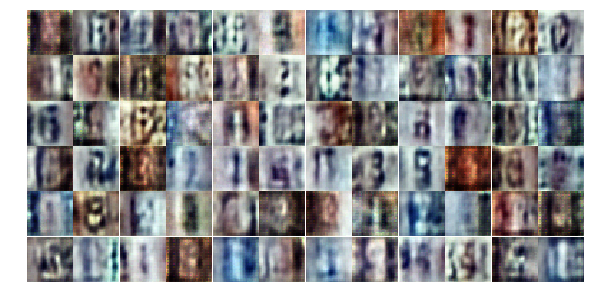

Epoch 3/25... Discriminator Loss: 0.6760... Generator Loss: 0.8978
Epoch 4/25... Discriminator Loss: 1.6825... Generator Loss: 0.8140
Epoch 4/25... Discriminator Loss: 0.6956... Generator Loss: 1.1227
Epoch 4/25... Discriminator Loss: 1.0627... Generator Loss: 0.7636
Epoch 4/25... Discriminator Loss: 0.9987... Generator Loss: 0.6572
Epoch 4/25... Discriminator Loss: 0.9936... Generator Loss: 0.6646
Epoch 4/25... Discriminator Loss: 0.4789... Generator Loss: 1.4082
Epoch 4/25... Discriminator Loss: 0.9523... Generator Loss: 1.2741
Epoch 4/25... Discriminator Loss: 0.5616... Generator Loss: 1.7427
Epoch 4/25... Discriminator Loss: 0.4259... Generator Loss: 1.4215


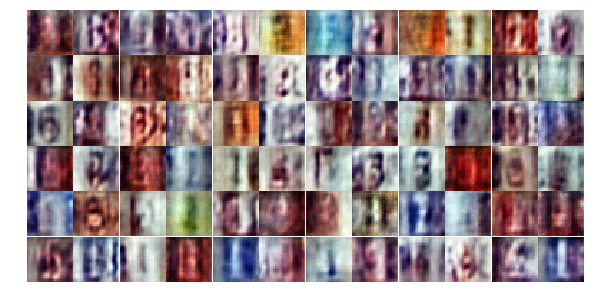

Epoch 4/25... Discriminator Loss: 0.4461... Generator Loss: 1.3956
Epoch 4/25... Discriminator Loss: 0.6089... Generator Loss: 1.0642
Epoch 4/25... Discriminator Loss: 0.9093... Generator Loss: 1.2797
Epoch 4/25... Discriminator Loss: 0.1565... Generator Loss: 3.6280
Epoch 4/25... Discriminator Loss: 0.7223... Generator Loss: 0.8379
Epoch 4/25... Discriminator Loss: 0.9268... Generator Loss: 0.8802
Epoch 4/25... Discriminator Loss: 1.4325... Generator Loss: 0.8226
Epoch 4/25... Discriminator Loss: 1.4743... Generator Loss: 0.5750
Epoch 4/25... Discriminator Loss: 0.9380... Generator Loss: 1.3011
Epoch 4/25... Discriminator Loss: 0.8199... Generator Loss: 1.6880


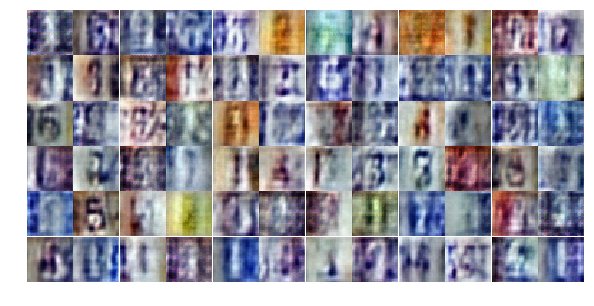

Epoch 4/25... Discriminator Loss: 1.0614... Generator Loss: 0.8253
Epoch 4/25... Discriminator Loss: 1.2349... Generator Loss: 0.5146
Epoch 4/25... Discriminator Loss: 1.1758... Generator Loss: 0.5863
Epoch 4/25... Discriminator Loss: 0.4725... Generator Loss: 1.5137
Epoch 4/25... Discriminator Loss: 1.0808... Generator Loss: 0.7769
Epoch 4/25... Discriminator Loss: 0.6981... Generator Loss: 2.4091
Epoch 4/25... Discriminator Loss: 0.7097... Generator Loss: 2.2713
Epoch 4/25... Discriminator Loss: 0.7788... Generator Loss: 1.1910
Epoch 4/25... Discriminator Loss: 0.8803... Generator Loss: 0.8166
Epoch 4/25... Discriminator Loss: 0.9319... Generator Loss: 0.7050


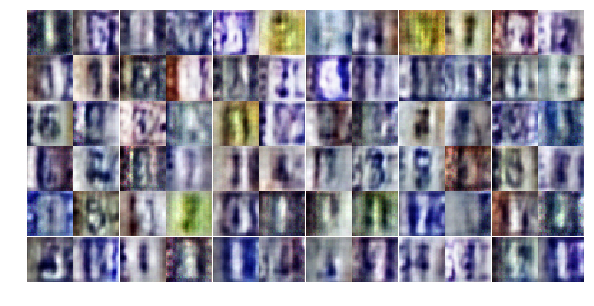

Epoch 4/25... Discriminator Loss: 0.4106... Generator Loss: 1.6322
Epoch 4/25... Discriminator Loss: 0.3762... Generator Loss: 3.1563
Epoch 4/25... Discriminator Loss: 0.6259... Generator Loss: 1.1001
Epoch 4/25... Discriminator Loss: 0.3115... Generator Loss: 3.1475
Epoch 4/25... Discriminator Loss: 0.2517... Generator Loss: 2.0672
Epoch 4/25... Discriminator Loss: 1.5503... Generator Loss: 1.8190
Epoch 4/25... Discriminator Loss: 1.8243... Generator Loss: 0.2605
Epoch 4/25... Discriminator Loss: 0.4003... Generator Loss: 1.5375
Epoch 4/25... Discriminator Loss: 0.5882... Generator Loss: 1.2104
Epoch 4/25... Discriminator Loss: 0.4655... Generator Loss: 2.3868


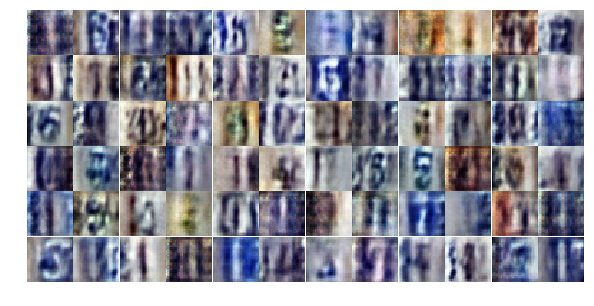

Epoch 4/25... Discriminator Loss: 1.3669... Generator Loss: 0.6195
Epoch 4/25... Discriminator Loss: 1.0903... Generator Loss: 0.8518
Epoch 4/25... Discriminator Loss: 0.9046... Generator Loss: 0.7958
Epoch 4/25... Discriminator Loss: 0.6570... Generator Loss: 1.1757
Epoch 4/25... Discriminator Loss: 0.4178... Generator Loss: 1.6753
Epoch 4/25... Discriminator Loss: 0.7535... Generator Loss: 2.4916
Epoch 4/25... Discriminator Loss: 0.8136... Generator Loss: 1.1737
Epoch 4/25... Discriminator Loss: 0.8387... Generator Loss: 0.9707
Epoch 4/25... Discriminator Loss: 0.5493... Generator Loss: 2.9119
Epoch 4/25... Discriminator Loss: 0.6712... Generator Loss: 2.1186


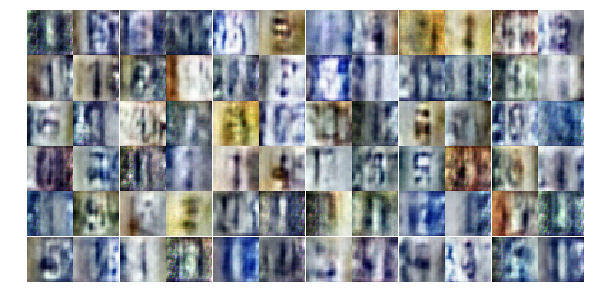

Epoch 4/25... Discriminator Loss: 1.0240... Generator Loss: 0.7373
Epoch 4/25... Discriminator Loss: 1.7981... Generator Loss: 0.2635
Epoch 4/25... Discriminator Loss: 0.4126... Generator Loss: 2.8801
Epoch 4/25... Discriminator Loss: 0.8500... Generator Loss: 0.7968
Epoch 4/25... Discriminator Loss: 0.4766... Generator Loss: 2.0443
Epoch 4/25... Discriminator Loss: 0.4308... Generator Loss: 2.3391
Epoch 4/25... Discriminator Loss: 0.8807... Generator Loss: 2.2769
Epoch 4/25... Discriminator Loss: 0.5022... Generator Loss: 1.5130
Epoch 4/25... Discriminator Loss: 0.6793... Generator Loss: 1.0179
Epoch 5/25... Discriminator Loss: 0.7289... Generator Loss: 0.9915


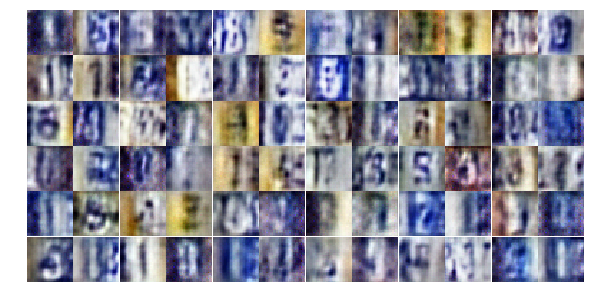

Epoch 5/25... Discriminator Loss: 0.5743... Generator Loss: 3.5910
Epoch 5/25... Discriminator Loss: 0.3133... Generator Loss: 3.6280
Epoch 5/25... Discriminator Loss: 0.8862... Generator Loss: 3.3521
Epoch 5/25... Discriminator Loss: 0.5904... Generator Loss: 1.0414
Epoch 5/25... Discriminator Loss: 0.4446... Generator Loss: 4.3767
Epoch 5/25... Discriminator Loss: 0.9105... Generator Loss: 0.9940
Epoch 5/25... Discriminator Loss: 1.3964... Generator Loss: 0.3808
Epoch 5/25... Discriminator Loss: 0.3857... Generator Loss: 1.5113
Epoch 5/25... Discriminator Loss: 0.9510... Generator Loss: 2.1434
Epoch 5/25... Discriminator Loss: 0.8338... Generator Loss: 3.3503


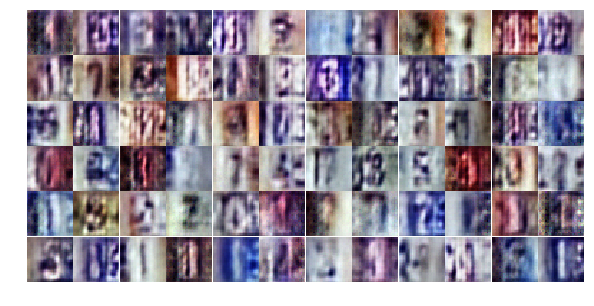

Epoch 5/25... Discriminator Loss: 0.4238... Generator Loss: 2.7860
Epoch 5/25... Discriminator Loss: 0.1742... Generator Loss: 3.7775
Epoch 5/25... Discriminator Loss: 0.8410... Generator Loss: 3.7156
Epoch 5/25... Discriminator Loss: 1.1150... Generator Loss: 0.5186
Epoch 5/25... Discriminator Loss: 0.2883... Generator Loss: 2.1966
Epoch 5/25... Discriminator Loss: 0.4721... Generator Loss: 2.5584
Epoch 5/25... Discriminator Loss: 0.3047... Generator Loss: 5.0479
Epoch 5/25... Discriminator Loss: 0.9115... Generator Loss: 0.6581
Epoch 5/25... Discriminator Loss: 0.1631... Generator Loss: 3.9524
Epoch 5/25... Discriminator Loss: 0.2346... Generator Loss: 3.7099


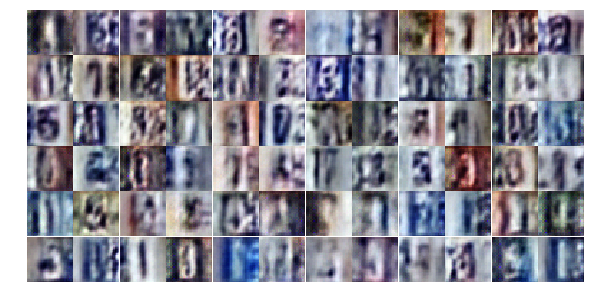

Epoch 5/25... Discriminator Loss: 0.3123... Generator Loss: 3.1504
Epoch 5/25... Discriminator Loss: 0.3853... Generator Loss: 1.6508
Epoch 5/25... Discriminator Loss: 0.6394... Generator Loss: 4.7229
Epoch 5/25... Discriminator Loss: 0.1692... Generator Loss: 3.4115
Epoch 5/25... Discriminator Loss: 0.2826... Generator Loss: 2.1909
Epoch 5/25... Discriminator Loss: 0.2906... Generator Loss: 1.8669
Epoch 5/25... Discriminator Loss: 0.1444... Generator Loss: 3.0225
Epoch 5/25... Discriminator Loss: 0.3218... Generator Loss: 1.7042
Epoch 5/25... Discriminator Loss: 0.1324... Generator Loss: 3.0054
Epoch 5/25... Discriminator Loss: 0.9997... Generator Loss: 0.6022


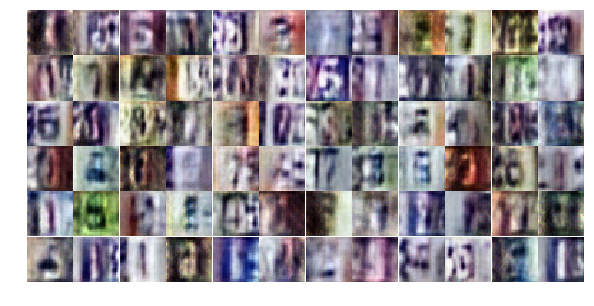

Epoch 5/25... Discriminator Loss: 0.7933... Generator Loss: 0.7386
Epoch 5/25... Discriminator Loss: 0.2036... Generator Loss: 2.0879
Epoch 5/25... Discriminator Loss: 0.7938... Generator Loss: 0.7733
Epoch 5/25... Discriminator Loss: 0.2194... Generator Loss: 2.1179
Epoch 5/25... Discriminator Loss: 0.2912... Generator Loss: 1.7418
Epoch 5/25... Discriminator Loss: 0.6027... Generator Loss: 5.2331
Epoch 5/25... Discriminator Loss: 0.6979... Generator Loss: 0.9284
Epoch 5/25... Discriminator Loss: 0.5294... Generator Loss: 1.2619
Epoch 5/25... Discriminator Loss: 0.1396... Generator Loss: 3.0124
Epoch 5/25... Discriminator Loss: 0.8210... Generator Loss: 2.8583


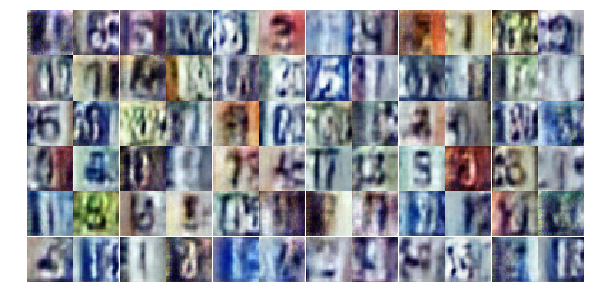

Epoch 5/25... Discriminator Loss: 0.7616... Generator Loss: 0.9399
Epoch 5/25... Discriminator Loss: 0.2872... Generator Loss: 4.6229
Epoch 5/25... Discriminator Loss: 0.2148... Generator Loss: 2.4308
Epoch 5/25... Discriminator Loss: 0.0902... Generator Loss: 4.5270
Epoch 5/25... Discriminator Loss: 0.5102... Generator Loss: 1.2136
Epoch 5/25... Discriminator Loss: 0.2291... Generator Loss: 2.4819
Epoch 5/25... Discriminator Loss: 0.5917... Generator Loss: 5.2737
Epoch 5/25... Discriminator Loss: 0.7236... Generator Loss: 0.9241
Epoch 5/25... Discriminator Loss: 0.2487... Generator Loss: 1.9747
Epoch 5/25... Discriminator Loss: 0.1661... Generator Loss: 2.9591


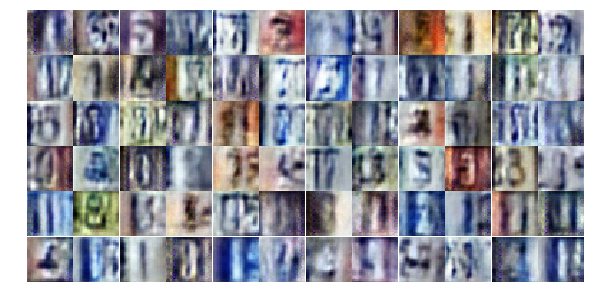

Epoch 5/25... Discriminator Loss: 1.0428... Generator Loss: 0.6215
Epoch 5/25... Discriminator Loss: 0.6878... Generator Loss: 5.2719
Epoch 5/25... Discriminator Loss: 0.0743... Generator Loss: 4.8841
Epoch 5/25... Discriminator Loss: 0.1372... Generator Loss: 3.3386
Epoch 5/25... Discriminator Loss: 0.1674... Generator Loss: 3.0172
Epoch 5/25... Discriminator Loss: 0.1973... Generator Loss: 2.5998
Epoch 6/25... Discriminator Loss: 0.3402... Generator Loss: 1.7283
Epoch 6/25... Discriminator Loss: 0.1627... Generator Loss: 2.7062
Epoch 6/25... Discriminator Loss: 0.0937... Generator Loss: 3.2059
Epoch 6/25... Discriminator Loss: 0.2816... Generator Loss: 1.8773


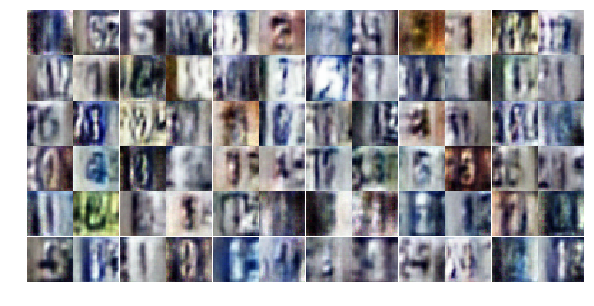

Epoch 6/25... Discriminator Loss: 0.3992... Generator Loss: 1.3452
Epoch 6/25... Discriminator Loss: 0.5489... Generator Loss: 1.1857
Epoch 6/25... Discriminator Loss: 0.1922... Generator Loss: 3.7942
Epoch 6/25... Discriminator Loss: 0.1552... Generator Loss: 2.7480
Epoch 6/25... Discriminator Loss: 0.2618... Generator Loss: 6.8322
Epoch 6/25... Discriminator Loss: 0.1359... Generator Loss: 5.7773
Epoch 6/25... Discriminator Loss: 0.8074... Generator Loss: 0.7697
Epoch 6/25... Discriminator Loss: 0.2064... Generator Loss: 2.6265
Epoch 6/25... Discriminator Loss: 0.2702... Generator Loss: 5.9245
Epoch 6/25... Discriminator Loss: 0.0850... Generator Loss: 3.5629


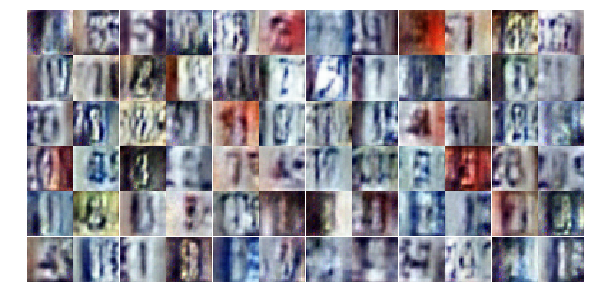

Epoch 6/25... Discriminator Loss: 0.4797... Generator Loss: 6.2463
Epoch 6/25... Discriminator Loss: 0.7918... Generator Loss: 1.4820
Epoch 6/25... Discriminator Loss: 0.3153... Generator Loss: 1.7959
Epoch 6/25... Discriminator Loss: 0.1350... Generator Loss: 2.8009
Epoch 6/25... Discriminator Loss: 0.1908... Generator Loss: 2.9118
Epoch 6/25... Discriminator Loss: 0.1057... Generator Loss: 5.7596
Epoch 6/25... Discriminator Loss: 0.4665... Generator Loss: 1.2922
Epoch 6/25... Discriminator Loss: 0.7083... Generator Loss: 0.9524
Epoch 6/25... Discriminator Loss: 1.3928... Generator Loss: 1.0019
Epoch 6/25... Discriminator Loss: 0.3917... Generator Loss: 1.6685


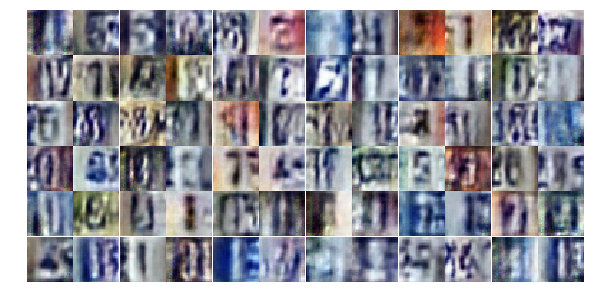

Epoch 6/25... Discriminator Loss: 0.0601... Generator Loss: 4.6587
Epoch 6/25... Discriminator Loss: 0.1174... Generator Loss: 3.1245
Epoch 6/25... Discriminator Loss: 0.3503... Generator Loss: 1.6654
Epoch 6/25... Discriminator Loss: 0.2134... Generator Loss: 2.2263
Epoch 6/25... Discriminator Loss: 0.3258... Generator Loss: 2.5797
Epoch 6/25... Discriminator Loss: 1.2560... Generator Loss: 0.5489
Epoch 6/25... Discriminator Loss: 0.1785... Generator Loss: 3.1708
Epoch 6/25... Discriminator Loss: 0.1827... Generator Loss: 2.4904
Epoch 6/25... Discriminator Loss: 1.9143... Generator Loss: 0.2308
Epoch 6/25... Discriminator Loss: 0.1452... Generator Loss: 4.0206


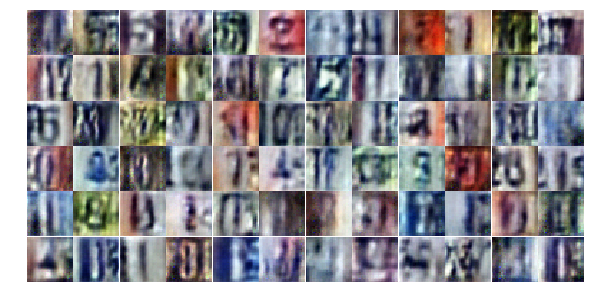

Epoch 6/25... Discriminator Loss: 0.4448... Generator Loss: 2.4552
Epoch 6/25... Discriminator Loss: 0.5042... Generator Loss: 2.0351
Epoch 6/25... Discriminator Loss: 0.0984... Generator Loss: 5.1004
Epoch 6/25... Discriminator Loss: 0.1935... Generator Loss: 2.3456
Epoch 6/25... Discriminator Loss: 1.1025... Generator Loss: 6.6758
Epoch 6/25... Discriminator Loss: 0.2572... Generator Loss: 2.3506
Epoch 6/25... Discriminator Loss: 0.1604... Generator Loss: 3.1044
Epoch 6/25... Discriminator Loss: 0.2076... Generator Loss: 2.1436
Epoch 6/25... Discriminator Loss: 0.7937... Generator Loss: 0.7267
Epoch 6/25... Discriminator Loss: 0.1214... Generator Loss: 4.4232


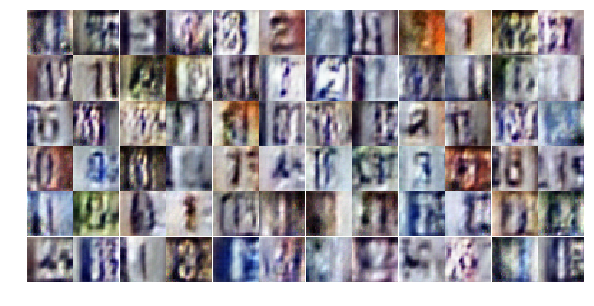

Epoch 6/25... Discriminator Loss: 0.1751... Generator Loss: 3.4705
Epoch 6/25... Discriminator Loss: 0.1415... Generator Loss: 2.8713
Epoch 6/25... Discriminator Loss: 0.0797... Generator Loss: 5.8254
Epoch 6/25... Discriminator Loss: 0.6677... Generator Loss: 1.0741
Epoch 6/25... Discriminator Loss: 0.6587... Generator Loss: 0.9613
Epoch 6/25... Discriminator Loss: 0.1156... Generator Loss: 3.9718
Epoch 6/25... Discriminator Loss: 0.6507... Generator Loss: 1.0110
Epoch 6/25... Discriminator Loss: 0.2602... Generator Loss: 1.8502
Epoch 6/25... Discriminator Loss: 0.4410... Generator Loss: 3.4860
Epoch 6/25... Discriminator Loss: 0.2061... Generator Loss: 2.5971


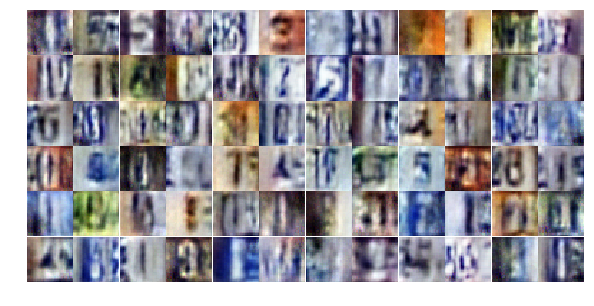

Epoch 6/25... Discriminator Loss: 0.2811... Generator Loss: 1.7881
Epoch 6/25... Discriminator Loss: 0.1338... Generator Loss: 3.9278
Epoch 6/25... Discriminator Loss: 1.3511... Generator Loss: 0.8204
Epoch 7/25... Discriminator Loss: 0.6998... Generator Loss: 2.6812
Epoch 7/25... Discriminator Loss: 0.2243... Generator Loss: 2.2854
Epoch 7/25... Discriminator Loss: 0.2488... Generator Loss: 3.5936
Epoch 7/25... Discriminator Loss: 0.4834... Generator Loss: 1.2721
Epoch 7/25... Discriminator Loss: 1.6544... Generator Loss: 0.3691
Epoch 7/25... Discriminator Loss: 0.2104... Generator Loss: 2.5459
Epoch 7/25... Discriminator Loss: 0.3991... Generator Loss: 1.7866


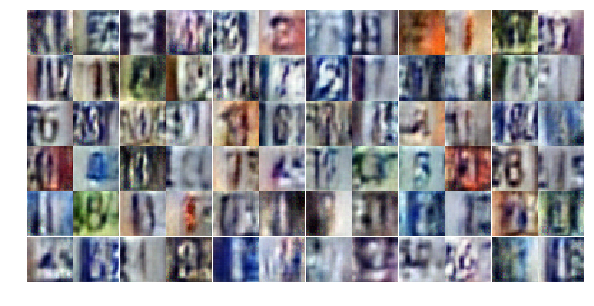

Epoch 7/25... Discriminator Loss: 0.2719... Generator Loss: 4.4106
Epoch 7/25... Discriminator Loss: 0.2170... Generator Loss: 1.9858
Epoch 7/25... Discriminator Loss: 0.3598... Generator Loss: 1.7105
Epoch 7/25... Discriminator Loss: 0.2245... Generator Loss: 2.1636
Epoch 7/25... Discriminator Loss: 0.1404... Generator Loss: 3.6090
Epoch 7/25... Discriminator Loss: 0.1812... Generator Loss: 3.1200
Epoch 7/25... Discriminator Loss: 0.1065... Generator Loss: 3.0709
Epoch 7/25... Discriminator Loss: 0.5511... Generator Loss: 1.0879
Epoch 7/25... Discriminator Loss: 0.7616... Generator Loss: 1.4400
Epoch 7/25... Discriminator Loss: 1.0249... Generator Loss: 1.1246


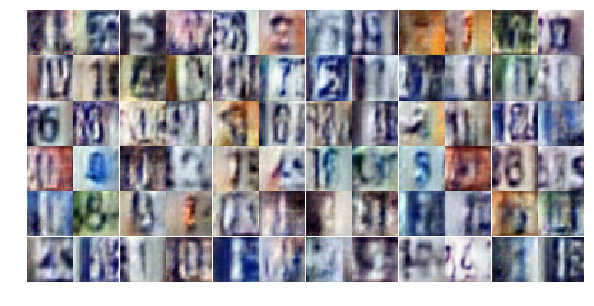

Epoch 7/25... Discriminator Loss: 0.8051... Generator Loss: 1.0011
Epoch 7/25... Discriminator Loss: 1.3134... Generator Loss: 0.4429
Epoch 7/25... Discriminator Loss: 0.3756... Generator Loss: 3.4573
Epoch 7/25... Discriminator Loss: 0.5418... Generator Loss: 1.3102
Epoch 7/25... Discriminator Loss: 0.6504... Generator Loss: 1.0282
Epoch 7/25... Discriminator Loss: 0.3982... Generator Loss: 1.7450
Epoch 7/25... Discriminator Loss: 0.2973... Generator Loss: 4.3864
Epoch 7/25... Discriminator Loss: 0.9012... Generator Loss: 0.7056
Epoch 7/25... Discriminator Loss: 0.1989... Generator Loss: 3.2055
Epoch 7/25... Discriminator Loss: 0.1780... Generator Loss: 3.8339


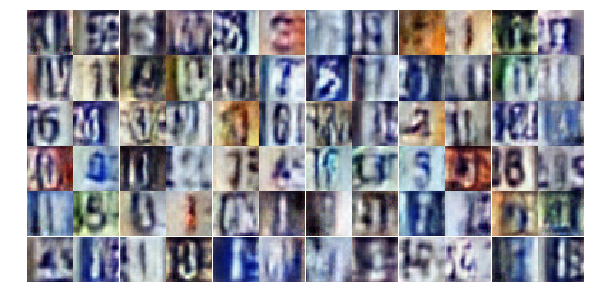

Epoch 7/25... Discriminator Loss: 0.3034... Generator Loss: 2.0729
Epoch 7/25... Discriminator Loss: 0.1788... Generator Loss: 2.4304
Epoch 7/25... Discriminator Loss: 0.1012... Generator Loss: 3.4524
Epoch 7/25... Discriminator Loss: 0.1845... Generator Loss: 4.9112
Epoch 7/25... Discriminator Loss: 0.1058... Generator Loss: 3.1202
Epoch 7/25... Discriminator Loss: 0.7905... Generator Loss: 0.7847
Epoch 7/25... Discriminator Loss: 0.3548... Generator Loss: 1.7310
Epoch 7/25... Discriminator Loss: 0.5452... Generator Loss: 1.2783
Epoch 7/25... Discriminator Loss: 0.3625... Generator Loss: 1.7839
Epoch 7/25... Discriminator Loss: 0.3005... Generator Loss: 2.0526


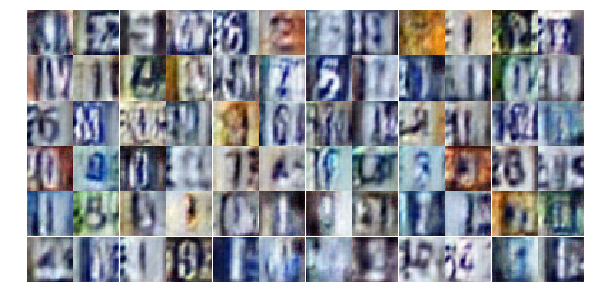

Epoch 7/25... Discriminator Loss: 1.0768... Generator Loss: 0.6586
Epoch 7/25... Discriminator Loss: 0.8867... Generator Loss: 1.0827
Epoch 7/25... Discriminator Loss: 0.3652... Generator Loss: 2.2090
Epoch 7/25... Discriminator Loss: 0.2916... Generator Loss: 1.9653
Epoch 7/25... Discriminator Loss: 0.0731... Generator Loss: 3.8719
Epoch 7/25... Discriminator Loss: 0.4180... Generator Loss: 5.6879
Epoch 7/25... Discriminator Loss: 0.3877... Generator Loss: 1.4922
Epoch 7/25... Discriminator Loss: 1.4254... Generator Loss: 0.3683
Epoch 7/25... Discriminator Loss: 0.1591... Generator Loss: 4.4138
Epoch 7/25... Discriminator Loss: 0.2827... Generator Loss: 1.9264


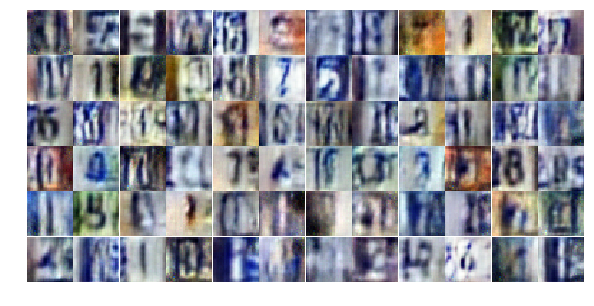

Epoch 7/25... Discriminator Loss: 0.7861... Generator Loss: 5.2052
Epoch 7/25... Discriminator Loss: 0.4687... Generator Loss: 2.1782
Epoch 7/25... Discriminator Loss: 1.0892... Generator Loss: 0.5879
Epoch 7/25... Discriminator Loss: 0.2473... Generator Loss: 2.7551
Epoch 7/25... Discriminator Loss: 0.1888... Generator Loss: 2.3558
Epoch 7/25... Discriminator Loss: 0.3761... Generator Loss: 1.8088
Epoch 7/25... Discriminator Loss: 0.3109... Generator Loss: 1.8350
Epoch 7/25... Discriminator Loss: 0.1684... Generator Loss: 3.9839
Epoch 7/25... Discriminator Loss: 0.9827... Generator Loss: 0.6048
Epoch 7/25... Discriminator Loss: 1.8820... Generator Loss: 0.2590


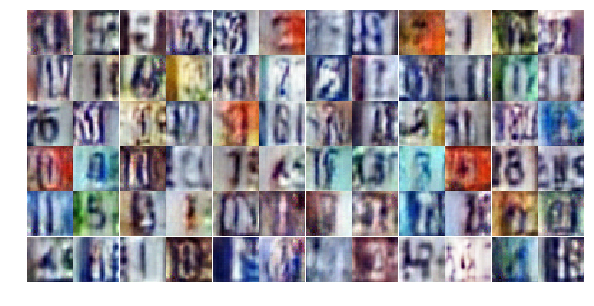

Epoch 7/25... Discriminator Loss: 0.3521... Generator Loss: 1.6227
Epoch 8/25... Discriminator Loss: 0.3618... Generator Loss: 1.4773
Epoch 8/25... Discriminator Loss: 0.3292... Generator Loss: 1.5698
Epoch 8/25... Discriminator Loss: 0.1917... Generator Loss: 5.2068
Epoch 8/25... Discriminator Loss: 0.7679... Generator Loss: 0.8088
Epoch 8/25... Discriminator Loss: 0.1506... Generator Loss: 3.4631
Epoch 8/25... Discriminator Loss: 0.1725... Generator Loss: 3.4826
Epoch 8/25... Discriminator Loss: 0.2487... Generator Loss: 1.9998
Epoch 8/25... Discriminator Loss: 0.3486... Generator Loss: 4.4671
Epoch 8/25... Discriminator Loss: 0.1724... Generator Loss: 2.8710


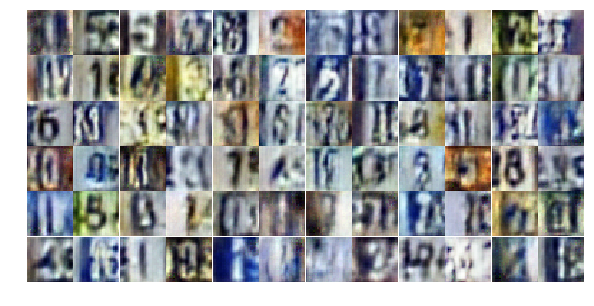

Epoch 8/25... Discriminator Loss: 0.1551... Generator Loss: 3.3424
Epoch 8/25... Discriminator Loss: 1.9579... Generator Loss: 0.3455
Epoch 8/25... Discriminator Loss: 1.3562... Generator Loss: 0.5295
Epoch 8/25... Discriminator Loss: 0.4299... Generator Loss: 2.8820
Epoch 8/25... Discriminator Loss: 0.7468... Generator Loss: 0.9376
Epoch 8/25... Discriminator Loss: 0.9384... Generator Loss: 2.7321
Epoch 8/25... Discriminator Loss: 0.2908... Generator Loss: 2.6605
Epoch 8/25... Discriminator Loss: 1.0341... Generator Loss: 0.6350
Epoch 8/25... Discriminator Loss: 0.2880... Generator Loss: 1.9202
Epoch 8/25... Discriminator Loss: 0.3512... Generator Loss: 2.2086


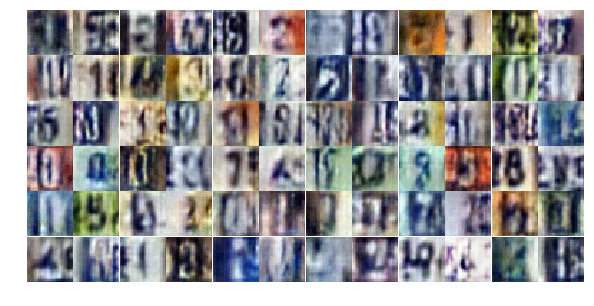

Epoch 8/25... Discriminator Loss: 0.1281... Generator Loss: 5.6235
Epoch 8/25... Discriminator Loss: 0.1575... Generator Loss: 3.2249
Epoch 8/25... Discriminator Loss: 0.6965... Generator Loss: 1.1403
Epoch 8/25... Discriminator Loss: 0.3324... Generator Loss: 5.4036
Epoch 8/25... Discriminator Loss: 0.4851... Generator Loss: 5.0912
Epoch 8/25... Discriminator Loss: 0.2667... Generator Loss: 2.3732
Epoch 8/25... Discriminator Loss: 0.3694... Generator Loss: 2.3020
Epoch 8/25... Discriminator Loss: 0.3791... Generator Loss: 1.6006
Epoch 8/25... Discriminator Loss: 0.1186... Generator Loss: 3.0140
Epoch 8/25... Discriminator Loss: 0.9065... Generator Loss: 0.8734


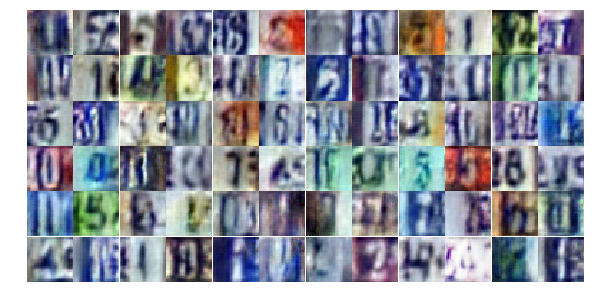

Epoch 8/25... Discriminator Loss: 0.5420... Generator Loss: 2.6702
Epoch 8/25... Discriminator Loss: 0.1568... Generator Loss: 3.5953
Epoch 8/25... Discriminator Loss: 0.4674... Generator Loss: 1.6480
Epoch 8/25... Discriminator Loss: 0.2040... Generator Loss: 3.2454
Epoch 8/25... Discriminator Loss: 0.7933... Generator Loss: 0.8272
Epoch 8/25... Discriminator Loss: 0.2729... Generator Loss: 1.8318
Epoch 8/25... Discriminator Loss: 0.8259... Generator Loss: 0.7976
Epoch 8/25... Discriminator Loss: 0.1704... Generator Loss: 3.9282
Epoch 8/25... Discriminator Loss: 0.1586... Generator Loss: 2.8092
Epoch 8/25... Discriminator Loss: 0.2159... Generator Loss: 2.1580


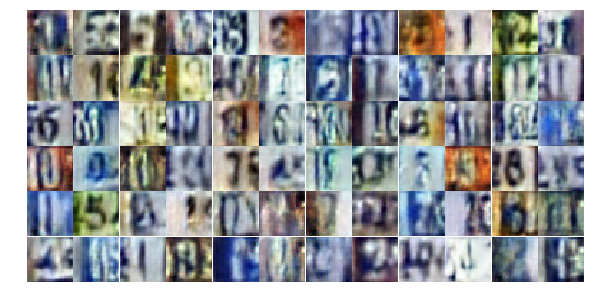

Epoch 8/25... Discriminator Loss: 0.4189... Generator Loss: 1.4008
Epoch 8/25... Discriminator Loss: 0.3047... Generator Loss: 1.7891
Epoch 8/25... Discriminator Loss: 0.2532... Generator Loss: 2.3767
Epoch 8/25... Discriminator Loss: 0.1717... Generator Loss: 2.4846
Epoch 8/25... Discriminator Loss: 0.3449... Generator Loss: 4.0099
Epoch 8/25... Discriminator Loss: 0.4912... Generator Loss: 1.5826
Epoch 8/25... Discriminator Loss: 1.0479... Generator Loss: 0.7474
Epoch 8/25... Discriminator Loss: 1.3820... Generator Loss: 5.3964
Epoch 8/25... Discriminator Loss: 1.3989... Generator Loss: 0.3675
Epoch 8/25... Discriminator Loss: 0.8983... Generator Loss: 0.9447


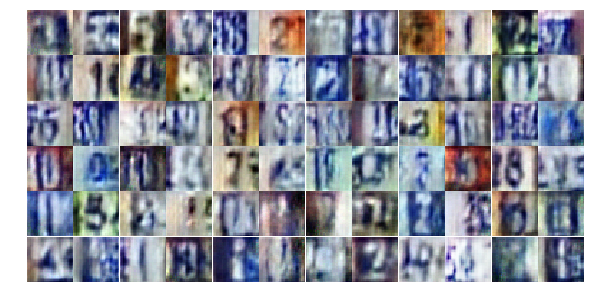

Epoch 8/25... Discriminator Loss: 0.3514... Generator Loss: 2.3161
Epoch 8/25... Discriminator Loss: 0.4324... Generator Loss: 2.2430
Epoch 8/25... Discriminator Loss: 0.2811... Generator Loss: 1.8926
Epoch 8/25... Discriminator Loss: 0.6227... Generator Loss: 1.0312
Epoch 8/25... Discriminator Loss: 0.1441... Generator Loss: 2.9048
Epoch 8/25... Discriminator Loss: 0.3840... Generator Loss: 1.5704
Epoch 8/25... Discriminator Loss: 0.3081... Generator Loss: 1.8136
Epoch 8/25... Discriminator Loss: 0.1826... Generator Loss: 3.6050
Epoch 9/25... Discriminator Loss: 0.4522... Generator Loss: 1.3542
Epoch 9/25... Discriminator Loss: 0.2446... Generator Loss: 2.3439


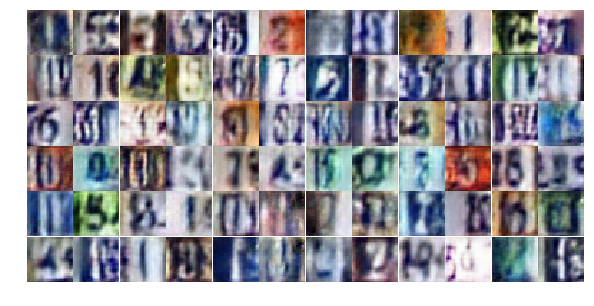

Epoch 9/25... Discriminator Loss: 0.3762... Generator Loss: 4.2509
Epoch 9/25... Discriminator Loss: 0.3588... Generator Loss: 1.7249
Epoch 9/25... Discriminator Loss: 0.3113... Generator Loss: 2.0898
Epoch 9/25... Discriminator Loss: 0.2420... Generator Loss: 3.5812
Epoch 9/25... Discriminator Loss: 2.3195... Generator Loss: 0.2488
Epoch 9/25... Discriminator Loss: 0.8053... Generator Loss: 1.2218
Epoch 9/25... Discriminator Loss: 0.4182... Generator Loss: 1.4213
Epoch 9/25... Discriminator Loss: 0.3523... Generator Loss: 1.7091
Epoch 9/25... Discriminator Loss: 0.4854... Generator Loss: 2.6590
Epoch 9/25... Discriminator Loss: 0.2783... Generator Loss: 1.9909


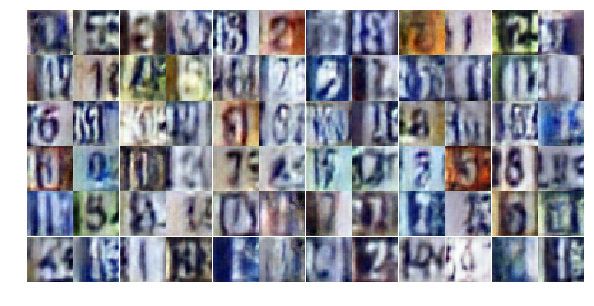

Epoch 9/25... Discriminator Loss: 0.5171... Generator Loss: 1.3267
Epoch 9/25... Discriminator Loss: 0.4091... Generator Loss: 1.5120
Epoch 9/25... Discriminator Loss: 0.2953... Generator Loss: 1.8761
Epoch 9/25... Discriminator Loss: 0.1805... Generator Loss: 2.6848
Epoch 9/25... Discriminator Loss: 0.2068... Generator Loss: 2.3816
Epoch 9/25... Discriminator Loss: 1.1091... Generator Loss: 0.5507
Epoch 9/25... Discriminator Loss: 0.7218... Generator Loss: 0.9413
Epoch 9/25... Discriminator Loss: 0.2324... Generator Loss: 2.4743
Epoch 9/25... Discriminator Loss: 0.6698... Generator Loss: 0.9510
Epoch 9/25... Discriminator Loss: 0.3119... Generator Loss: 1.6455


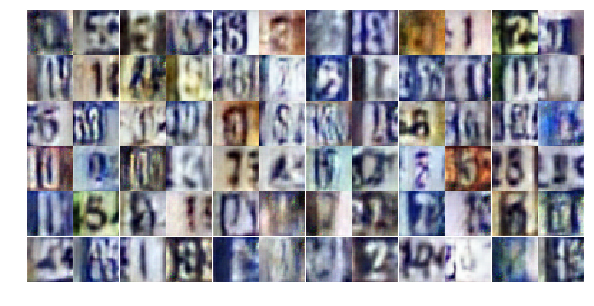

Epoch 9/25... Discriminator Loss: 0.5645... Generator Loss: 1.0621
Epoch 9/25... Discriminator Loss: 0.9610... Generator Loss: 3.9905
Epoch 9/25... Discriminator Loss: 0.3811... Generator Loss: 1.5496
Epoch 9/25... Discriminator Loss: 0.3854... Generator Loss: 1.6955
Epoch 9/25... Discriminator Loss: 0.6098... Generator Loss: 1.0602
Epoch 9/25... Discriminator Loss: 0.2365... Generator Loss: 2.4143
Epoch 9/25... Discriminator Loss: 1.1497... Generator Loss: 0.5055
Epoch 9/25... Discriminator Loss: 2.0120... Generator Loss: 3.7757
Epoch 9/25... Discriminator Loss: 0.2344... Generator Loss: 3.2113
Epoch 9/25... Discriminator Loss: 0.8485... Generator Loss: 0.7642


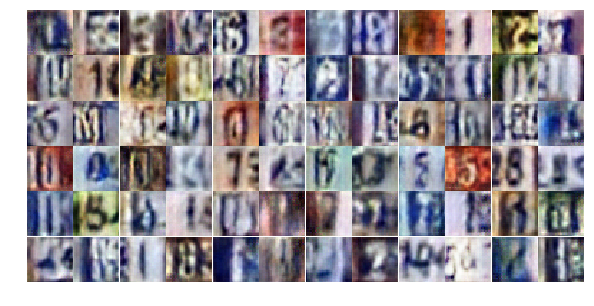

Epoch 9/25... Discriminator Loss: 0.3082... Generator Loss: 1.6297
Epoch 9/25... Discriminator Loss: 0.4096... Generator Loss: 1.6669
Epoch 9/25... Discriminator Loss: 1.1552... Generator Loss: 0.4831
Epoch 9/25... Discriminator Loss: 0.3346... Generator Loss: 2.0185
Epoch 9/25... Discriminator Loss: 0.3019... Generator Loss: 1.9587
Epoch 9/25... Discriminator Loss: 0.1287... Generator Loss: 5.5029
Epoch 9/25... Discriminator Loss: 0.3728... Generator Loss: 1.4455
Epoch 9/25... Discriminator Loss: 0.1751... Generator Loss: 2.5108
Epoch 9/25... Discriminator Loss: 0.3255... Generator Loss: 1.9217
Epoch 9/25... Discriminator Loss: 0.4683... Generator Loss: 1.8892


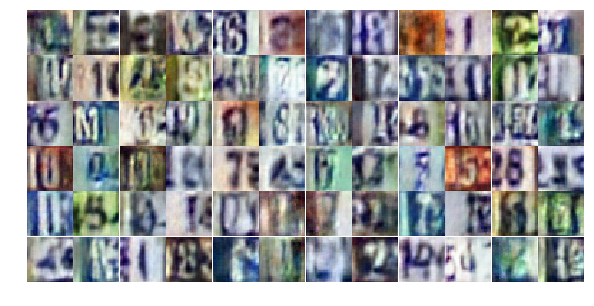

Epoch 9/25... Discriminator Loss: 0.1748... Generator Loss: 3.5676
Epoch 9/25... Discriminator Loss: 0.1930... Generator Loss: 2.3438
Epoch 9/25... Discriminator Loss: 0.5264... Generator Loss: 1.2061
Epoch 9/25... Discriminator Loss: 0.1299... Generator Loss: 2.8683
Epoch 9/25... Discriminator Loss: 0.6482... Generator Loss: 4.8374
Epoch 9/25... Discriminator Loss: 0.4235... Generator Loss: 1.3786
Epoch 9/25... Discriminator Loss: 0.2433... Generator Loss: 2.8742
Epoch 9/25... Discriminator Loss: 0.9791... Generator Loss: 0.6678
Epoch 9/25... Discriminator Loss: 1.2675... Generator Loss: 0.4758
Epoch 9/25... Discriminator Loss: 0.4267... Generator Loss: 2.1934


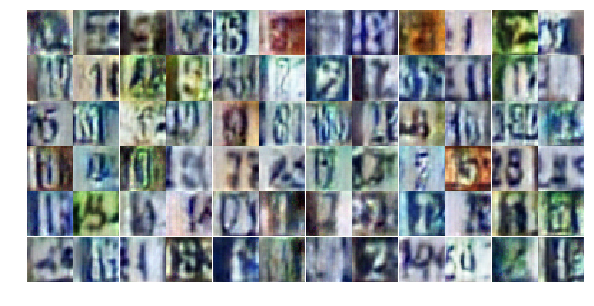

Epoch 9/25... Discriminator Loss: 0.5421... Generator Loss: 1.1828
Epoch 9/25... Discriminator Loss: 0.6626... Generator Loss: 3.5759
Epoch 9/25... Discriminator Loss: 0.3652... Generator Loss: 3.8753
Epoch 9/25... Discriminator Loss: 2.0022... Generator Loss: 0.2180
Epoch 9/25... Discriminator Loss: 0.3740... Generator Loss: 2.1546
Epoch 10/25... Discriminator Loss: 0.7843... Generator Loss: 0.8909
Epoch 10/25... Discriminator Loss: 0.3912... Generator Loss: 1.5969
Epoch 10/25... Discriminator Loss: 0.4351... Generator Loss: 1.4757
Epoch 10/25... Discriminator Loss: 0.7431... Generator Loss: 0.9238
Epoch 10/25... Discriminator Loss: 0.2954... Generator Loss: 1.8406


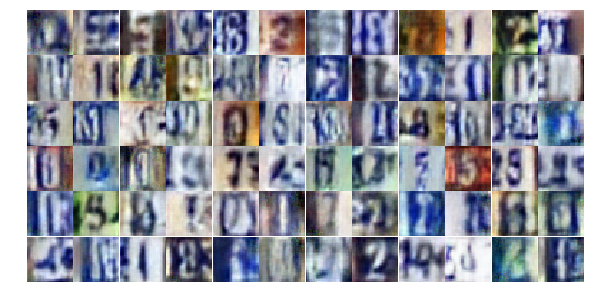

Epoch 10/25... Discriminator Loss: 0.1699... Generator Loss: 2.6109
Epoch 10/25... Discriminator Loss: 0.2315... Generator Loss: 2.3117
Epoch 10/25... Discriminator Loss: 0.4744... Generator Loss: 1.5994
Epoch 10/25... Discriminator Loss: 0.5360... Generator Loss: 1.2127
Epoch 10/25... Discriminator Loss: 0.1738... Generator Loss: 2.6770
Epoch 10/25... Discriminator Loss: 0.3720... Generator Loss: 1.6446
Epoch 10/25... Discriminator Loss: 0.2548... Generator Loss: 2.5077
Epoch 10/25... Discriminator Loss: 0.7339... Generator Loss: 0.9074
Epoch 10/25... Discriminator Loss: 0.7382... Generator Loss: 0.9478
Epoch 10/25... Discriminator Loss: 0.3561... Generator Loss: 2.7260


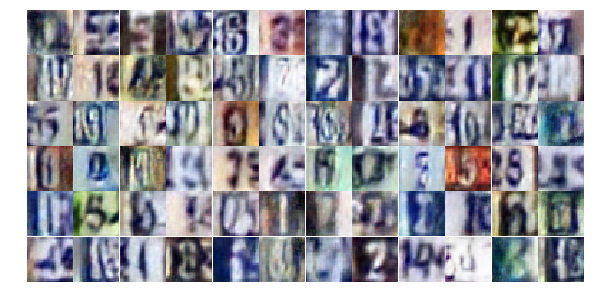

Epoch 10/25... Discriminator Loss: 1.3930... Generator Loss: 0.4630
Epoch 10/25... Discriminator Loss: 0.8894... Generator Loss: 2.3591
Epoch 10/25... Discriminator Loss: 0.4354... Generator Loss: 1.5227
Epoch 10/25... Discriminator Loss: 0.3288... Generator Loss: 1.7460
Epoch 10/25... Discriminator Loss: 0.3017... Generator Loss: 2.0305
Epoch 10/25... Discriminator Loss: 0.1721... Generator Loss: 3.3340
Epoch 10/25... Discriminator Loss: 0.1154... Generator Loss: 3.1410
Epoch 10/25... Discriminator Loss: 0.1475... Generator Loss: 2.9310
Epoch 10/25... Discriminator Loss: 0.8073... Generator Loss: 0.7528
Epoch 10/25... Discriminator Loss: 0.2800... Generator Loss: 3.9634


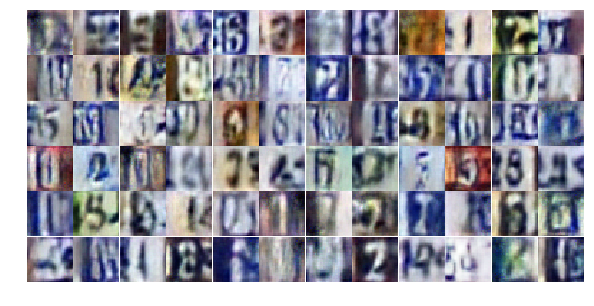

Epoch 10/25... Discriminator Loss: 0.3670... Generator Loss: 1.8484
Epoch 10/25... Discriminator Loss: 1.0276... Generator Loss: 0.5798
Epoch 10/25... Discriminator Loss: 4.6141... Generator Loss: 7.8506
Epoch 10/25... Discriminator Loss: 1.2853... Generator Loss: 1.1864
Epoch 10/25... Discriminator Loss: 1.0717... Generator Loss: 0.6875
Epoch 10/25... Discriminator Loss: 1.0155... Generator Loss: 1.8499
Epoch 10/25... Discriminator Loss: 0.6232... Generator Loss: 1.9375
Epoch 10/25... Discriminator Loss: 0.9714... Generator Loss: 3.9472
Epoch 10/25... Discriminator Loss: 0.7023... Generator Loss: 1.0172
Epoch 10/25... Discriminator Loss: 0.8553... Generator Loss: 0.8559


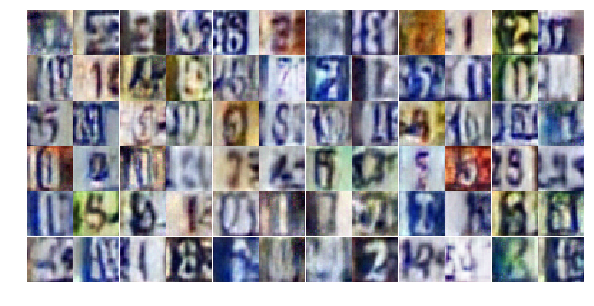

Epoch 10/25... Discriminator Loss: 0.6242... Generator Loss: 1.3575
Epoch 10/25... Discriminator Loss: 0.6838... Generator Loss: 1.1103
Epoch 10/25... Discriminator Loss: 0.4232... Generator Loss: 1.6899
Epoch 10/25... Discriminator Loss: 0.5975... Generator Loss: 1.1103
Epoch 10/25... Discriminator Loss: 0.6418... Generator Loss: 1.0074
Epoch 10/25... Discriminator Loss: 0.6392... Generator Loss: 1.0249
Epoch 10/25... Discriminator Loss: 0.7269... Generator Loss: 0.8887
Epoch 10/25... Discriminator Loss: 0.7476... Generator Loss: 0.9709
Epoch 10/25... Discriminator Loss: 1.0785... Generator Loss: 0.5637
Epoch 10/25... Discriminator Loss: 1.1569... Generator Loss: 2.7876


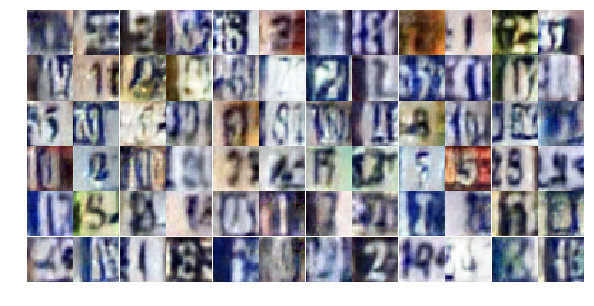

Epoch 10/25... Discriminator Loss: 0.5175... Generator Loss: 1.2464
Epoch 10/25... Discriminator Loss: 0.8991... Generator Loss: 2.3928
Epoch 10/25... Discriminator Loss: 1.3521... Generator Loss: 0.4454
Epoch 10/25... Discriminator Loss: 0.3633... Generator Loss: 1.6591
Epoch 10/25... Discriminator Loss: 0.6486... Generator Loss: 3.2673
Epoch 10/25... Discriminator Loss: 0.2189... Generator Loss: 2.1803
Epoch 10/25... Discriminator Loss: 0.3542... Generator Loss: 1.8821
Epoch 10/25... Discriminator Loss: 0.3235... Generator Loss: 1.8713
Epoch 10/25... Discriminator Loss: 0.5555... Generator Loss: 1.9480
Epoch 10/25... Discriminator Loss: 0.6400... Generator Loss: 0.9838


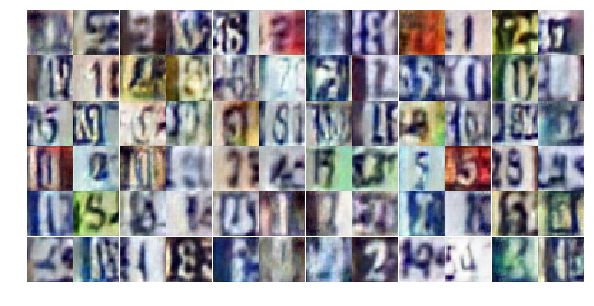

Epoch 10/25... Discriminator Loss: 0.6932... Generator Loss: 0.9395
Epoch 10/25... Discriminator Loss: 0.5382... Generator Loss: 1.4847
Epoch 10/25... Discriminator Loss: 0.7337... Generator Loss: 1.0006
Epoch 11/25... Discriminator Loss: 0.8175... Generator Loss: 1.7206
Epoch 11/25... Discriminator Loss: 0.6772... Generator Loss: 0.9707
Epoch 11/25... Discriminator Loss: 0.8700... Generator Loss: 0.7367
Epoch 11/25... Discriminator Loss: 0.4984... Generator Loss: 1.4053
Epoch 11/25... Discriminator Loss: 0.3942... Generator Loss: 3.1563
Epoch 11/25... Discriminator Loss: 1.5524... Generator Loss: 0.3336
Epoch 11/25... Discriminator Loss: 0.2583... Generator Loss: 2.4569


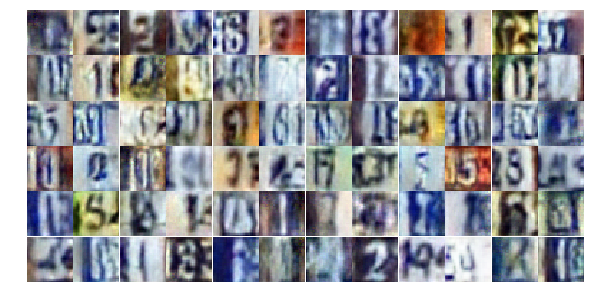

Epoch 11/25... Discriminator Loss: 0.2402... Generator Loss: 2.4188
Epoch 11/25... Discriminator Loss: 0.4439... Generator Loss: 1.3438
Epoch 11/25... Discriminator Loss: 0.2465... Generator Loss: 2.5338
Epoch 11/25... Discriminator Loss: 0.4557... Generator Loss: 1.3810
Epoch 11/25... Discriminator Loss: 0.3235... Generator Loss: 1.6991
Epoch 11/25... Discriminator Loss: 0.3049... Generator Loss: 1.9448
Epoch 11/25... Discriminator Loss: 0.4996... Generator Loss: 1.3132
Epoch 11/25... Discriminator Loss: 0.1889... Generator Loss: 4.1806
Epoch 11/25... Discriminator Loss: 0.7963... Generator Loss: 0.9478
Epoch 11/25... Discriminator Loss: 0.9804... Generator Loss: 0.7116


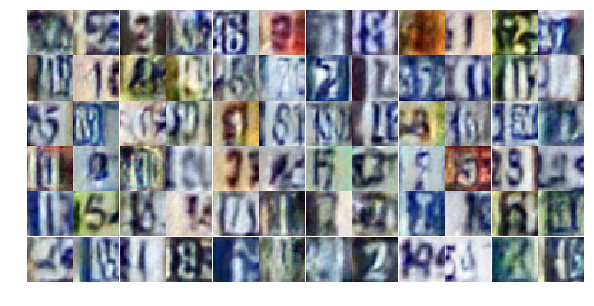

Epoch 11/25... Discriminator Loss: 0.2753... Generator Loss: 2.8431
Epoch 11/25... Discriminator Loss: 0.2944... Generator Loss: 1.9255
Epoch 11/25... Discriminator Loss: 0.2797... Generator Loss: 1.8373
Epoch 11/25... Discriminator Loss: 0.2293... Generator Loss: 2.2079
Epoch 11/25... Discriminator Loss: 0.2871... Generator Loss: 1.8124
Epoch 11/25... Discriminator Loss: 0.3047... Generator Loss: 1.7164
Epoch 11/25... Discriminator Loss: 0.2795... Generator Loss: 1.9407
Epoch 11/25... Discriminator Loss: 0.2506... Generator Loss: 2.6420
Epoch 11/25... Discriminator Loss: 0.1043... Generator Loss: 3.6676
Epoch 11/25... Discriminator Loss: 0.3884... Generator Loss: 1.5947


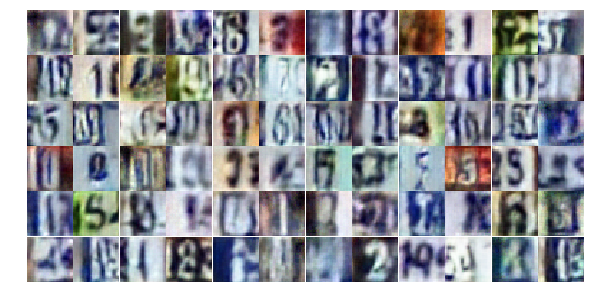

Epoch 11/25... Discriminator Loss: 1.9266... Generator Loss: 0.3071
Epoch 11/25... Discriminator Loss: 0.9550... Generator Loss: 1.1807
Epoch 11/25... Discriminator Loss: 0.8627... Generator Loss: 0.7445
Epoch 11/25... Discriminator Loss: 0.5147... Generator Loss: 1.2594
Epoch 11/25... Discriminator Loss: 0.3680... Generator Loss: 1.8425
Epoch 11/25... Discriminator Loss: 0.8695... Generator Loss: 0.7454
Epoch 11/25... Discriminator Loss: 0.7986... Generator Loss: 0.8227
Epoch 11/25... Discriminator Loss: 0.8565... Generator Loss: 0.8499
Epoch 11/25... Discriminator Loss: 0.3814... Generator Loss: 1.7552
Epoch 11/25... Discriminator Loss: 0.6271... Generator Loss: 1.0448


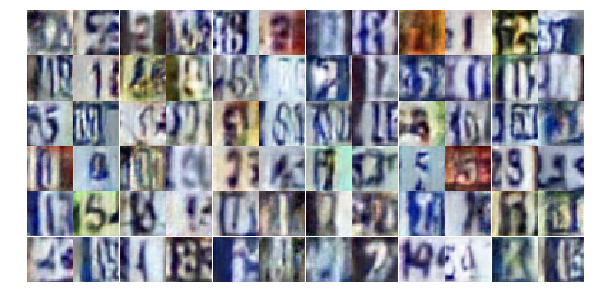

Epoch 11/25... Discriminator Loss: 0.1177... Generator Loss: 4.4417
Epoch 11/25... Discriminator Loss: 0.2886... Generator Loss: 1.9402
Epoch 11/25... Discriminator Loss: 0.3689... Generator Loss: 1.6374
Epoch 11/25... Discriminator Loss: 0.5770... Generator Loss: 1.1457
Epoch 11/25... Discriminator Loss: 0.4294... Generator Loss: 1.4069
Epoch 11/25... Discriminator Loss: 0.2568... Generator Loss: 2.1199
Epoch 11/25... Discriminator Loss: 0.2184... Generator Loss: 3.1759
Epoch 11/25... Discriminator Loss: 1.7490... Generator Loss: 3.1739
Epoch 11/25... Discriminator Loss: 1.3408... Generator Loss: 0.4325
Epoch 11/25... Discriminator Loss: 0.4459... Generator Loss: 1.6945


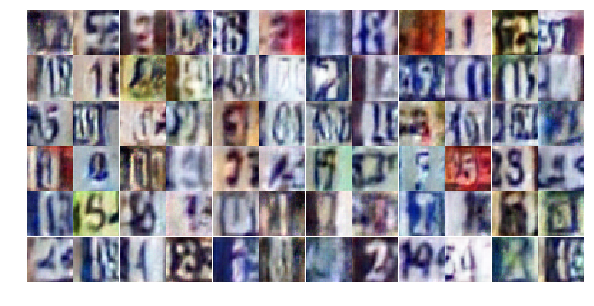

Epoch 11/25... Discriminator Loss: 0.9116... Generator Loss: 0.7910
Epoch 11/25... Discriminator Loss: 0.1846... Generator Loss: 2.6707
Epoch 11/25... Discriminator Loss: 0.4078... Generator Loss: 1.7396
Epoch 11/25... Discriminator Loss: 0.2165... Generator Loss: 2.7959
Epoch 11/25... Discriminator Loss: 0.7685... Generator Loss: 0.9258
Epoch 11/25... Discriminator Loss: 0.9045... Generator Loss: 0.7604
Epoch 11/25... Discriminator Loss: 0.2129... Generator Loss: 2.1546
Epoch 11/25... Discriminator Loss: 0.1775... Generator Loss: 2.4014
Epoch 11/25... Discriminator Loss: 1.1354... Generator Loss: 0.5591
Epoch 11/25... Discriminator Loss: 0.6460... Generator Loss: 1.0967


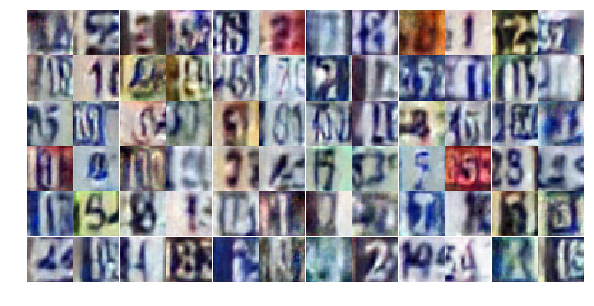

Epoch 12/25... Discriminator Loss: 0.6175... Generator Loss: 1.1065
Epoch 12/25... Discriminator Loss: 0.7107... Generator Loss: 1.0146
Epoch 12/25... Discriminator Loss: 0.2689... Generator Loss: 2.5503
Epoch 12/25... Discriminator Loss: 0.0911... Generator Loss: 4.1951
Epoch 12/25... Discriminator Loss: 0.2944... Generator Loss: 1.9006
Epoch 12/25... Discriminator Loss: 0.6334... Generator Loss: 0.9971
Epoch 12/25... Discriminator Loss: 0.2855... Generator Loss: 2.0860
Epoch 12/25... Discriminator Loss: 0.4621... Generator Loss: 1.3953
Epoch 12/25... Discriminator Loss: 0.2748... Generator Loss: 2.0772
Epoch 12/25... Discriminator Loss: 0.4338... Generator Loss: 2.2543


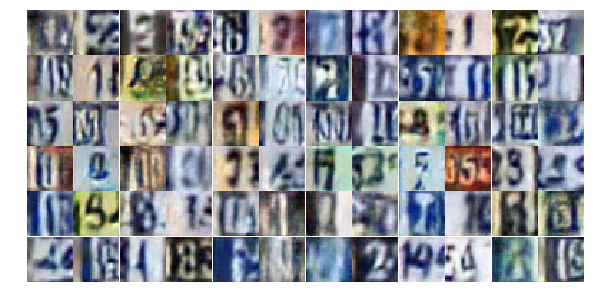

Epoch 12/25... Discriminator Loss: 0.2377... Generator Loss: 2.4900
Epoch 12/25... Discriminator Loss: 0.4045... Generator Loss: 1.5889
Epoch 12/25... Discriminator Loss: 0.2587... Generator Loss: 2.0111
Epoch 12/25... Discriminator Loss: 0.6213... Generator Loss: 1.6009
Epoch 12/25... Discriminator Loss: 0.3476... Generator Loss: 1.9456
Epoch 12/25... Discriminator Loss: 1.6162... Generator Loss: 1.1653
Epoch 12/25... Discriminator Loss: 1.0409... Generator Loss: 0.6579
Epoch 12/25... Discriminator Loss: 0.3897... Generator Loss: 2.2228
Epoch 12/25... Discriminator Loss: 0.2834... Generator Loss: 1.9251
Epoch 12/25... Discriminator Loss: 0.2677... Generator Loss: 1.9651


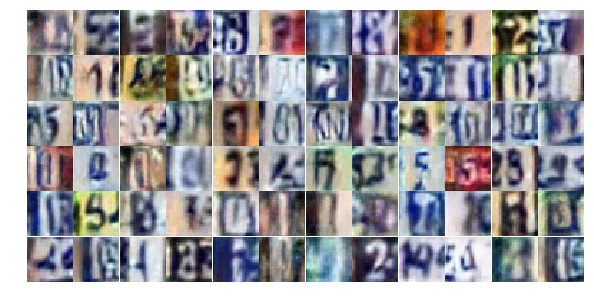

Epoch 12/25... Discriminator Loss: 0.2380... Generator Loss: 2.0904
Epoch 12/25... Discriminator Loss: 0.1958... Generator Loss: 2.3056
Epoch 12/25... Discriminator Loss: 0.1191... Generator Loss: 3.2039
Epoch 12/25... Discriminator Loss: 0.2831... Generator Loss: 1.9579
Epoch 12/25... Discriminator Loss: 0.2320... Generator Loss: 2.4844
Epoch 12/25... Discriminator Loss: 0.0715... Generator Loss: 5.8928
Epoch 12/25... Discriminator Loss: 0.2543... Generator Loss: 2.2327
Epoch 12/25... Discriminator Loss: 0.0742... Generator Loss: 3.6293
Epoch 12/25... Discriminator Loss: 0.5887... Generator Loss: 2.1055
Epoch 12/25... Discriminator Loss: 0.9565... Generator Loss: 0.7126


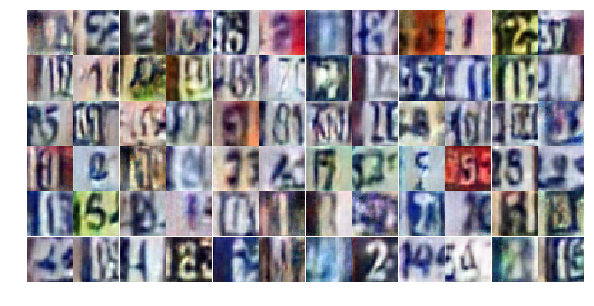

Epoch 12/25... Discriminator Loss: 0.2990... Generator Loss: 2.1169
Epoch 12/25... Discriminator Loss: 0.6298... Generator Loss: 1.1543
Epoch 12/25... Discriminator Loss: 1.3645... Generator Loss: 0.3852
Epoch 12/25... Discriminator Loss: 1.5474... Generator Loss: 0.3303
Epoch 12/25... Discriminator Loss: 0.2584... Generator Loss: 2.6472
Epoch 12/25... Discriminator Loss: 0.4070... Generator Loss: 1.4999
Epoch 12/25... Discriminator Loss: 0.0876... Generator Loss: 3.9617
Epoch 12/25... Discriminator Loss: 0.3381... Generator Loss: 1.7498
Epoch 12/25... Discriminator Loss: 0.3153... Generator Loss: 1.7004
Epoch 12/25... Discriminator Loss: 0.1231... Generator Loss: 2.9795


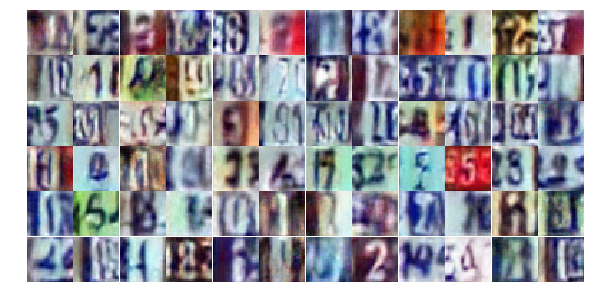

Epoch 12/25... Discriminator Loss: 0.2700... Generator Loss: 2.9395
Epoch 12/25... Discriminator Loss: 0.1745... Generator Loss: 3.2275
Epoch 12/25... Discriminator Loss: 0.5184... Generator Loss: 2.4495
Epoch 12/25... Discriminator Loss: 0.4341... Generator Loss: 1.3677
Epoch 12/25... Discriminator Loss: 0.4510... Generator Loss: 3.5068
Epoch 12/25... Discriminator Loss: 0.7135... Generator Loss: 1.0152
Epoch 12/25... Discriminator Loss: 0.7152... Generator Loss: 0.9372
Epoch 12/25... Discriminator Loss: 0.3254... Generator Loss: 1.7828
Epoch 12/25... Discriminator Loss: 0.4702... Generator Loss: 1.4504
Epoch 12/25... Discriminator Loss: 0.4524... Generator Loss: 1.3446


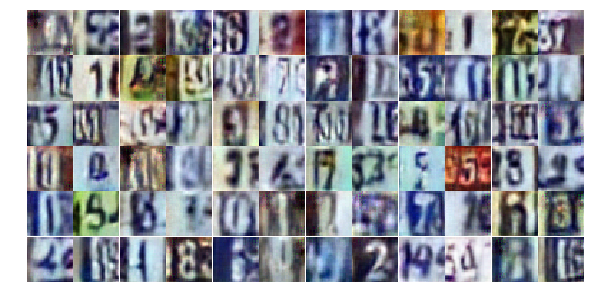

Epoch 12/25... Discriminator Loss: 0.3147... Generator Loss: 1.7450
Epoch 12/25... Discriminator Loss: 0.1135... Generator Loss: 3.1047
Epoch 12/25... Discriminator Loss: 0.7010... Generator Loss: 0.9517
Epoch 12/25... Discriminator Loss: 2.7446... Generator Loss: 0.1236
Epoch 12/25... Discriminator Loss: 0.7544... Generator Loss: 1.2222
Epoch 12/25... Discriminator Loss: 0.8367... Generator Loss: 3.1093
Epoch 12/25... Discriminator Loss: 0.5005... Generator Loss: 1.7623
Epoch 13/25... Discriminator Loss: 0.5055... Generator Loss: 1.3912
Epoch 13/25... Discriminator Loss: 0.5153... Generator Loss: 1.3197
Epoch 13/25... Discriminator Loss: 0.4963... Generator Loss: 1.2841


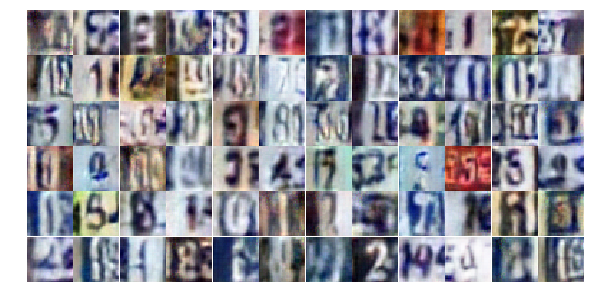

Epoch 13/25... Discriminator Loss: 0.4014... Generator Loss: 1.6553
Epoch 13/25... Discriminator Loss: 0.4491... Generator Loss: 2.6412
Epoch 13/25... Discriminator Loss: 0.7038... Generator Loss: 0.9463
Epoch 13/25... Discriminator Loss: 0.3423... Generator Loss: 1.7900
Epoch 13/25... Discriminator Loss: 0.5317... Generator Loss: 1.2732
Epoch 13/25... Discriminator Loss: 0.3185... Generator Loss: 1.9158
Epoch 13/25... Discriminator Loss: 0.4252... Generator Loss: 1.5998
Epoch 13/25... Discriminator Loss: 0.3230... Generator Loss: 1.8703
Epoch 13/25... Discriminator Loss: 0.3517... Generator Loss: 1.7366
Epoch 13/25... Discriminator Loss: 0.3426... Generator Loss: 2.1434


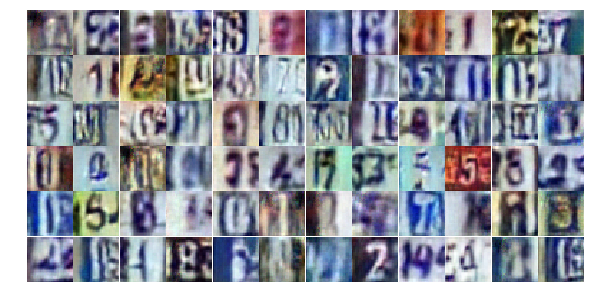

Epoch 13/25... Discriminator Loss: 0.3265... Generator Loss: 2.0810
Epoch 13/25... Discriminator Loss: 0.2675... Generator Loss: 2.5976
Epoch 13/25... Discriminator Loss: 2.8028... Generator Loss: 3.1755
Epoch 13/25... Discriminator Loss: 1.1976... Generator Loss: 0.5115
Epoch 13/25... Discriminator Loss: 0.2542... Generator Loss: 2.4279
Epoch 13/25... Discriminator Loss: 0.9513... Generator Loss: 0.6925
Epoch 13/25... Discriminator Loss: 0.4492... Generator Loss: 1.4393
Epoch 13/25... Discriminator Loss: 0.4628... Generator Loss: 1.6391
Epoch 13/25... Discriminator Loss: 0.3810... Generator Loss: 1.5670
Epoch 13/25... Discriminator Loss: 0.5452... Generator Loss: 1.1739


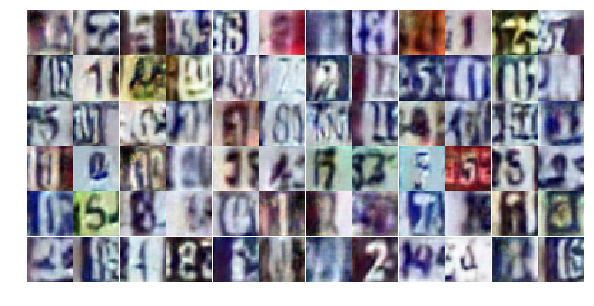

Epoch 13/25... Discriminator Loss: 0.5295... Generator Loss: 6.7764
Epoch 13/25... Discriminator Loss: 0.3954... Generator Loss: 1.8045
Epoch 13/25... Discriminator Loss: 0.3383... Generator Loss: 1.6648
Epoch 13/25... Discriminator Loss: 0.1875... Generator Loss: 2.6611
Epoch 13/25... Discriminator Loss: 0.3347... Generator Loss: 1.7836
Epoch 13/25... Discriminator Loss: 2.1832... Generator Loss: 0.2856
Epoch 13/25... Discriminator Loss: 1.2850... Generator Loss: 0.4648
Epoch 13/25... Discriminator Loss: 0.9169... Generator Loss: 0.7347
Epoch 13/25... Discriminator Loss: 0.3379... Generator Loss: 1.9719
Epoch 13/25... Discriminator Loss: 0.4627... Generator Loss: 1.5882


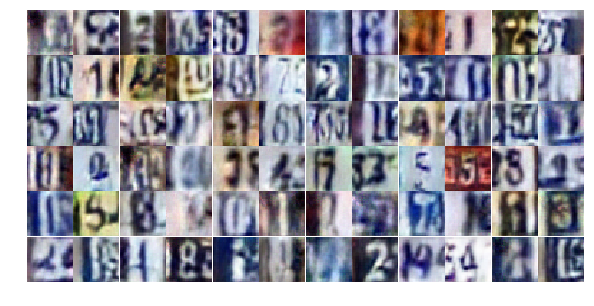

Epoch 13/25... Discriminator Loss: 0.5373... Generator Loss: 1.6026
Epoch 13/25... Discriminator Loss: 0.3265... Generator Loss: 1.9055
Epoch 13/25... Discriminator Loss: 0.8805... Generator Loss: 0.6917
Epoch 13/25... Discriminator Loss: 0.2576... Generator Loss: 3.8517
Epoch 13/25... Discriminator Loss: 0.4267... Generator Loss: 1.4799
Epoch 13/25... Discriminator Loss: 0.2479... Generator Loss: 2.3682
Epoch 13/25... Discriminator Loss: 0.2712... Generator Loss: 1.9720
Epoch 13/25... Discriminator Loss: 0.4188... Generator Loss: 1.4286
Epoch 13/25... Discriminator Loss: 0.5042... Generator Loss: 1.2448
Epoch 13/25... Discriminator Loss: 0.2404... Generator Loss: 1.9704


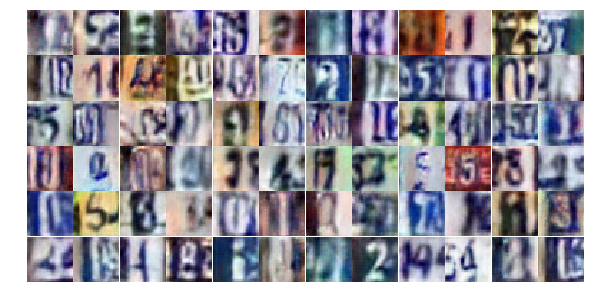

Epoch 13/25... Discriminator Loss: 0.3538... Generator Loss: 1.9710
Epoch 13/25... Discriminator Loss: 0.5465... Generator Loss: 1.2393
Epoch 13/25... Discriminator Loss: 0.6921... Generator Loss: 0.9084
Epoch 13/25... Discriminator Loss: 0.1318... Generator Loss: 3.8901
Epoch 13/25... Discriminator Loss: 1.2021... Generator Loss: 1.8652
Epoch 13/25... Discriminator Loss: 1.0130... Generator Loss: 0.9545
Epoch 13/25... Discriminator Loss: 0.5373... Generator Loss: 1.3118
Epoch 13/25... Discriminator Loss: 0.4496... Generator Loss: 1.4176
Epoch 13/25... Discriminator Loss: 0.1601... Generator Loss: 2.6083
Epoch 13/25... Discriminator Loss: 0.5028... Generator Loss: 1.2427


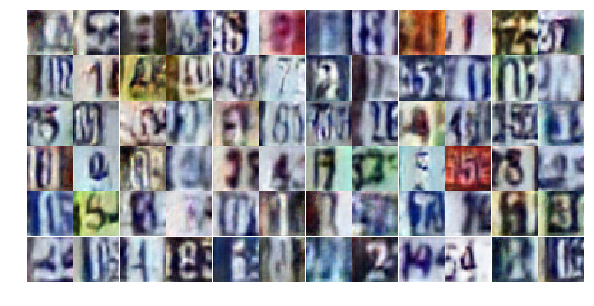

Epoch 13/25... Discriminator Loss: 0.2029... Generator Loss: 3.5352
Epoch 13/25... Discriminator Loss: 0.5965... Generator Loss: 1.0947
Epoch 13/25... Discriminator Loss: 1.0590... Generator Loss: 2.0935
Epoch 13/25... Discriminator Loss: 0.9309... Generator Loss: 0.8269
Epoch 14/25... Discriminator Loss: 1.8345... Generator Loss: 0.2504
Epoch 14/25... Discriminator Loss: 0.2645... Generator Loss: 2.8898
Epoch 14/25... Discriminator Loss: 0.9214... Generator Loss: 0.6995
Epoch 14/25... Discriminator Loss: 0.4905... Generator Loss: 1.4277
Epoch 14/25... Discriminator Loss: 0.2131... Generator Loss: 2.1087
Epoch 14/25... Discriminator Loss: 0.3756... Generator Loss: 1.6642


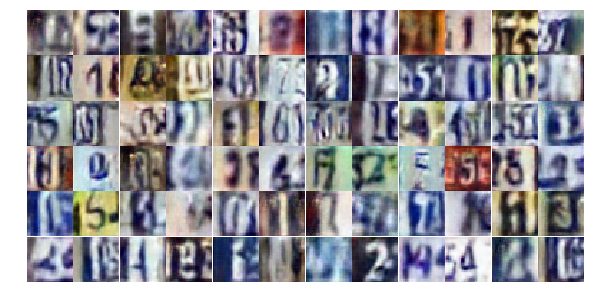

Epoch 14/25... Discriminator Loss: 1.0965... Generator Loss: 3.4058
Epoch 14/25... Discriminator Loss: 1.4766... Generator Loss: 1.1487
Epoch 14/25... Discriminator Loss: 0.6904... Generator Loss: 1.1198
Epoch 14/25... Discriminator Loss: 0.7003... Generator Loss: 1.2474
Epoch 14/25... Discriminator Loss: 1.0070... Generator Loss: 0.6530
Epoch 14/25... Discriminator Loss: 0.3024... Generator Loss: 1.7914
Epoch 14/25... Discriminator Loss: 0.2308... Generator Loss: 2.7460
Epoch 14/25... Discriminator Loss: 1.1704... Generator Loss: 0.5066
Epoch 14/25... Discriminator Loss: 1.3656... Generator Loss: 0.4042
Epoch 14/25... Discriminator Loss: 2.0284... Generator Loss: 0.2086


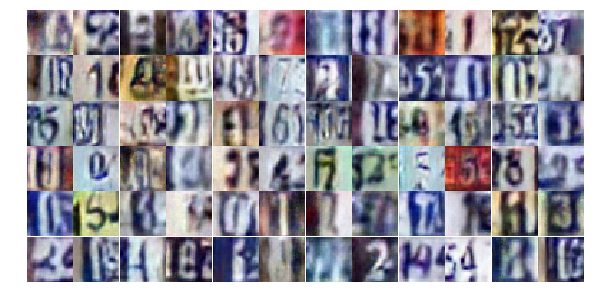

Epoch 14/25... Discriminator Loss: 0.1800... Generator Loss: 2.3307
Epoch 14/25... Discriminator Loss: 0.1945... Generator Loss: 2.8829
Epoch 14/25... Discriminator Loss: 0.8335... Generator Loss: 0.7914
Epoch 14/25... Discriminator Loss: 0.3054... Generator Loss: 1.6716
Epoch 14/25... Discriminator Loss: 0.7984... Generator Loss: 0.8263
Epoch 14/25... Discriminator Loss: 0.2815... Generator Loss: 2.0196
Epoch 14/25... Discriminator Loss: 0.4343... Generator Loss: 2.6035
Epoch 14/25... Discriminator Loss: 0.3749... Generator Loss: 1.5737
Epoch 14/25... Discriminator Loss: 0.3420... Generator Loss: 1.9571
Epoch 14/25... Discriminator Loss: 0.5848... Generator Loss: 1.0999


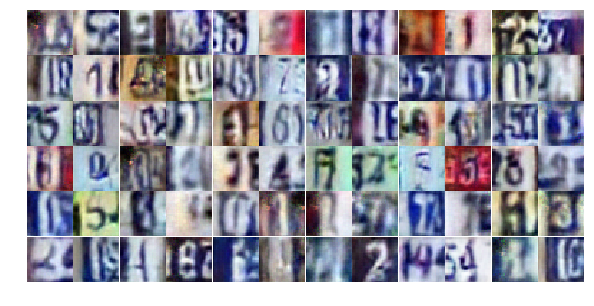

Epoch 14/25... Discriminator Loss: 0.4582... Generator Loss: 1.2786
Epoch 14/25... Discriminator Loss: 0.0791... Generator Loss: 3.7531
Epoch 14/25... Discriminator Loss: 0.3354... Generator Loss: 1.6888
Epoch 14/25... Discriminator Loss: 0.2370... Generator Loss: 2.0075
Epoch 14/25... Discriminator Loss: 1.0105... Generator Loss: 2.4048
Epoch 14/25... Discriminator Loss: 0.3961... Generator Loss: 1.5794
Epoch 14/25... Discriminator Loss: 0.4989... Generator Loss: 1.2679
Epoch 14/25... Discriminator Loss: 0.1997... Generator Loss: 3.0581
Epoch 14/25... Discriminator Loss: 0.4789... Generator Loss: 2.3007
Epoch 14/25... Discriminator Loss: 0.4497... Generator Loss: 1.4987


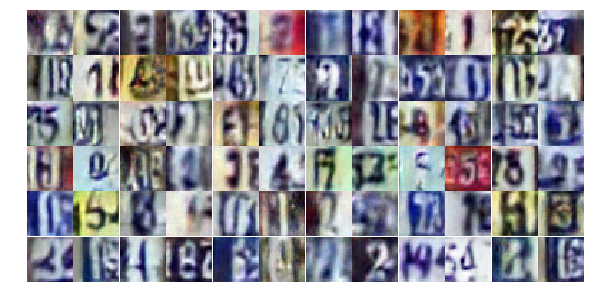

Epoch 14/25... Discriminator Loss: 0.7624... Generator Loss: 0.8540
Epoch 14/25... Discriminator Loss: 1.1356... Generator Loss: 0.5427
Epoch 14/25... Discriminator Loss: 0.8937... Generator Loss: 0.7208
Epoch 14/25... Discriminator Loss: 0.6140... Generator Loss: 1.0513
Epoch 14/25... Discriminator Loss: 0.5137... Generator Loss: 1.2682
Epoch 14/25... Discriminator Loss: 0.2253... Generator Loss: 3.1281
Epoch 14/25... Discriminator Loss: 0.7999... Generator Loss: 0.7964
Epoch 14/25... Discriminator Loss: 0.1648... Generator Loss: 2.7153
Epoch 14/25... Discriminator Loss: 0.6207... Generator Loss: 1.1592
Epoch 14/25... Discriminator Loss: 3.3881... Generator Loss: 0.2629


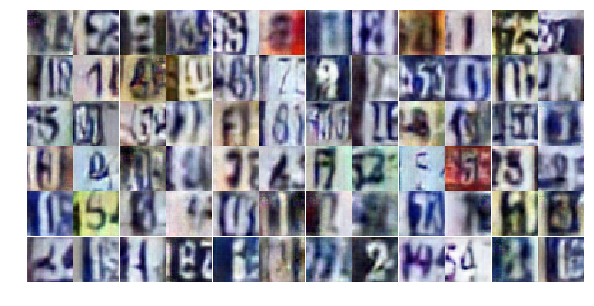

Epoch 14/25... Discriminator Loss: 1.1557... Generator Loss: 2.5718
Epoch 14/25... Discriminator Loss: 1.1744... Generator Loss: 0.5452
Epoch 14/25... Discriminator Loss: 0.3754... Generator Loss: 1.9609
Epoch 14/25... Discriminator Loss: 0.6590... Generator Loss: 1.3521
Epoch 14/25... Discriminator Loss: 0.4037... Generator Loss: 1.6932
Epoch 14/25... Discriminator Loss: 0.4737... Generator Loss: 1.5640
Epoch 14/25... Discriminator Loss: 0.5059... Generator Loss: 2.1541
Epoch 14/25... Discriminator Loss: 0.2599... Generator Loss: 2.3816
Epoch 14/25... Discriminator Loss: 0.5008... Generator Loss: 2.1136
Epoch 14/25... Discriminator Loss: 0.1949... Generator Loss: 3.9400


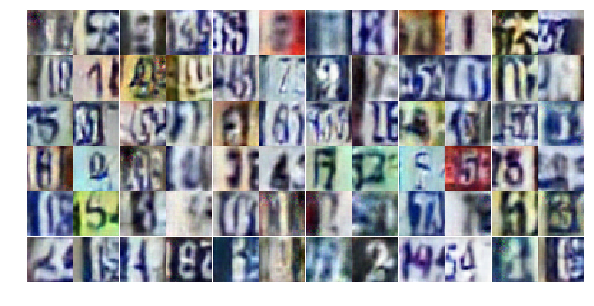

Epoch 14/25... Discriminator Loss: 0.6183... Generator Loss: 1.5132
Epoch 14/25... Discriminator Loss: 0.5609... Generator Loss: 1.1654
Epoch 15/25... Discriminator Loss: 0.3988... Generator Loss: 1.5152
Epoch 15/25... Discriminator Loss: 0.2931... Generator Loss: 2.7391
Epoch 15/25... Discriminator Loss: 0.2907... Generator Loss: 1.9088
Epoch 15/25... Discriminator Loss: 0.5100... Generator Loss: 1.3467
Epoch 15/25... Discriminator Loss: 0.4204... Generator Loss: 1.4100
Epoch 15/25... Discriminator Loss: 0.5404... Generator Loss: 1.8646
Epoch 15/25... Discriminator Loss: 0.3972... Generator Loss: 3.0128
Epoch 15/25... Discriminator Loss: 0.5581... Generator Loss: 1.3002


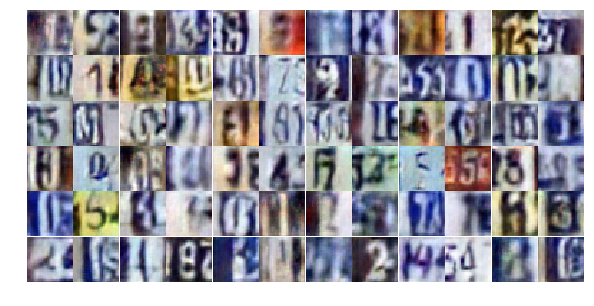

Epoch 15/25... Discriminator Loss: 0.3709... Generator Loss: 2.6343
Epoch 15/25... Discriminator Loss: 0.5267... Generator Loss: 1.5025
Epoch 15/25... Discriminator Loss: 0.5949... Generator Loss: 1.0706
Epoch 15/25... Discriminator Loss: 0.8351... Generator Loss: 0.8281
Epoch 15/25... Discriminator Loss: 0.6643... Generator Loss: 0.9512
Epoch 15/25... Discriminator Loss: 0.1406... Generator Loss: 3.0920
Epoch 15/25... Discriminator Loss: 0.7741... Generator Loss: 0.8773
Epoch 15/25... Discriminator Loss: 0.4976... Generator Loss: 1.3059
Epoch 15/25... Discriminator Loss: 1.0270... Generator Loss: 3.3225
Epoch 15/25... Discriminator Loss: 1.2243... Generator Loss: 0.5632


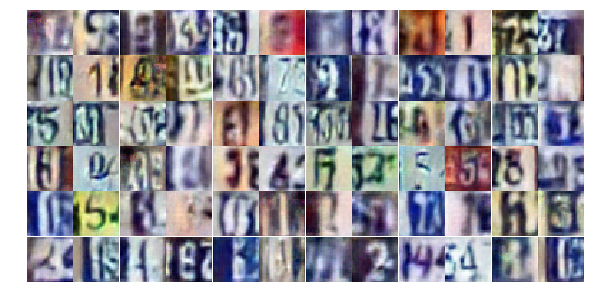

Epoch 15/25... Discriminator Loss: 0.3529... Generator Loss: 1.6648
Epoch 15/25... Discriminator Loss: 0.4709... Generator Loss: 1.5282
Epoch 15/25... Discriminator Loss: 0.5585... Generator Loss: 1.2211
Epoch 15/25... Discriminator Loss: 0.7739... Generator Loss: 0.8666
Epoch 15/25... Discriminator Loss: 1.0331... Generator Loss: 0.6514
Epoch 15/25... Discriminator Loss: 0.8488... Generator Loss: 0.7971
Epoch 15/25... Discriminator Loss: 0.4202... Generator Loss: 2.1570
Epoch 15/25... Discriminator Loss: 2.3028... Generator Loss: 4.3680
Epoch 15/25... Discriminator Loss: 0.7846... Generator Loss: 2.0495
Epoch 15/25... Discriminator Loss: 1.7880... Generator Loss: 0.3129


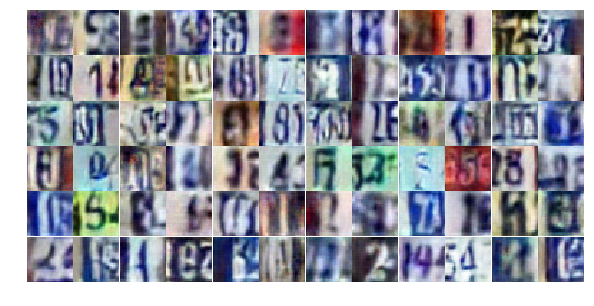

Epoch 15/25... Discriminator Loss: 0.5502... Generator Loss: 1.2036
Epoch 15/25... Discriminator Loss: 0.5434... Generator Loss: 1.3390
Epoch 15/25... Discriminator Loss: 0.5171... Generator Loss: 1.2482
Epoch 15/25... Discriminator Loss: 0.5407... Generator Loss: 1.2987
Epoch 15/25... Discriminator Loss: 0.4574... Generator Loss: 2.1235
Epoch 15/25... Discriminator Loss: 1.0589... Generator Loss: 2.8029
Epoch 15/25... Discriminator Loss: 0.5681... Generator Loss: 1.2834
Epoch 15/25... Discriminator Loss: 0.0896... Generator Loss: 3.7231
Epoch 15/25... Discriminator Loss: 0.5518... Generator Loss: 1.1026
Epoch 15/25... Discriminator Loss: 0.5929... Generator Loss: 1.2923


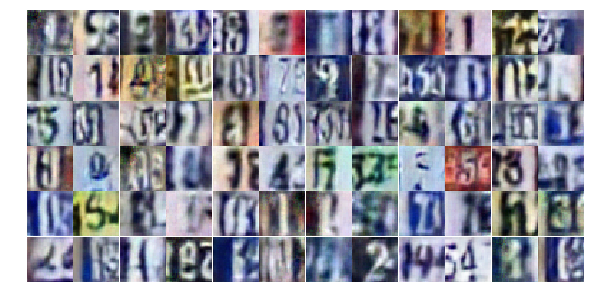

Epoch 15/25... Discriminator Loss: 0.3738... Generator Loss: 1.7398
Epoch 15/25... Discriminator Loss: 0.8240... Generator Loss: 0.8641
Epoch 15/25... Discriminator Loss: 0.5757... Generator Loss: 1.4320
Epoch 15/25... Discriminator Loss: 0.0995... Generator Loss: 5.2719
Epoch 15/25... Discriminator Loss: 0.4122... Generator Loss: 1.4438
Epoch 15/25... Discriminator Loss: 0.7319... Generator Loss: 0.8760
Epoch 15/25... Discriminator Loss: 0.2567... Generator Loss: 2.0539
Epoch 15/25... Discriminator Loss: 0.5873... Generator Loss: 1.0826
Epoch 15/25... Discriminator Loss: 0.6357... Generator Loss: 3.3949
Epoch 15/25... Discriminator Loss: 0.7177... Generator Loss: 0.9758


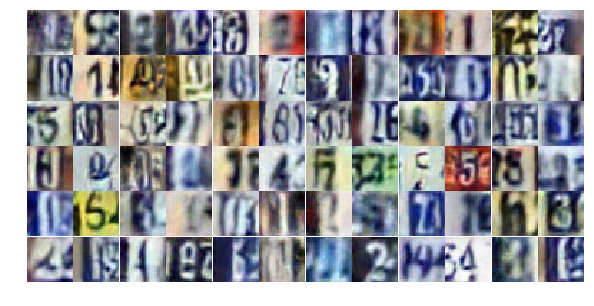

Epoch 15/25... Discriminator Loss: 0.9225... Generator Loss: 0.6683
Epoch 15/25... Discriminator Loss: 0.3399... Generator Loss: 1.7190
Epoch 15/25... Discriminator Loss: 0.3334... Generator Loss: 3.5260
Epoch 15/25... Discriminator Loss: 1.2390... Generator Loss: 3.7349
Epoch 15/25... Discriminator Loss: 0.5560... Generator Loss: 1.5719
Epoch 15/25... Discriminator Loss: 0.6241... Generator Loss: 1.6010
Epoch 15/25... Discriminator Loss: 0.5579... Generator Loss: 1.2073
Epoch 15/25... Discriminator Loss: 0.5670... Generator Loss: 1.2623
Epoch 15/25... Discriminator Loss: 1.7229... Generator Loss: 0.2639
Epoch 16/25... Discriminator Loss: 0.6598... Generator Loss: 1.0855


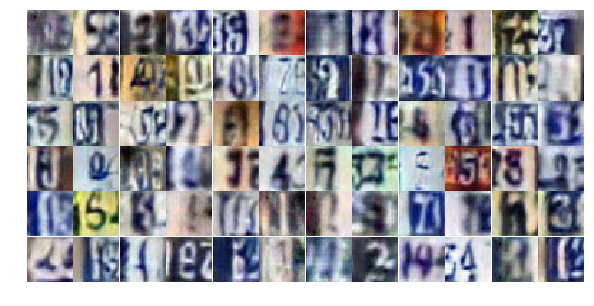

Epoch 16/25... Discriminator Loss: 0.3567... Generator Loss: 1.6618
Epoch 16/25... Discriminator Loss: 0.2866... Generator Loss: 3.1830
Epoch 16/25... Discriminator Loss: 0.4912... Generator Loss: 1.3883
Epoch 16/25... Discriminator Loss: 0.4464... Generator Loss: 1.6619
Epoch 16/25... Discriminator Loss: 0.5720... Generator Loss: 1.1158
Epoch 16/25... Discriminator Loss: 0.5827... Generator Loss: 3.2844
Epoch 16/25... Discriminator Loss: 1.4983... Generator Loss: 0.3554
Epoch 16/25... Discriminator Loss: 0.3308... Generator Loss: 1.8117
Epoch 16/25... Discriminator Loss: 0.2422... Generator Loss: 2.1908
Epoch 16/25... Discriminator Loss: 0.5313... Generator Loss: 1.1830


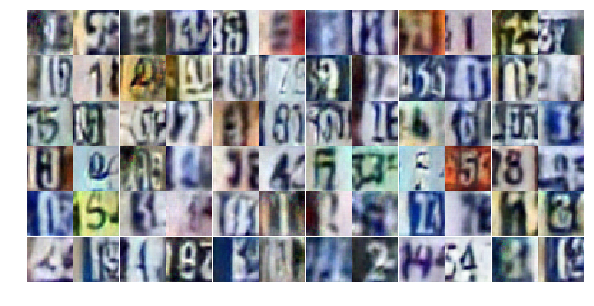

Epoch 16/25... Discriminator Loss: 0.6187... Generator Loss: 1.0854
Epoch 16/25... Discriminator Loss: 0.2918... Generator Loss: 2.0189
Epoch 16/25... Discriminator Loss: 0.8406... Generator Loss: 0.8577
Epoch 16/25... Discriminator Loss: 0.9894... Generator Loss: 0.7080
Epoch 16/25... Discriminator Loss: 0.2509... Generator Loss: 1.9774
Epoch 16/25... Discriminator Loss: 0.2737... Generator Loss: 2.0225
Epoch 16/25... Discriminator Loss: 1.4696... Generator Loss: 0.5098
Epoch 16/25... Discriminator Loss: 0.3284... Generator Loss: 2.1242
Epoch 16/25... Discriminator Loss: 0.1612... Generator Loss: 3.8736
Epoch 16/25... Discriminator Loss: 0.1636... Generator Loss: 2.5579


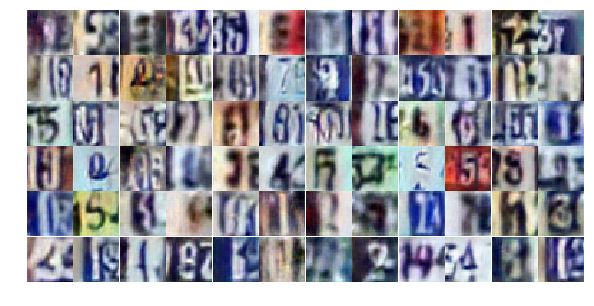

Epoch 16/25... Discriminator Loss: 0.4766... Generator Loss: 1.4001
Epoch 16/25... Discriminator Loss: 0.3497... Generator Loss: 1.7216
Epoch 16/25... Discriminator Loss: 0.4544... Generator Loss: 2.4432
Epoch 16/25... Discriminator Loss: 0.6643... Generator Loss: 0.9936
Epoch 16/25... Discriminator Loss: 0.4071... Generator Loss: 2.8472
Epoch 16/25... Discriminator Loss: 1.2088... Generator Loss: 0.4809
Epoch 16/25... Discriminator Loss: 5.5785... Generator Loss: 7.5413
Epoch 16/25... Discriminator Loss: 1.7916... Generator Loss: 1.4356
Epoch 16/25... Discriminator Loss: 1.8047... Generator Loss: 0.4360
Epoch 16/25... Discriminator Loss: 0.9147... Generator Loss: 0.8583


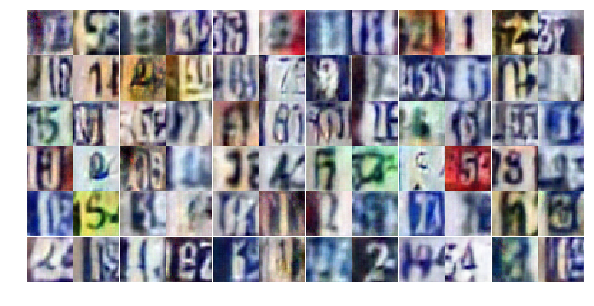

Epoch 16/25... Discriminator Loss: 1.2876... Generator Loss: 0.5277
Epoch 16/25... Discriminator Loss: 0.5184... Generator Loss: 1.2533
Epoch 16/25... Discriminator Loss: 0.5264... Generator Loss: 1.2859
Epoch 16/25... Discriminator Loss: 0.8603... Generator Loss: 1.7218
Epoch 16/25... Discriminator Loss: 1.1794... Generator Loss: 0.5476
Epoch 16/25... Discriminator Loss: 1.0523... Generator Loss: 2.9913
Epoch 16/25... Discriminator Loss: 0.3431... Generator Loss: 1.7554
Epoch 16/25... Discriminator Loss: 1.2776... Generator Loss: 0.4526
Epoch 16/25... Discriminator Loss: 0.3614... Generator Loss: 1.7312
Epoch 16/25... Discriminator Loss: 0.3309... Generator Loss: 1.9213


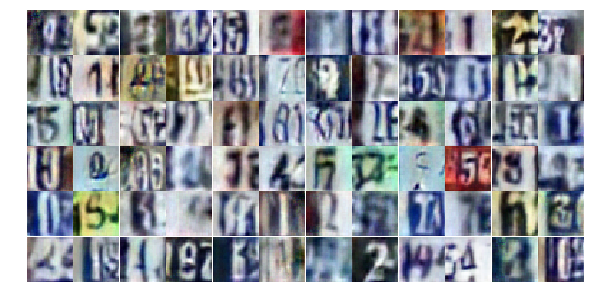

Epoch 16/25... Discriminator Loss: 0.3806... Generator Loss: 1.7958
Epoch 16/25... Discriminator Loss: 0.4919... Generator Loss: 1.5652
Epoch 16/25... Discriminator Loss: 0.8211... Generator Loss: 0.7726
Epoch 16/25... Discriminator Loss: 0.5389... Generator Loss: 1.7678
Epoch 16/25... Discriminator Loss: 0.8056... Generator Loss: 0.8595
Epoch 16/25... Discriminator Loss: 0.7345... Generator Loss: 0.9118
Epoch 16/25... Discriminator Loss: 0.2773... Generator Loss: 2.1679
Epoch 16/25... Discriminator Loss: 1.1708... Generator Loss: 0.4936
Epoch 16/25... Discriminator Loss: 0.5946... Generator Loss: 1.0118
Epoch 16/25... Discriminator Loss: 0.3782... Generator Loss: 1.4930


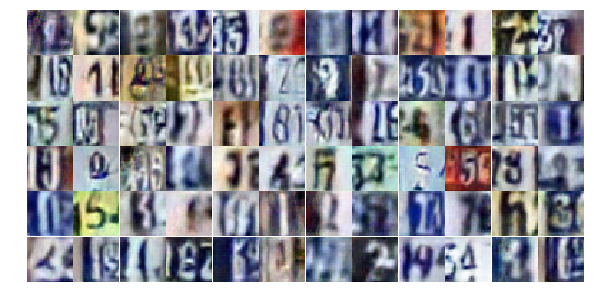

Epoch 16/25... Discriminator Loss: 1.3501... Generator Loss: 0.4606
Epoch 16/25... Discriminator Loss: 0.7802... Generator Loss: 0.8564
Epoch 16/25... Discriminator Loss: 1.0493... Generator Loss: 0.6773
Epoch 16/25... Discriminator Loss: 0.4485... Generator Loss: 1.7513
Epoch 16/25... Discriminator Loss: 0.0864... Generator Loss: 5.2780
Epoch 16/25... Discriminator Loss: 0.9583... Generator Loss: 3.1972
Epoch 17/25... Discriminator Loss: 0.7280... Generator Loss: 1.4179
Epoch 17/25... Discriminator Loss: 1.0373... Generator Loss: 0.7018
Epoch 17/25... Discriminator Loss: 0.4124... Generator Loss: 1.5594
Epoch 17/25... Discriminator Loss: 0.3080... Generator Loss: 2.1563


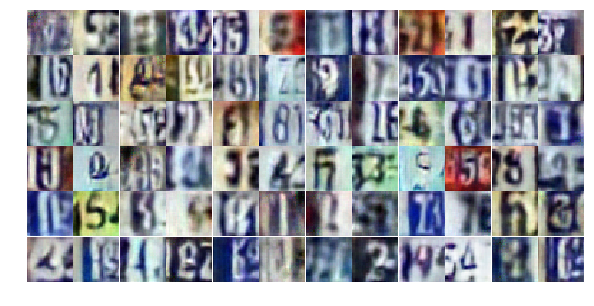

Epoch 17/25... Discriminator Loss: 0.3857... Generator Loss: 1.7381
Epoch 17/25... Discriminator Loss: 0.5335... Generator Loss: 1.2907
Epoch 17/25... Discriminator Loss: 0.4930... Generator Loss: 1.4512
Epoch 17/25... Discriminator Loss: 0.6133... Generator Loss: 1.0886
Epoch 17/25... Discriminator Loss: 1.1200... Generator Loss: 0.6992
Epoch 17/25... Discriminator Loss: 0.9026... Generator Loss: 0.8112
Epoch 17/25... Discriminator Loss: 0.6901... Generator Loss: 1.0632
Epoch 17/25... Discriminator Loss: 0.3628... Generator Loss: 1.8543
Epoch 17/25... Discriminator Loss: 0.3675... Generator Loss: 1.7075
Epoch 17/25... Discriminator Loss: 0.3289... Generator Loss: 1.9403


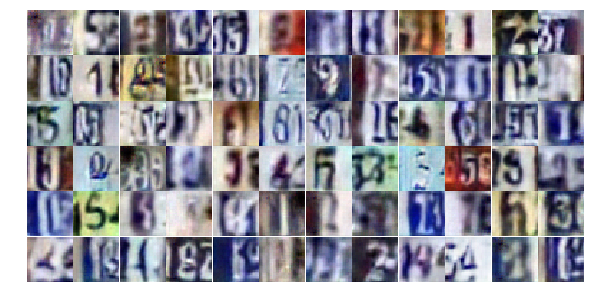

Epoch 17/25... Discriminator Loss: 0.7335... Generator Loss: 1.0409
Epoch 17/25... Discriminator Loss: 0.5659... Generator Loss: 2.2629
Epoch 17/25... Discriminator Loss: 0.5288... Generator Loss: 1.1566
Epoch 17/25... Discriminator Loss: 0.8032... Generator Loss: 1.0268
Epoch 17/25... Discriminator Loss: 0.4928... Generator Loss: 2.0012
Epoch 17/25... Discriminator Loss: 1.3817... Generator Loss: 0.4007
Epoch 17/25... Discriminator Loss: 0.7310... Generator Loss: 0.9838
Epoch 17/25... Discriminator Loss: 0.1344... Generator Loss: 2.8494
Epoch 17/25... Discriminator Loss: 0.3801... Generator Loss: 1.6120
Epoch 17/25... Discriminator Loss: 0.0825... Generator Loss: 3.4929


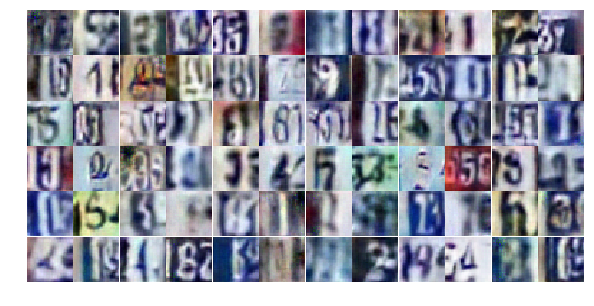

Epoch 17/25... Discriminator Loss: 1.6076... Generator Loss: 0.3009
Epoch 17/25... Discriminator Loss: 0.1579... Generator Loss: 3.3195
Epoch 17/25... Discriminator Loss: 0.4003... Generator Loss: 1.5200
Epoch 17/25... Discriminator Loss: 0.2637... Generator Loss: 2.0964
Epoch 17/25... Discriminator Loss: 0.2389... Generator Loss: 2.0299
Epoch 17/25... Discriminator Loss: 0.3223... Generator Loss: 1.9745
Epoch 17/25... Discriminator Loss: 0.4222... Generator Loss: 1.5097
Epoch 17/25... Discriminator Loss: 0.2099... Generator Loss: 2.7634
Epoch 17/25... Discriminator Loss: 1.3440... Generator Loss: 0.4468
Epoch 17/25... Discriminator Loss: 0.1416... Generator Loss: 4.0113


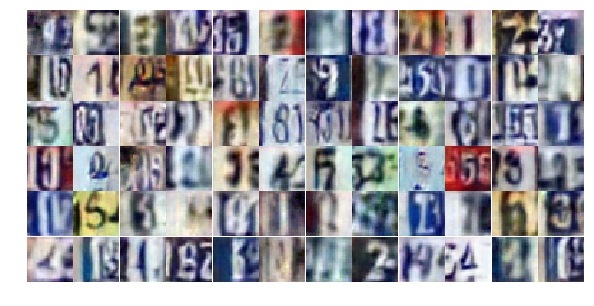

Epoch 17/25... Discriminator Loss: 2.0904... Generator Loss: 0.2534
Epoch 17/25... Discriminator Loss: 0.5619... Generator Loss: 1.1713
Epoch 17/25... Discriminator Loss: 0.3860... Generator Loss: 1.9338
Epoch 17/25... Discriminator Loss: 0.5318... Generator Loss: 3.0966
Epoch 17/25... Discriminator Loss: 0.6994... Generator Loss: 0.9779
Epoch 17/25... Discriminator Loss: 0.5069... Generator Loss: 1.2478
Epoch 17/25... Discriminator Loss: 1.0030... Generator Loss: 0.5999
Epoch 17/25... Discriminator Loss: 0.3801... Generator Loss: 1.6088
Epoch 17/25... Discriminator Loss: 0.0946... Generator Loss: 3.6088
Epoch 17/25... Discriminator Loss: 0.2061... Generator Loss: 2.1696


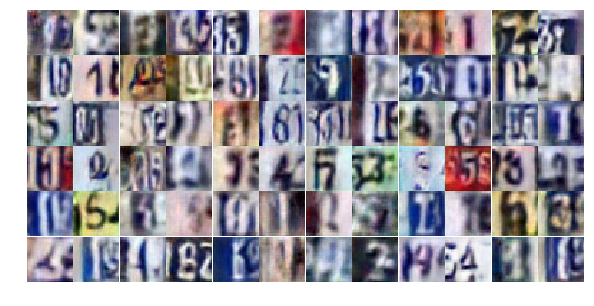

Epoch 17/25... Discriminator Loss: 1.5630... Generator Loss: 2.9263
Epoch 17/25... Discriminator Loss: 0.4981... Generator Loss: 2.7822
Epoch 17/25... Discriminator Loss: 2.5491... Generator Loss: 0.1317
Epoch 17/25... Discriminator Loss: 0.9652... Generator Loss: 1.7629
Epoch 17/25... Discriminator Loss: 0.8609... Generator Loss: 0.9456
Epoch 17/25... Discriminator Loss: 0.8369... Generator Loss: 1.6529
Epoch 17/25... Discriminator Loss: 0.9436... Generator Loss: 0.7220
Epoch 17/25... Discriminator Loss: 0.7341... Generator Loss: 0.9107
Epoch 17/25... Discriminator Loss: 0.8128... Generator Loss: 0.8397
Epoch 17/25... Discriminator Loss: 0.7201... Generator Loss: 1.0453


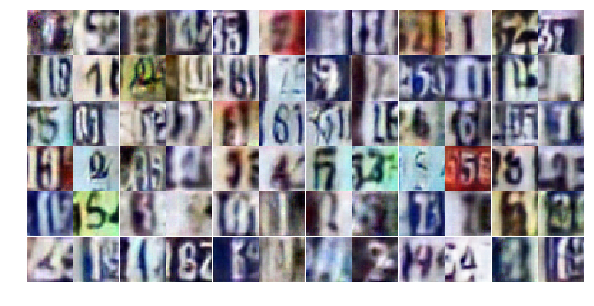

Epoch 17/25... Discriminator Loss: 0.3734... Generator Loss: 2.7667
Epoch 17/25... Discriminator Loss: 0.7009... Generator Loss: 0.9392
Epoch 17/25... Discriminator Loss: 0.4853... Generator Loss: 1.3452
Epoch 17/25... Discriminator Loss: 0.6311... Generator Loss: 1.1301
Epoch 18/25... Discriminator Loss: 0.6053... Generator Loss: 1.0944
Epoch 18/25... Discriminator Loss: 0.5885... Generator Loss: 1.1477
Epoch 18/25... Discriminator Loss: 0.2889... Generator Loss: 3.3007
Epoch 18/25... Discriminator Loss: 0.5901... Generator Loss: 1.1712
Epoch 18/25... Discriminator Loss: 0.5543... Generator Loss: 1.2600
Epoch 18/25... Discriminator Loss: 0.4718... Generator Loss: 1.5035


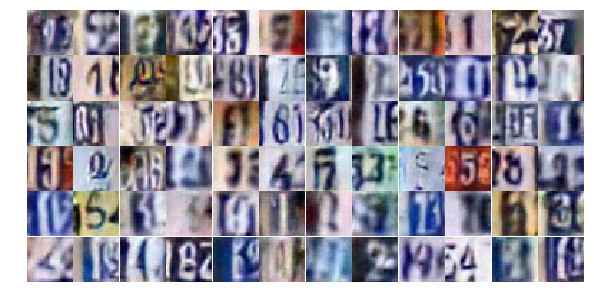

Epoch 18/25... Discriminator Loss: 0.4630... Generator Loss: 5.3341
Epoch 18/25... Discriminator Loss: 0.2741... Generator Loss: 2.3797
Epoch 18/25... Discriminator Loss: 0.6227... Generator Loss: 1.0455
Epoch 18/25... Discriminator Loss: 0.5458... Generator Loss: 4.4840
Epoch 18/25... Discriminator Loss: 0.3591... Generator Loss: 1.5759
Epoch 18/25... Discriminator Loss: 0.8214... Generator Loss: 0.8267
Epoch 18/25... Discriminator Loss: 0.5236... Generator Loss: 1.2595
Epoch 18/25... Discriminator Loss: 1.0169... Generator Loss: 0.6344
Epoch 18/25... Discriminator Loss: 0.5365... Generator Loss: 1.2199
Epoch 18/25... Discriminator Loss: 0.2978... Generator Loss: 2.0679


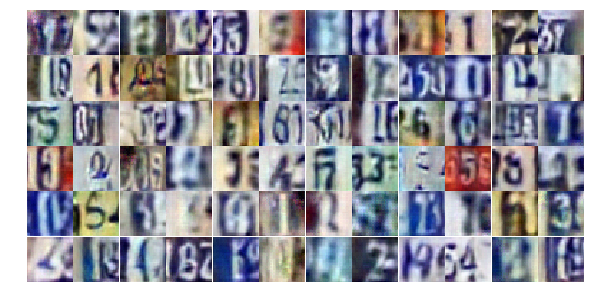

Epoch 18/25... Discriminator Loss: 1.0824... Generator Loss: 0.6048
Epoch 18/25... Discriminator Loss: 0.2687... Generator Loss: 2.4615
Epoch 18/25... Discriminator Loss: 0.5128... Generator Loss: 1.2904
Epoch 18/25... Discriminator Loss: 0.4521... Generator Loss: 1.5519
Epoch 18/25... Discriminator Loss: 0.4225... Generator Loss: 1.4732
Epoch 18/25... Discriminator Loss: 0.5949... Generator Loss: 1.4261
Epoch 18/25... Discriminator Loss: 2.9037... Generator Loss: 0.1487
Epoch 18/25... Discriminator Loss: 1.3726... Generator Loss: 1.8383
Epoch 18/25... Discriminator Loss: 1.0402... Generator Loss: 1.2635
Epoch 18/25... Discriminator Loss: 1.1235... Generator Loss: 0.7464


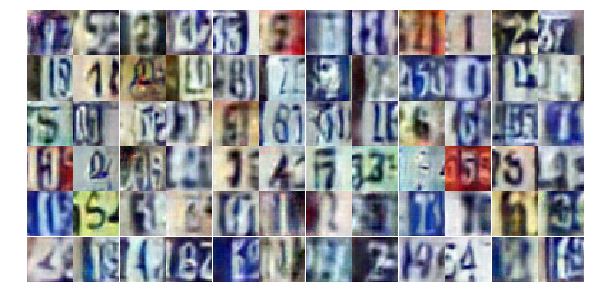

Epoch 18/25... Discriminator Loss: 0.4443... Generator Loss: 2.0060
Epoch 18/25... Discriminator Loss: 0.7580... Generator Loss: 1.2004
Epoch 18/25... Discriminator Loss: 0.7833... Generator Loss: 0.9432
Epoch 18/25... Discriminator Loss: 0.9806... Generator Loss: 0.8414
Epoch 18/25... Discriminator Loss: 0.9268... Generator Loss: 0.7041
Epoch 18/25... Discriminator Loss: 0.6020... Generator Loss: 1.1872
Epoch 18/25... Discriminator Loss: 0.1212... Generator Loss: 5.8369
Epoch 18/25... Discriminator Loss: 0.3437... Generator Loss: 2.5601
Epoch 18/25... Discriminator Loss: 0.2993... Generator Loss: 1.8877
Epoch 18/25... Discriminator Loss: 0.7348... Generator Loss: 0.8727


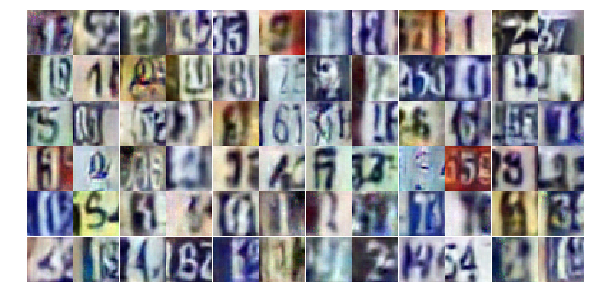

Epoch 18/25... Discriminator Loss: 0.5462... Generator Loss: 1.4691
Epoch 18/25... Discriminator Loss: 0.4515... Generator Loss: 1.6964
Epoch 18/25... Discriminator Loss: 0.6461... Generator Loss: 0.9862
Epoch 18/25... Discriminator Loss: 0.3314... Generator Loss: 1.6860
Epoch 18/25... Discriminator Loss: 0.3261... Generator Loss: 1.9187
Epoch 18/25... Discriminator Loss: 0.3265... Generator Loss: 1.7917
Epoch 18/25... Discriminator Loss: 0.4003... Generator Loss: 1.4915
Epoch 18/25... Discriminator Loss: 0.7875... Generator Loss: 1.4748
Epoch 18/25... Discriminator Loss: 0.3547... Generator Loss: 1.7654
Epoch 18/25... Discriminator Loss: 0.3838... Generator Loss: 2.6125


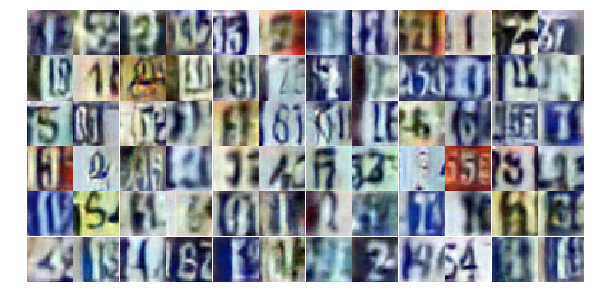

Epoch 18/25... Discriminator Loss: 0.7302... Generator Loss: 1.3035
Epoch 18/25... Discriminator Loss: 0.9225... Generator Loss: 0.6676
Epoch 18/25... Discriminator Loss: 0.5605... Generator Loss: 1.1768
Epoch 18/25... Discriminator Loss: 0.8099... Generator Loss: 0.8293
Epoch 18/25... Discriminator Loss: 0.5820... Generator Loss: 1.2123
Epoch 18/25... Discriminator Loss: 0.5409... Generator Loss: 1.2736
Epoch 18/25... Discriminator Loss: 0.5986... Generator Loss: 1.0988
Epoch 18/25... Discriminator Loss: 0.3110... Generator Loss: 2.2016
Epoch 18/25... Discriminator Loss: 0.5133... Generator Loss: 1.7047
Epoch 18/25... Discriminator Loss: 0.9840... Generator Loss: 0.6164


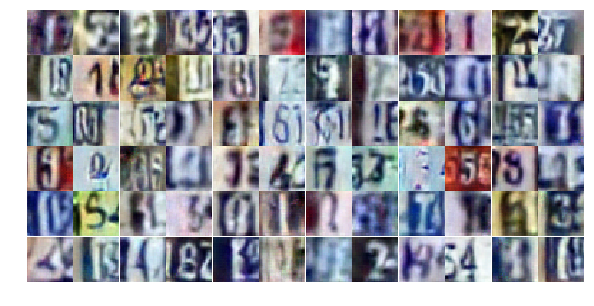

Epoch 18/25... Discriminator Loss: 0.3911... Generator Loss: 1.4627
Epoch 19/25... Discriminator Loss: 0.9290... Generator Loss: 0.7222
Epoch 19/25... Discriminator Loss: 0.2872... Generator Loss: 1.9460
Epoch 19/25... Discriminator Loss: 0.7229... Generator Loss: 0.9678
Epoch 19/25... Discriminator Loss: 0.4767... Generator Loss: 1.3244
Epoch 19/25... Discriminator Loss: 0.4818... Generator Loss: 2.3891
Epoch 19/25... Discriminator Loss: 0.6695... Generator Loss: 1.1249
Epoch 19/25... Discriminator Loss: 0.6692... Generator Loss: 0.9431
Epoch 19/25... Discriminator Loss: 0.6087... Generator Loss: 1.3053
Epoch 19/25... Discriminator Loss: 0.3198... Generator Loss: 1.9185


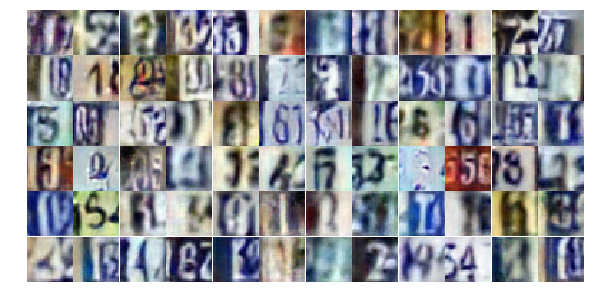

Epoch 19/25... Discriminator Loss: 0.6940... Generator Loss: 0.9474
Epoch 19/25... Discriminator Loss: 0.5300... Generator Loss: 1.2365
Epoch 19/25... Discriminator Loss: 0.2762... Generator Loss: 2.0210
Epoch 19/25... Discriminator Loss: 0.3391... Generator Loss: 1.6430
Epoch 19/25... Discriminator Loss: 0.7866... Generator Loss: 0.7901
Epoch 19/25... Discriminator Loss: 0.3772... Generator Loss: 1.8116
Epoch 19/25... Discriminator Loss: 0.7038... Generator Loss: 0.8904
Epoch 19/25... Discriminator Loss: 0.6222... Generator Loss: 1.0872
Epoch 19/25... Discriminator Loss: 1.0244... Generator Loss: 0.6774
Epoch 19/25... Discriminator Loss: 1.1926... Generator Loss: 0.5706


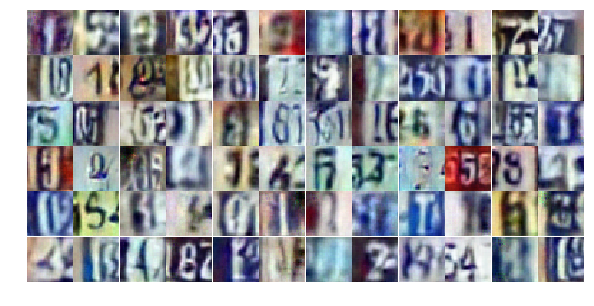

Epoch 19/25... Discriminator Loss: 0.3924... Generator Loss: 1.6184
Epoch 19/25... Discriminator Loss: 0.1343... Generator Loss: 2.9763
Epoch 19/25... Discriminator Loss: 1.0329... Generator Loss: 0.6025
Epoch 19/25... Discriminator Loss: 0.4657... Generator Loss: 1.4520
Epoch 19/25... Discriminator Loss: 1.3509... Generator Loss: 0.3815
Epoch 19/25... Discriminator Loss: 0.5093... Generator Loss: 1.5090
Epoch 19/25... Discriminator Loss: 0.6823... Generator Loss: 1.0042
Epoch 19/25... Discriminator Loss: 0.4653... Generator Loss: 1.5252
Epoch 19/25... Discriminator Loss: 0.4449... Generator Loss: 1.4398
Epoch 19/25... Discriminator Loss: 1.5669... Generator Loss: 0.3384


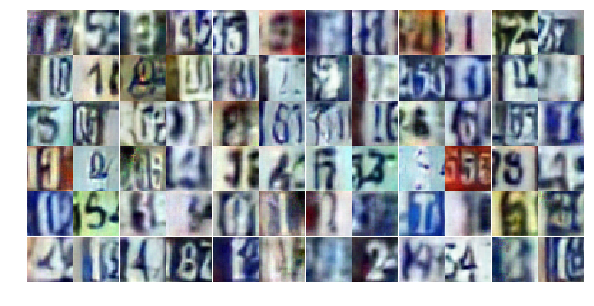

Epoch 19/25... Discriminator Loss: 0.5253... Generator Loss: 1.5738
Epoch 19/25... Discriminator Loss: 0.5451... Generator Loss: 1.2113
Epoch 19/25... Discriminator Loss: 0.9854... Generator Loss: 0.6735
Epoch 19/25... Discriminator Loss: 0.4663... Generator Loss: 1.3359
Epoch 19/25... Discriminator Loss: 0.1661... Generator Loss: 2.7359
Epoch 19/25... Discriminator Loss: 0.9627... Generator Loss: 0.9541
Epoch 19/25... Discriminator Loss: 0.5156... Generator Loss: 2.1234
Epoch 19/25... Discriminator Loss: 0.4404... Generator Loss: 1.5280
Epoch 19/25... Discriminator Loss: 0.9886... Generator Loss: 2.7442
Epoch 19/25... Discriminator Loss: 0.4292... Generator Loss: 1.7805


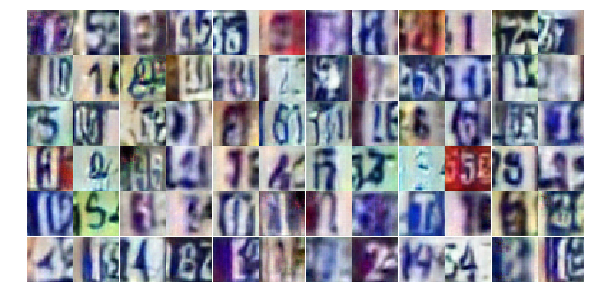

Epoch 19/25... Discriminator Loss: 0.8263... Generator Loss: 0.8430
Epoch 19/25... Discriminator Loss: 0.2670... Generator Loss: 2.2041
Epoch 19/25... Discriminator Loss: 0.7529... Generator Loss: 0.8539
Epoch 19/25... Discriminator Loss: 0.3983... Generator Loss: 1.6093
Epoch 19/25... Discriminator Loss: 0.3018... Generator Loss: 1.7839
Epoch 19/25... Discriminator Loss: 0.5406... Generator Loss: 1.3123
Epoch 19/25... Discriminator Loss: 0.4905... Generator Loss: 2.0320
Epoch 19/25... Discriminator Loss: 0.2813... Generator Loss: 2.1138
Epoch 19/25... Discriminator Loss: 0.8420... Generator Loss: 0.8409
Epoch 19/25... Discriminator Loss: 0.6822... Generator Loss: 0.9899


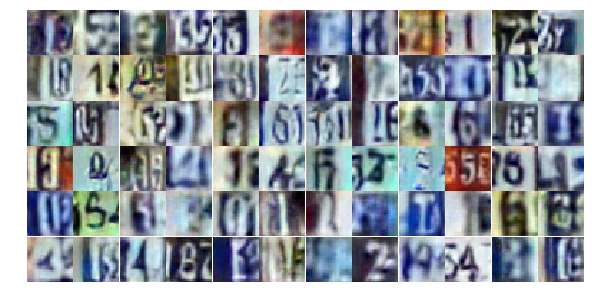

Epoch 19/25... Discriminator Loss: 0.4397... Generator Loss: 1.4119
Epoch 19/25... Discriminator Loss: 0.2150... Generator Loss: 2.2120
Epoch 19/25... Discriminator Loss: 0.3736... Generator Loss: 1.9332
Epoch 19/25... Discriminator Loss: 0.4722... Generator Loss: 1.5055
Epoch 19/25... Discriminator Loss: 0.9871... Generator Loss: 0.7389
Epoch 19/25... Discriminator Loss: 0.6871... Generator Loss: 0.9714
Epoch 19/25... Discriminator Loss: 2.4634... Generator Loss: 0.1615
Epoch 19/25... Discriminator Loss: 1.0097... Generator Loss: 2.0111
Epoch 20/25... Discriminator Loss: 1.1456... Generator Loss: 0.7322
Epoch 20/25... Discriminator Loss: 1.0134... Generator Loss: 0.6631


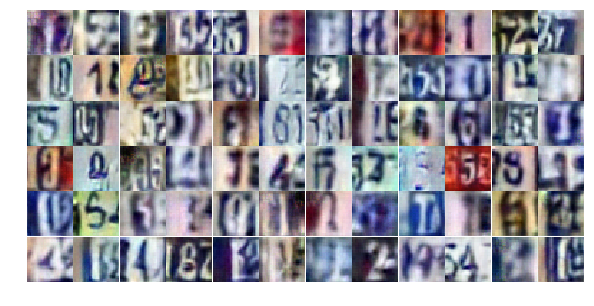

Epoch 20/25... Discriminator Loss: 0.2870... Generator Loss: 1.9315
Epoch 20/25... Discriminator Loss: 0.6392... Generator Loss: 1.0954
Epoch 20/25... Discriminator Loss: 1.1550... Generator Loss: 0.5691
Epoch 20/25... Discriminator Loss: 1.2135... Generator Loss: 0.4560
Epoch 20/25... Discriminator Loss: 0.4877... Generator Loss: 2.3755
Epoch 20/25... Discriminator Loss: 0.6186... Generator Loss: 1.5980
Epoch 20/25... Discriminator Loss: 0.3060... Generator Loss: 2.3145
Epoch 20/25... Discriminator Loss: 0.4980... Generator Loss: 1.5832
Epoch 20/25... Discriminator Loss: 1.1301... Generator Loss: 0.5396
Epoch 20/25... Discriminator Loss: 0.5879... Generator Loss: 1.0767


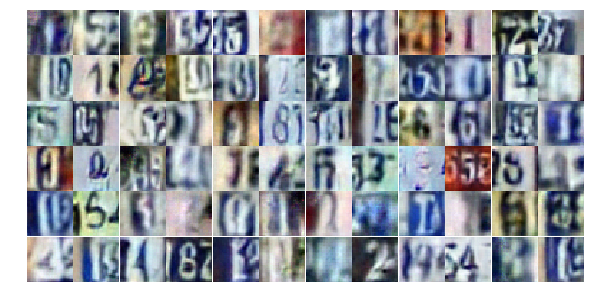

Epoch 20/25... Discriminator Loss: 1.0310... Generator Loss: 0.7366
Epoch 20/25... Discriminator Loss: 1.6200... Generator Loss: 0.3706
Epoch 20/25... Discriminator Loss: 1.1444... Generator Loss: 0.5519
Epoch 20/25... Discriminator Loss: 0.6981... Generator Loss: 1.0630
Epoch 20/25... Discriminator Loss: 0.8972... Generator Loss: 0.7932
Epoch 20/25... Discriminator Loss: 1.2747... Generator Loss: 0.5823
Epoch 20/25... Discriminator Loss: 0.7739... Generator Loss: 0.8938
Epoch 20/25... Discriminator Loss: 0.7826... Generator Loss: 0.8580
Epoch 20/25... Discriminator Loss: 0.3132... Generator Loss: 1.8970
Epoch 20/25... Discriminator Loss: 0.8867... Generator Loss: 0.8022


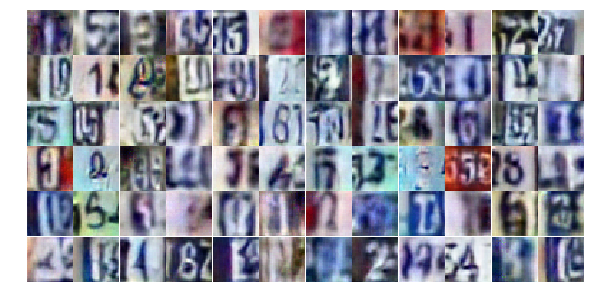

Epoch 20/25... Discriminator Loss: 0.5413... Generator Loss: 1.5013
Epoch 20/25... Discriminator Loss: 0.4201... Generator Loss: 1.5518
Epoch 20/25... Discriminator Loss: 0.5572... Generator Loss: 1.1405
Epoch 20/25... Discriminator Loss: 0.7645... Generator Loss: 0.9280
Epoch 20/25... Discriminator Loss: 0.5758... Generator Loss: 1.1800
Epoch 20/25... Discriminator Loss: 0.5397... Generator Loss: 1.1446
Epoch 20/25... Discriminator Loss: 0.8422... Generator Loss: 0.8843
Epoch 20/25... Discriminator Loss: 1.5414... Generator Loss: 0.3603
Epoch 20/25... Discriminator Loss: 0.7262... Generator Loss: 1.2224
Epoch 20/25... Discriminator Loss: 0.3196... Generator Loss: 1.6572


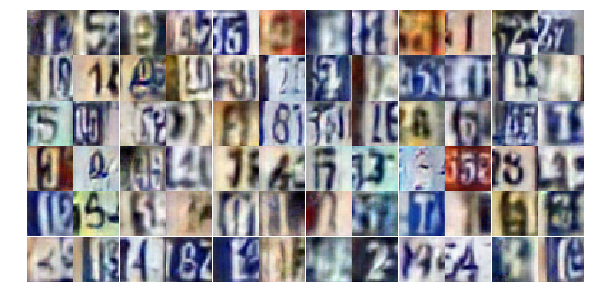

Epoch 20/25... Discriminator Loss: 0.5619... Generator Loss: 1.4282
Epoch 20/25... Discriminator Loss: 0.2246... Generator Loss: 2.2254
Epoch 20/25... Discriminator Loss: 1.4584... Generator Loss: 0.4818
Epoch 20/25... Discriminator Loss: 0.7701... Generator Loss: 0.7939
Epoch 20/25... Discriminator Loss: 0.3849... Generator Loss: 1.7414
Epoch 20/25... Discriminator Loss: 0.5263... Generator Loss: 1.2676
Epoch 20/25... Discriminator Loss: 0.7192... Generator Loss: 1.0468
Epoch 20/25... Discriminator Loss: 0.2724... Generator Loss: 1.8916
Epoch 20/25... Discriminator Loss: 0.4546... Generator Loss: 1.6509
Epoch 20/25... Discriminator Loss: 1.1063... Generator Loss: 0.6141


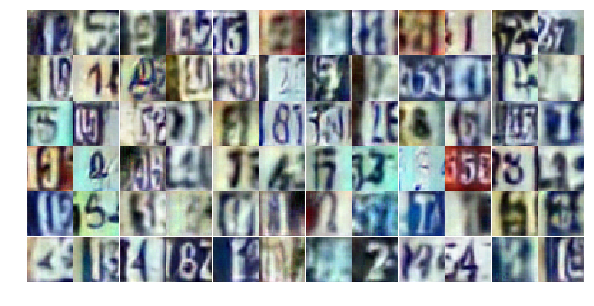

Epoch 20/25... Discriminator Loss: 1.1455... Generator Loss: 0.5771
Epoch 20/25... Discriminator Loss: 1.5794... Generator Loss: 0.3601
Epoch 20/25... Discriminator Loss: 1.9139... Generator Loss: 3.8237
Epoch 20/25... Discriminator Loss: 1.8331... Generator Loss: 0.6019
Epoch 20/25... Discriminator Loss: 1.5199... Generator Loss: 1.6623
Epoch 20/25... Discriminator Loss: 0.9301... Generator Loss: 1.2422
Epoch 20/25... Discriminator Loss: 0.7408... Generator Loss: 1.4627
Epoch 20/25... Discriminator Loss: 0.6099... Generator Loss: 1.3466
Epoch 20/25... Discriminator Loss: 0.9008... Generator Loss: 1.1831
Epoch 20/25... Discriminator Loss: 1.0551... Generator Loss: 0.6319


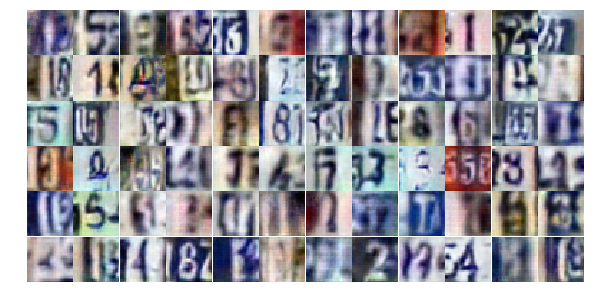

Epoch 20/25... Discriminator Loss: 0.5238... Generator Loss: 2.1576
Epoch 20/25... Discriminator Loss: 0.2993... Generator Loss: 2.0745
Epoch 20/25... Discriminator Loss: 0.6936... Generator Loss: 1.0712
Epoch 20/25... Discriminator Loss: 0.4840... Generator Loss: 2.9050
Epoch 20/25... Discriminator Loss: 0.2837... Generator Loss: 2.1716
Epoch 20/25... Discriminator Loss: 0.2432... Generator Loss: 2.1088
Epoch 21/25... Discriminator Loss: 0.7317... Generator Loss: 0.9931
Epoch 21/25... Discriminator Loss: 0.5370... Generator Loss: 1.4612
Epoch 21/25... Discriminator Loss: 0.9532... Generator Loss: 0.6497
Epoch 21/25... Discriminator Loss: 1.0148... Generator Loss: 0.6281


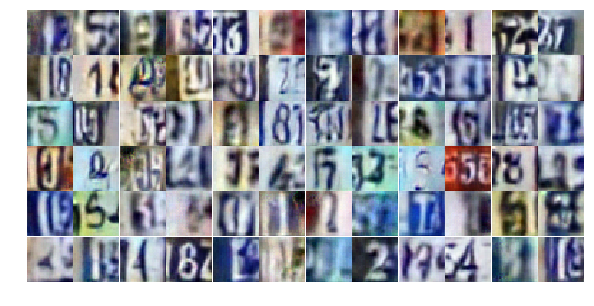

Epoch 21/25... Discriminator Loss: 0.6427... Generator Loss: 1.0806
Epoch 21/25... Discriminator Loss: 1.9864... Generator Loss: 0.2801
Epoch 21/25... Discriminator Loss: 0.3197... Generator Loss: 2.4634
Epoch 21/25... Discriminator Loss: 0.3138... Generator Loss: 2.0765
Epoch 21/25... Discriminator Loss: 0.4937... Generator Loss: 1.3436
Epoch 21/25... Discriminator Loss: 0.2580... Generator Loss: 2.1495
Epoch 21/25... Discriminator Loss: 0.6611... Generator Loss: 1.0670
Epoch 21/25... Discriminator Loss: 0.6027... Generator Loss: 1.1449
Epoch 21/25... Discriminator Loss: 0.3761... Generator Loss: 1.6062
Epoch 21/25... Discriminator Loss: 0.9694... Generator Loss: 0.7120


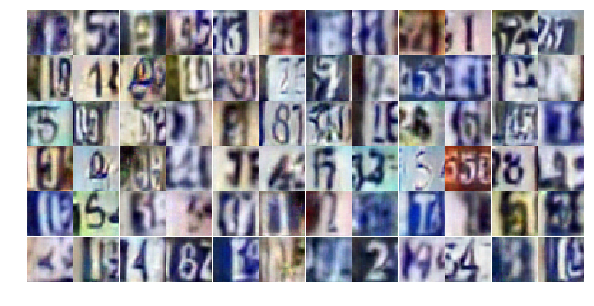

Epoch 21/25... Discriminator Loss: 0.3529... Generator Loss: 2.2224
Epoch 21/25... Discriminator Loss: 1.2570... Generator Loss: 0.5229
Epoch 21/25... Discriminator Loss: 1.8779... Generator Loss: 0.2790
Epoch 21/25... Discriminator Loss: 0.4236... Generator Loss: 1.5453
Epoch 21/25... Discriminator Loss: 0.2474... Generator Loss: 1.8839
Epoch 21/25... Discriminator Loss: 0.2934... Generator Loss: 1.8619
Epoch 21/25... Discriminator Loss: 0.2890... Generator Loss: 2.0678
Epoch 21/25... Discriminator Loss: 0.0989... Generator Loss: 5.3783
Epoch 21/25... Discriminator Loss: 0.4216... Generator Loss: 1.5235
Epoch 21/25... Discriminator Loss: 0.3830... Generator Loss: 1.7993


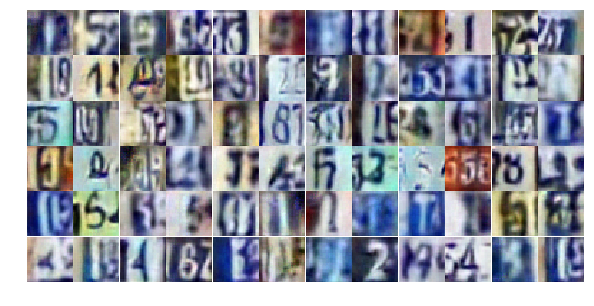

Epoch 21/25... Discriminator Loss: 1.1518... Generator Loss: 0.5124
Epoch 21/25... Discriminator Loss: 0.3831... Generator Loss: 1.9275
Epoch 21/25... Discriminator Loss: 1.9128... Generator Loss: 0.2342
Epoch 21/25... Discriminator Loss: 1.3366... Generator Loss: 0.4529
Epoch 21/25... Discriminator Loss: 0.5033... Generator Loss: 1.3253
Epoch 21/25... Discriminator Loss: 0.6233... Generator Loss: 1.0986
Epoch 21/25... Discriminator Loss: 0.4361... Generator Loss: 1.5023
Epoch 21/25... Discriminator Loss: 0.5187... Generator Loss: 1.3428
Epoch 21/25... Discriminator Loss: 1.1153... Generator Loss: 0.5796
Epoch 21/25... Discriminator Loss: 1.9457... Generator Loss: 0.2372


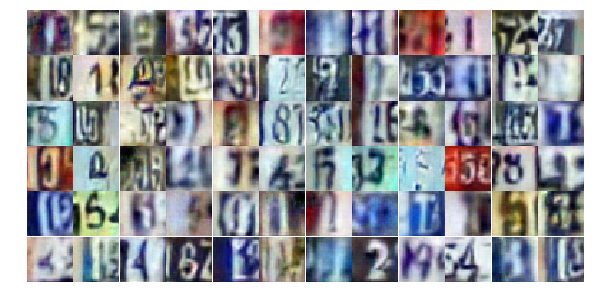

Epoch 21/25... Discriminator Loss: 1.4317... Generator Loss: 0.4631
Epoch 21/25... Discriminator Loss: 0.4351... Generator Loss: 1.4959
Epoch 21/25... Discriminator Loss: 0.5046... Generator Loss: 1.7728
Epoch 21/25... Discriminator Loss: 0.6272... Generator Loss: 1.0227
Epoch 21/25... Discriminator Loss: 0.3859... Generator Loss: 1.5170
Epoch 21/25... Discriminator Loss: 0.5236... Generator Loss: 1.4656
Epoch 21/25... Discriminator Loss: 0.9502... Generator Loss: 0.6883
Epoch 21/25... Discriminator Loss: 1.0493... Generator Loss: 0.6967
Epoch 21/25... Discriminator Loss: 0.4094... Generator Loss: 1.5457
Epoch 21/25... Discriminator Loss: 0.2591... Generator Loss: 2.6081


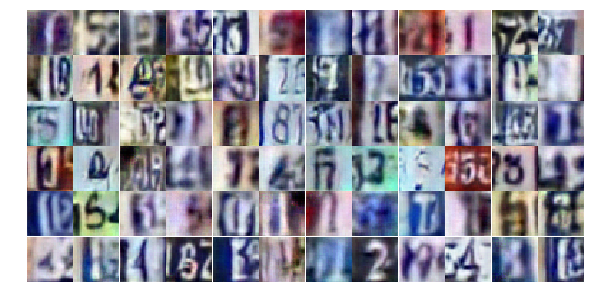

Epoch 21/25... Discriminator Loss: 0.6315... Generator Loss: 1.2415
Epoch 21/25... Discriminator Loss: 2.1736... Generator Loss: 0.2955
Epoch 21/25... Discriminator Loss: 0.5452... Generator Loss: 1.1332
Epoch 21/25... Discriminator Loss: 0.4905... Generator Loss: 1.3350
Epoch 21/25... Discriminator Loss: 0.2698... Generator Loss: 2.0460
Epoch 21/25... Discriminator Loss: 0.4323... Generator Loss: 1.4573
Epoch 21/25... Discriminator Loss: 0.8294... Generator Loss: 0.8333
Epoch 21/25... Discriminator Loss: 0.8598... Generator Loss: 0.8644
Epoch 21/25... Discriminator Loss: 0.5601... Generator Loss: 1.7007
Epoch 21/25... Discriminator Loss: 0.6013... Generator Loss: 1.0851


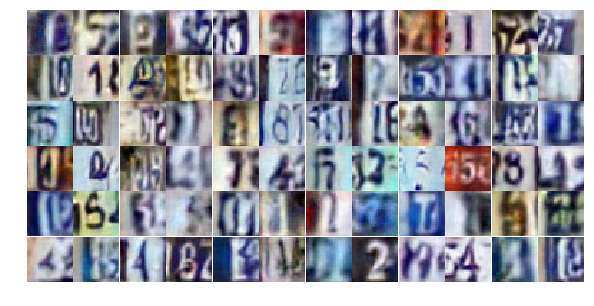

Epoch 21/25... Discriminator Loss: 0.3394... Generator Loss: 1.6754
Epoch 21/25... Discriminator Loss: 0.5398... Generator Loss: 1.2411
Epoch 21/25... Discriminator Loss: 1.1515... Generator Loss: 0.6050
Epoch 22/25... Discriminator Loss: 0.1362... Generator Loss: 4.5603
Epoch 22/25... Discriminator Loss: 0.5859... Generator Loss: 1.1958
Epoch 22/25... Discriminator Loss: 0.4838... Generator Loss: 1.4374
Epoch 22/25... Discriminator Loss: 0.3766... Generator Loss: 1.7258
Epoch 22/25... Discriminator Loss: 0.0724... Generator Loss: 5.2472
Epoch 22/25... Discriminator Loss: 1.5003... Generator Loss: 0.3750
Epoch 22/25... Discriminator Loss: 1.3928... Generator Loss: 0.4650


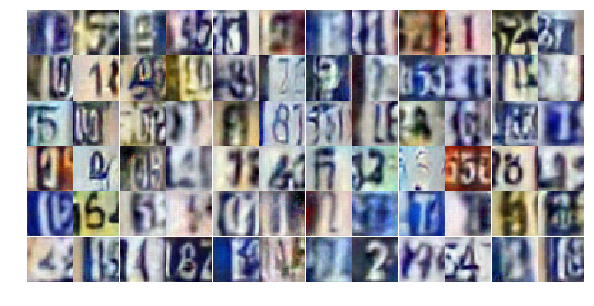

Epoch 22/25... Discriminator Loss: 0.4163... Generator Loss: 1.5042
Epoch 22/25... Discriminator Loss: 0.4564... Generator Loss: 1.4823
Epoch 22/25... Discriminator Loss: 1.6932... Generator Loss: 0.3453
Epoch 22/25... Discriminator Loss: 0.5749... Generator Loss: 1.6375
Epoch 22/25... Discriminator Loss: 0.1100... Generator Loss: 4.3284
Epoch 22/25... Discriminator Loss: 0.2739... Generator Loss: 2.1428
Epoch 22/25... Discriminator Loss: 0.4430... Generator Loss: 2.1970
Epoch 22/25... Discriminator Loss: 0.2570... Generator Loss: 2.1164
Epoch 22/25... Discriminator Loss: 0.5861... Generator Loss: 1.1730
Epoch 22/25... Discriminator Loss: 1.5983... Generator Loss: 0.3103


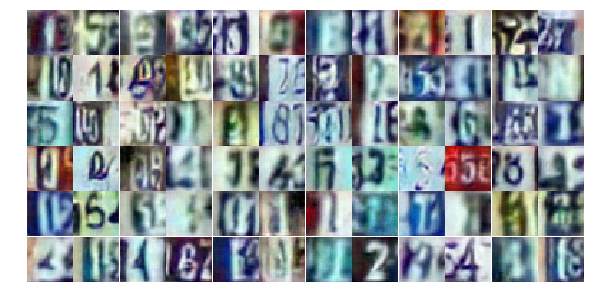

Epoch 22/25... Discriminator Loss: 0.4183... Generator Loss: 1.7921
Epoch 22/25... Discriminator Loss: 1.0971... Generator Loss: 2.5170
Epoch 22/25... Discriminator Loss: 0.6139... Generator Loss: 1.2972
Epoch 22/25... Discriminator Loss: 0.4734... Generator Loss: 1.2699
Epoch 22/25... Discriminator Loss: 0.4826... Generator Loss: 1.6030
Epoch 22/25... Discriminator Loss: 0.5696... Generator Loss: 1.0950
Epoch 22/25... Discriminator Loss: 0.4827... Generator Loss: 1.2357
Epoch 22/25... Discriminator Loss: 0.3033... Generator Loss: 1.9615
Epoch 22/25... Discriminator Loss: 0.3772... Generator Loss: 1.6693
Epoch 22/25... Discriminator Loss: 0.6179... Generator Loss: 1.1064


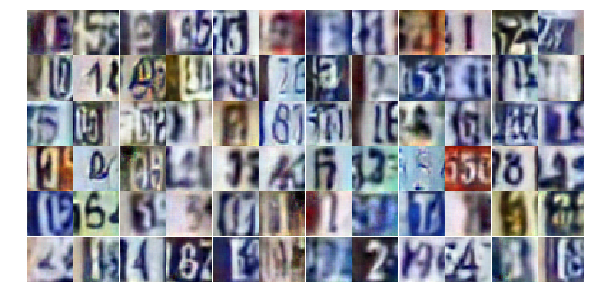

Epoch 22/25... Discriminator Loss: 0.2824... Generator Loss: 1.9706
Epoch 22/25... Discriminator Loss: 0.4666... Generator Loss: 3.2301
Epoch 22/25... Discriminator Loss: 1.3153... Generator Loss: 0.5931
Epoch 22/25... Discriminator Loss: 0.9419... Generator Loss: 0.7348
Epoch 22/25... Discriminator Loss: 0.1562... Generator Loss: 3.8491
Epoch 22/25... Discriminator Loss: 1.0812... Generator Loss: 0.6778
Epoch 22/25... Discriminator Loss: 1.6865... Generator Loss: 0.3495
Epoch 22/25... Discriminator Loss: 0.3952... Generator Loss: 2.1052
Epoch 22/25... Discriminator Loss: 0.2885... Generator Loss: 3.9269
Epoch 22/25... Discriminator Loss: 0.7068... Generator Loss: 0.9852


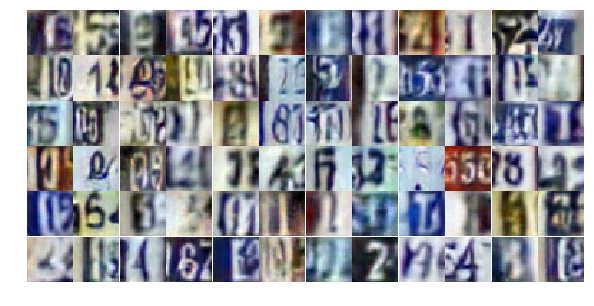

Epoch 22/25... Discriminator Loss: 0.3490... Generator Loss: 1.7481
Epoch 22/25... Discriminator Loss: 0.2089... Generator Loss: 2.2334
Epoch 22/25... Discriminator Loss: 0.4056... Generator Loss: 1.5769
Epoch 22/25... Discriminator Loss: 0.8287... Generator Loss: 0.8319
Epoch 22/25... Discriminator Loss: 0.3481... Generator Loss: 1.5745
Epoch 22/25... Discriminator Loss: 0.5058... Generator Loss: 1.2259
Epoch 22/25... Discriminator Loss: 0.4792... Generator Loss: 1.4080
Epoch 22/25... Discriminator Loss: 0.2636... Generator Loss: 2.0467
Epoch 22/25... Discriminator Loss: 0.3502... Generator Loss: 1.7443
Epoch 22/25... Discriminator Loss: 0.8420... Generator Loss: 1.2054


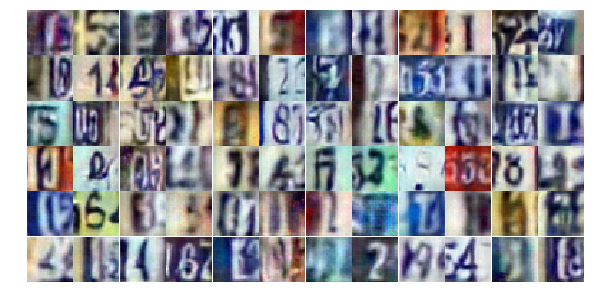

Epoch 22/25... Discriminator Loss: 0.7593... Generator Loss: 1.0222
Epoch 22/25... Discriminator Loss: 0.6161... Generator Loss: 1.7299
Epoch 22/25... Discriminator Loss: 0.5843... Generator Loss: 1.1103
Epoch 22/25... Discriminator Loss: 1.1750... Generator Loss: 0.5386
Epoch 22/25... Discriminator Loss: 1.3359... Generator Loss: 0.4381
Epoch 22/25... Discriminator Loss: 0.6090... Generator Loss: 1.9833
Epoch 22/25... Discriminator Loss: 1.9547... Generator Loss: 0.2229
Epoch 22/25... Discriminator Loss: 0.6830... Generator Loss: 1.0032
Epoch 22/25... Discriminator Loss: 0.9517... Generator Loss: 2.0840
Epoch 22/25... Discriminator Loss: 1.0400... Generator Loss: 0.6495


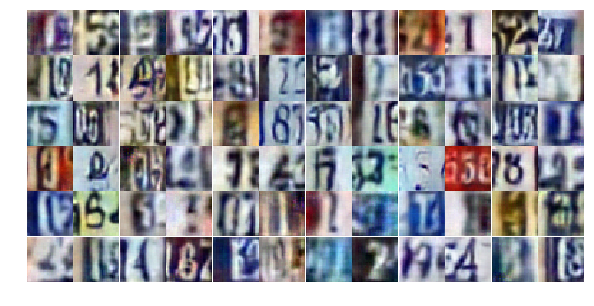

Epoch 23/25... Discriminator Loss: 0.6169... Generator Loss: 1.0199
Epoch 23/25... Discriminator Loss: 0.3778... Generator Loss: 1.6587
Epoch 23/25... Discriminator Loss: 0.2069... Generator Loss: 2.2898
Epoch 23/25... Discriminator Loss: 0.3340... Generator Loss: 1.8080
Epoch 23/25... Discriminator Loss: 0.3687... Generator Loss: 1.6378
Epoch 23/25... Discriminator Loss: 0.5942... Generator Loss: 2.1318
Epoch 23/25... Discriminator Loss: 0.4200... Generator Loss: 2.1462
Epoch 23/25... Discriminator Loss: 0.3660... Generator Loss: 2.0026
Epoch 23/25... Discriminator Loss: 0.3775... Generator Loss: 1.6466
Epoch 23/25... Discriminator Loss: 0.4241... Generator Loss: 1.6477


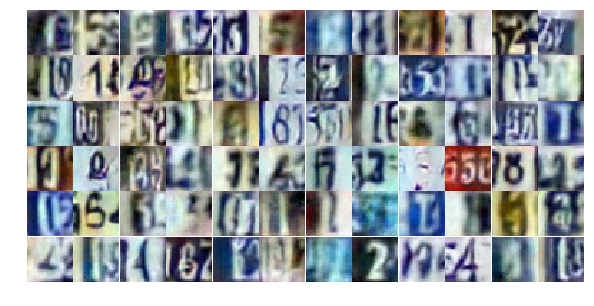

Epoch 23/25... Discriminator Loss: 0.9578... Generator Loss: 0.7034
Epoch 23/25... Discriminator Loss: 0.0695... Generator Loss: 3.7325
Epoch 23/25... Discriminator Loss: 0.2218... Generator Loss: 2.2393
Epoch 23/25... Discriminator Loss: 0.1946... Generator Loss: 2.5297
Epoch 23/25... Discriminator Loss: 0.4456... Generator Loss: 1.3661
Epoch 23/25... Discriminator Loss: 1.0198... Generator Loss: 0.6837
Epoch 23/25... Discriminator Loss: 0.7297... Generator Loss: 0.9658
Epoch 23/25... Discriminator Loss: 0.6112... Generator Loss: 1.3448
Epoch 23/25... Discriminator Loss: 1.2872... Generator Loss: 0.4543
Epoch 23/25... Discriminator Loss: 0.5872... Generator Loss: 1.2117


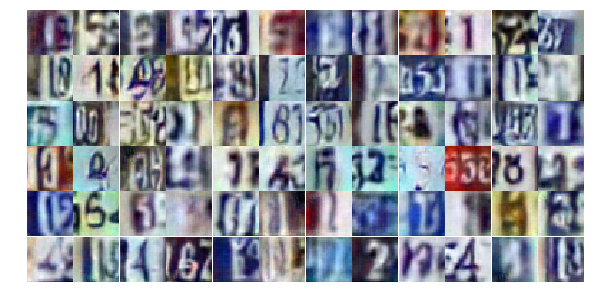

Epoch 23/25... Discriminator Loss: 1.2410... Generator Loss: 0.4834
Epoch 23/25... Discriminator Loss: 0.4166... Generator Loss: 1.5416
Epoch 23/25... Discriminator Loss: 1.5414... Generator Loss: 0.3536
Epoch 23/25... Discriminator Loss: 0.6883... Generator Loss: 0.9155
Epoch 23/25... Discriminator Loss: 0.7549... Generator Loss: 0.9953
Epoch 23/25... Discriminator Loss: 1.1098... Generator Loss: 2.1755
Epoch 23/25... Discriminator Loss: 0.2608... Generator Loss: 2.1450
Epoch 23/25... Discriminator Loss: 0.1994... Generator Loss: 2.6399
Epoch 23/25... Discriminator Loss: 0.8115... Generator Loss: 0.9392
Epoch 23/25... Discriminator Loss: 0.8443... Generator Loss: 1.2838


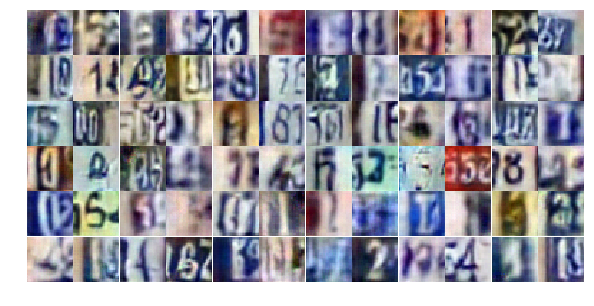

Epoch 23/25... Discriminator Loss: 0.3264... Generator Loss: 2.3112
Epoch 23/25... Discriminator Loss: 0.4735... Generator Loss: 1.6637
Epoch 23/25... Discriminator Loss: 0.0995... Generator Loss: 3.3369
Epoch 23/25... Discriminator Loss: 0.7585... Generator Loss: 0.9219
Epoch 23/25... Discriminator Loss: 0.6988... Generator Loss: 1.4654
Epoch 23/25... Discriminator Loss: 1.1100... Generator Loss: 0.6386
Epoch 23/25... Discriminator Loss: 0.6378... Generator Loss: 1.7136
Epoch 23/25... Discriminator Loss: 0.5286... Generator Loss: 1.4187
Epoch 23/25... Discriminator Loss: 0.2713... Generator Loss: 2.0904
Epoch 23/25... Discriminator Loss: 0.3751... Generator Loss: 1.5621


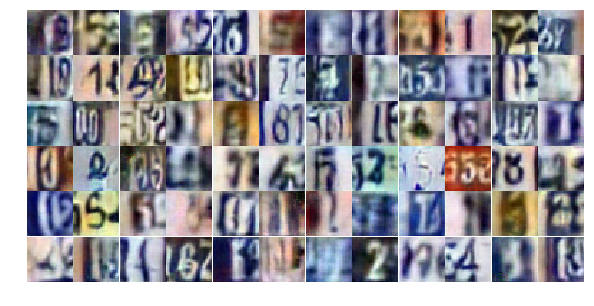

Epoch 23/25... Discriminator Loss: 0.5266... Generator Loss: 1.3640
Epoch 23/25... Discriminator Loss: 1.0319... Generator Loss: 2.2991
Epoch 23/25... Discriminator Loss: 1.3055... Generator Loss: 0.4978
Epoch 23/25... Discriminator Loss: 1.0162... Generator Loss: 0.6564
Epoch 23/25... Discriminator Loss: 0.6852... Generator Loss: 1.5626
Epoch 23/25... Discriminator Loss: 0.4766... Generator Loss: 1.4716
Epoch 23/25... Discriminator Loss: 0.5692... Generator Loss: 3.8032
Epoch 23/25... Discriminator Loss: 1.0075... Generator Loss: 2.0898
Epoch 23/25... Discriminator Loss: 0.1649... Generator Loss: 3.0065
Epoch 23/25... Discriminator Loss: 0.9936... Generator Loss: 0.7774


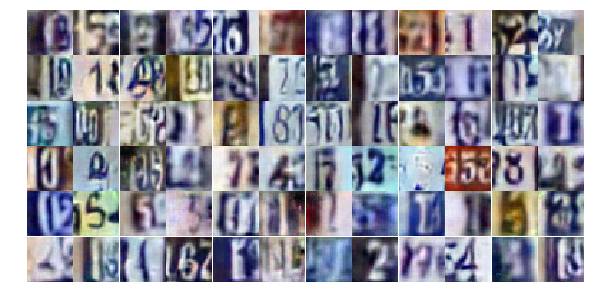

Epoch 23/25... Discriminator Loss: 0.9513... Generator Loss: 0.6589
Epoch 23/25... Discriminator Loss: 0.6133... Generator Loss: 1.0856
Epoch 23/25... Discriminator Loss: 0.3233... Generator Loss: 1.7789
Epoch 23/25... Discriminator Loss: 0.2965... Generator Loss: 2.0030
Epoch 23/25... Discriminator Loss: 1.5222... Generator Loss: 0.3683
Epoch 23/25... Discriminator Loss: 0.7916... Generator Loss: 2.0111
Epoch 23/25... Discriminator Loss: 1.6265... Generator Loss: 2.9970
Epoch 24/25... Discriminator Loss: 1.3515... Generator Loss: 0.5478
Epoch 24/25... Discriminator Loss: 0.5268... Generator Loss: 1.3423
Epoch 24/25... Discriminator Loss: 0.9223... Generator Loss: 0.7566


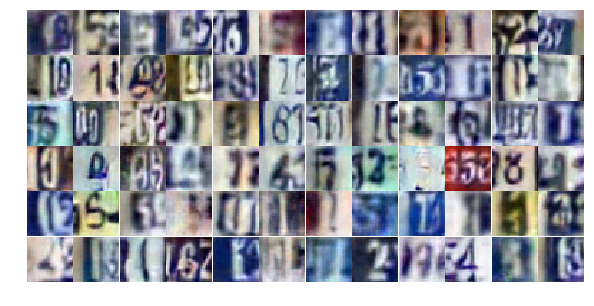

Epoch 24/25... Discriminator Loss: 0.1478... Generator Loss: 3.0287
Epoch 24/25... Discriminator Loss: 0.3249... Generator Loss: 1.8559
Epoch 24/25... Discriminator Loss: 0.5246... Generator Loss: 1.2771
Epoch 24/25... Discriminator Loss: 0.6381... Generator Loss: 1.1438
Epoch 24/25... Discriminator Loss: 0.1468... Generator Loss: 2.6043
Epoch 24/25... Discriminator Loss: 0.3321... Generator Loss: 1.8137
Epoch 24/25... Discriminator Loss: 0.7415... Generator Loss: 0.9082
Epoch 24/25... Discriminator Loss: 0.7977... Generator Loss: 0.8713
Epoch 24/25... Discriminator Loss: 0.0725... Generator Loss: 4.1682
Epoch 24/25... Discriminator Loss: 0.3294... Generator Loss: 2.1673


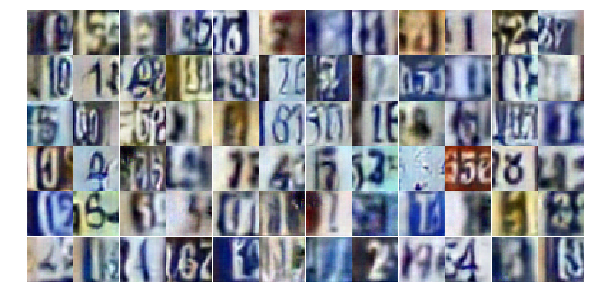

Epoch 24/25... Discriminator Loss: 0.5398... Generator Loss: 1.5682
Epoch 24/25... Discriminator Loss: 0.9460... Generator Loss: 0.7922
Epoch 24/25... Discriminator Loss: 0.8852... Generator Loss: 0.7295
Epoch 24/25... Discriminator Loss: 0.3280... Generator Loss: 1.6764
Epoch 24/25... Discriminator Loss: 0.2799... Generator Loss: 2.0601
Epoch 24/25... Discriminator Loss: 0.5002... Generator Loss: 4.2152
Epoch 24/25... Discriminator Loss: 0.6876... Generator Loss: 0.9628
Epoch 24/25... Discriminator Loss: 0.3427... Generator Loss: 3.0025
Epoch 24/25... Discriminator Loss: 0.4690... Generator Loss: 1.4804
Epoch 24/25... Discriminator Loss: 1.0269... Generator Loss: 0.6440


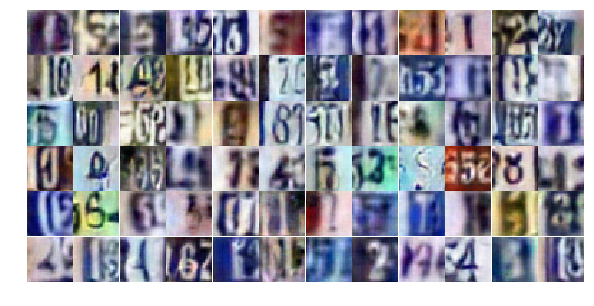

Epoch 24/25... Discriminator Loss: 1.1130... Generator Loss: 0.5763
Epoch 24/25... Discriminator Loss: 0.4580... Generator Loss: 1.4897
Epoch 24/25... Discriminator Loss: 0.5627... Generator Loss: 1.6481
Epoch 24/25... Discriminator Loss: 1.0658... Generator Loss: 0.7101
Epoch 24/25... Discriminator Loss: 0.3432... Generator Loss: 1.6106
Epoch 24/25... Discriminator Loss: 0.4973... Generator Loss: 1.4722
Epoch 24/25... Discriminator Loss: 0.2046... Generator Loss: 2.1695
Epoch 24/25... Discriminator Loss: 0.4672... Generator Loss: 1.4652
Epoch 24/25... Discriminator Loss: 0.4813... Generator Loss: 1.5606
Epoch 24/25... Discriminator Loss: 0.6892... Generator Loss: 1.0193


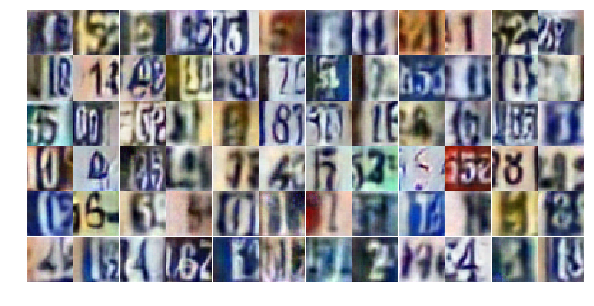

Epoch 24/25... Discriminator Loss: 0.4269... Generator Loss: 3.3523
Epoch 24/25... Discriminator Loss: 0.7575... Generator Loss: 2.4018
Epoch 24/25... Discriminator Loss: 0.8649... Generator Loss: 1.3081
Epoch 24/25... Discriminator Loss: 0.5715... Generator Loss: 1.2172
Epoch 24/25... Discriminator Loss: 0.5697... Generator Loss: 1.3927
Epoch 24/25... Discriminator Loss: 0.7057... Generator Loss: 0.9614
Epoch 24/25... Discriminator Loss: 1.3860... Generator Loss: 0.4343
Epoch 24/25... Discriminator Loss: 0.6169... Generator Loss: 1.0949
Epoch 24/25... Discriminator Loss: 0.5178... Generator Loss: 1.2524
Epoch 24/25... Discriminator Loss: 0.3411... Generator Loss: 2.0587


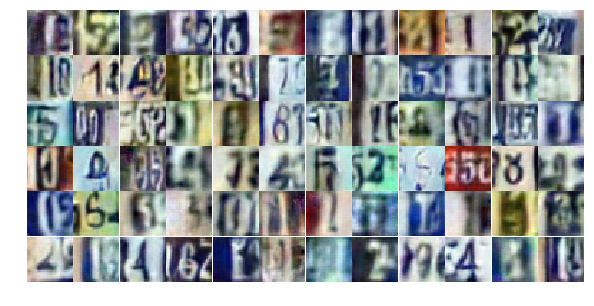

Epoch 24/25... Discriminator Loss: 0.3106... Generator Loss: 2.7909
Epoch 24/25... Discriminator Loss: 0.5002... Generator Loss: 1.3267
Epoch 24/25... Discriminator Loss: 0.4345... Generator Loss: 1.4754
Epoch 24/25... Discriminator Loss: 2.4139... Generator Loss: 0.1387
Epoch 24/25... Discriminator Loss: 0.5835... Generator Loss: 1.1195
Epoch 24/25... Discriminator Loss: 0.2094... Generator Loss: 3.8224
Epoch 24/25... Discriminator Loss: 0.5739... Generator Loss: 1.3114
Epoch 24/25... Discriminator Loss: 0.2993... Generator Loss: 1.9050
Epoch 24/25... Discriminator Loss: 0.5440... Generator Loss: 1.1700
Epoch 24/25... Discriminator Loss: 1.7926... Generator Loss: 0.2558


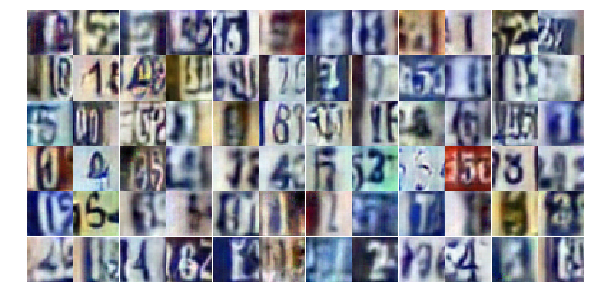

Epoch 24/25... Discriminator Loss: 0.9892... Generator Loss: 0.6602
Epoch 24/25... Discriminator Loss: 0.9743... Generator Loss: 0.8449
Epoch 24/25... Discriminator Loss: 0.7863... Generator Loss: 0.8477
Epoch 24/25... Discriminator Loss: 0.6016... Generator Loss: 1.4682
Epoch 24/25... Discriminator Loss: 1.1544... Generator Loss: 1.8626
Epoch 25/25... Discriminator Loss: 0.6032... Generator Loss: 1.3817
Epoch 25/25... Discriminator Loss: 0.3986... Generator Loss: 1.8126
Epoch 25/25... Discriminator Loss: 0.4552... Generator Loss: 1.3942
Epoch 25/25... Discriminator Loss: 0.4367... Generator Loss: 1.4311
Epoch 25/25... Discriminator Loss: 0.9518... Generator Loss: 0.6925


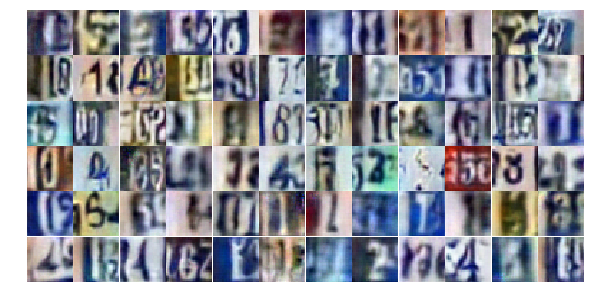

Epoch 25/25... Discriminator Loss: 0.1320... Generator Loss: 3.5275
Epoch 25/25... Discriminator Loss: 0.8431... Generator Loss: 1.2597
Epoch 25/25... Discriminator Loss: 0.6654... Generator Loss: 1.1043
Epoch 25/25... Discriminator Loss: 0.5618... Generator Loss: 1.3033
Epoch 25/25... Discriminator Loss: 1.1682... Generator Loss: 0.5139
Epoch 25/25... Discriminator Loss: 0.5505... Generator Loss: 1.2726
Epoch 25/25... Discriminator Loss: 1.3388... Generator Loss: 0.4585
Epoch 25/25... Discriminator Loss: 0.7725... Generator Loss: 0.9408
Epoch 25/25... Discriminator Loss: 0.2000... Generator Loss: 2.4849
Epoch 25/25... Discriminator Loss: 0.4753... Generator Loss: 1.4733


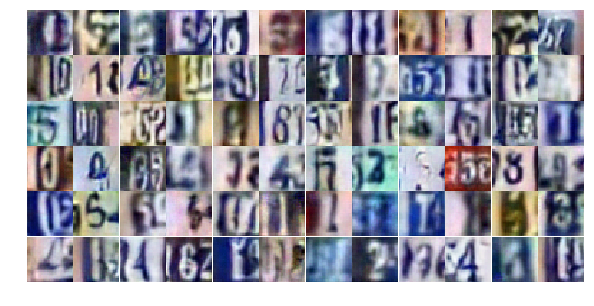

Epoch 25/25... Discriminator Loss: 0.0902... Generator Loss: 3.7673
Epoch 25/25... Discriminator Loss: 0.4145... Generator Loss: 1.5723
Epoch 25/25... Discriminator Loss: 0.9867... Generator Loss: 0.6409
Epoch 25/25... Discriminator Loss: 0.9408... Generator Loss: 0.9156
Epoch 25/25... Discriminator Loss: 0.4395... Generator Loss: 1.4818
Epoch 25/25... Discriminator Loss: 0.5738... Generator Loss: 1.2101
Epoch 25/25... Discriminator Loss: 0.3927... Generator Loss: 1.4787
Epoch 25/25... Discriminator Loss: 0.6800... Generator Loss: 1.0772
Epoch 25/25... Discriminator Loss: 0.6970... Generator Loss: 0.9552
Epoch 25/25... Discriminator Loss: 0.4217... Generator Loss: 1.6194


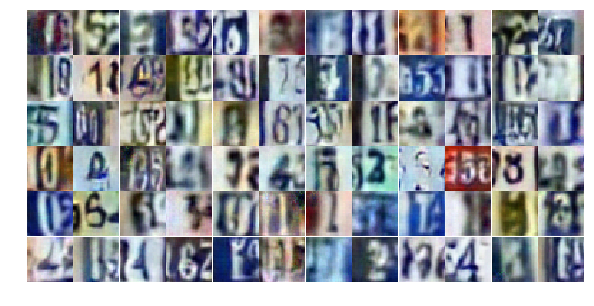

Epoch 25/25... Discriminator Loss: 0.7766... Generator Loss: 0.9461
Epoch 25/25... Discriminator Loss: 0.2654... Generator Loss: 2.0294
Epoch 25/25... Discriminator Loss: 2.1109... Generator Loss: 0.2511
Epoch 25/25... Discriminator Loss: 1.8024... Generator Loss: 0.7108
Epoch 25/25... Discriminator Loss: 1.1552... Generator Loss: 1.5589
Epoch 25/25... Discriminator Loss: 0.6259... Generator Loss: 2.1324
Epoch 25/25... Discriminator Loss: 1.1312... Generator Loss: 0.5990
Epoch 25/25... Discriminator Loss: 0.5501... Generator Loss: 1.5992
Epoch 25/25... Discriminator Loss: 0.7010... Generator Loss: 0.8704
Epoch 25/25... Discriminator Loss: 0.4722... Generator Loss: 1.4507


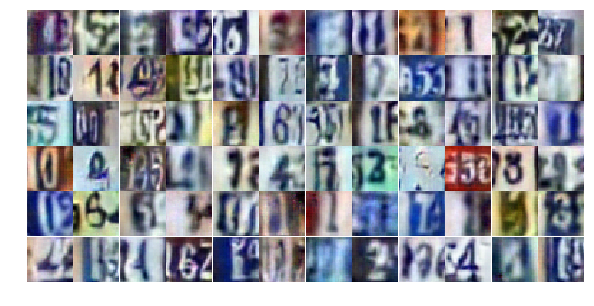

Epoch 25/25... Discriminator Loss: 0.2727... Generator Loss: 1.8811
Epoch 25/25... Discriminator Loss: 0.4198... Generator Loss: 1.3882
Epoch 25/25... Discriminator Loss: 0.5225... Generator Loss: 2.0177
Epoch 25/25... Discriminator Loss: 0.2635... Generator Loss: 2.1489
Epoch 25/25... Discriminator Loss: 0.1745... Generator Loss: 2.5845
Epoch 25/25... Discriminator Loss: 1.8677... Generator Loss: 0.3333
Epoch 25/25... Discriminator Loss: 1.0706... Generator Loss: 0.7525
Epoch 25/25... Discriminator Loss: 1.2471... Generator Loss: 1.8129
Epoch 25/25... Discriminator Loss: 1.5763... Generator Loss: 0.8029
Epoch 25/25... Discriminator Loss: 1.0578... Generator Loss: 0.8330


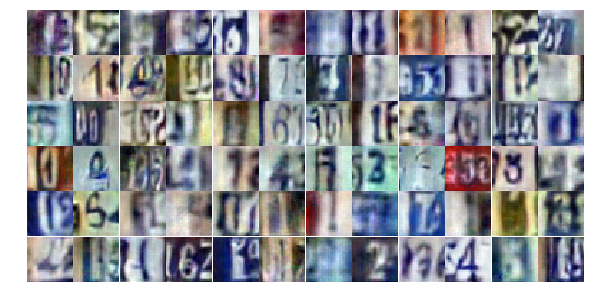

Epoch 25/25... Discriminator Loss: 1.3570... Generator Loss: 0.7779
Epoch 25/25... Discriminator Loss: 1.1502... Generator Loss: 1.4373
Epoch 25/25... Discriminator Loss: 1.3360... Generator Loss: 0.9398
Epoch 25/25... Discriminator Loss: 1.1085... Generator Loss: 1.0814
Epoch 25/25... Discriminator Loss: 1.6198... Generator Loss: 0.4147
Epoch 25/25... Discriminator Loss: 0.5850... Generator Loss: 1.6956
Epoch 25/25... Discriminator Loss: 1.1126... Generator Loss: 0.6677
Epoch 25/25... Discriminator Loss: 0.7834... Generator Loss: 0.9304
Epoch 25/25... Discriminator Loss: 0.8077... Generator Loss: 0.8434
Epoch 25/25... Discriminator Loss: 1.0366... Generator Loss: 0.8486


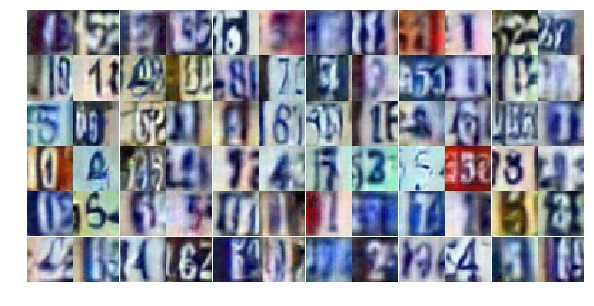

Epoch 25/25... Discriminator Loss: 0.6244... Generator Loss: 1.1449
Epoch 25/25... Discriminator Loss: 1.9439... Generator Loss: 0.2128


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

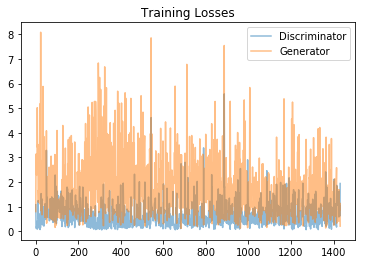

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

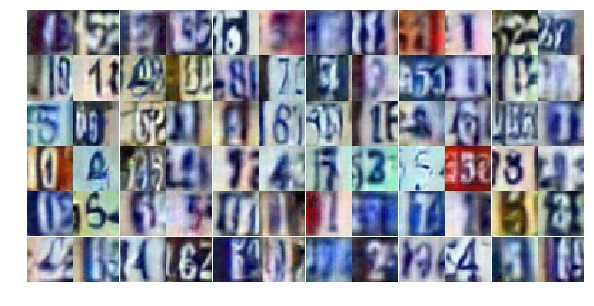

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))